# Introduction

We will be exploring the power of LSTMs in forecasting Time series data on a Uganda Dataset of Temperatures using PyTorch

# Import the Libraries

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import torch
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.utils.data import TensorDataset, DataLoader
from torch.optim import Adam
from torch import nn
from sklearn.linear_model import Ridge, LinearRegression
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from sklearn.svm import LinearSVR
from sklearn.metrics import mean_squared_error

In [2]:
data = pd.read_excel("/kaggle/input/climate-data-for-the-max-temperatures/data.xlsx")
data.head()

,YEAR,MONTH,Kitgum,Kasese,Gulu,Arua,Masindi,Soroti,Tororo,Jinja,Mbarara,Entebbe,Kabale,Kampala,Kotido,Mubende,Kibanda,Buginyanya,Kyembogo,Wadelai
0,2012,1,34.233,31.633,33.200,31.933,32.733,33.267,32.867,31.333,29.300,28.067,26.167,30.333,33.967,28.533,31.133,32.567,27.167,35.233
1,2012,2,35.300,32.933,34.567,32.967,33.700,34.000,33.867,31.367,29.267,26.633,26.233,30.133,34.000,31.000,30.033,32.333,30.100,36.800
2,2012,3,34.833,32.833,34.500,32.800,33.833,34.100,33.267,29.467,29.100,25.367,26.000,28.833,33.233,30.067,29.333,31.500,30.400,36.400
3,2012,4,30.333,29.800,30.433,29.233,29.500,29.467,29.233,27.267,26.800,24.600,23.333,27.300,29.667,25.933,27.800,27.167,25.800,32.167
4,2012,5,28.900,28.867,29.067,28.133,29.300,28.800,28.800,27.533,26.367,24.233,22.767,27.200,27.933,25.833,27.267,25.933,25.967,31.767


In [3]:
data['date'] = data['YEAR'].astype("str") + '-' + data['MONTH'].astype("str")
data.head()

,YEAR,MONTH,Kitgum,Kasese,Gulu,Arua,Masindi,Soroti,Tororo,Jinja,...,Entebbe,Kabale,Kampala,Kotido,Mubende,Kibanda,Buginyanya,Kyembogo,Wadelai,date
0,2012,1,34.233,31.633,33.200,31.933,32.733,33.267,32.867,31.333,...,28.067,26.167,30.333,33.967,28.533,31.133,32.567,27.167,35.233,2012-1
1,2012,2,35.300,32.933,34.567,32.967,33.700,34.000,33.867,31.367,...,26.633,26.233,30.133,34.000,31.000,30.033,32.333,30.100,36.800,2012-2
2,2012,3,34.833,32.833,34.500,32.800,33.833,34.100,33.267,29.467,...,25.367,26.000,28.833,33.233,30.067,29.333,31.500,30.400,36.400,2012-3
3,2012,4,30.333,29.800,30.433,29.233,29.500,29.467,29.233,27.267,...,24.600,23.333,27.300,29.667,25.933,27.800,27.167,25.800,32.167,2012-4
4,2012,5,28.900,28.867,29.067,28.133,29.300,28.800,28.800,27.533,...,24.233,22.767,27.200,27.933,25.833,27.267,25.933,25.967,31.767,2012-5


In [4]:
data['date'] = pd.to_datetime(data['date'])
data.head()

,YEAR,MONTH,Kitgum,Kasese,Gulu,Arua,Masindi,Soroti,Tororo,Jinja,...,Entebbe,Kabale,Kampala,Kotido,Mubende,Kibanda,Buginyanya,Kyembogo,Wadelai,date
0,2012,1,34.233,31.633,33.200,31.933,32.733,33.267,32.867,31.333,...,28.067,26.167,30.333,33.967,28.533,31.133,32.567,27.167,35.233,2012-01-01
1,2012,2,35.300,32.933,34.567,32.967,33.700,34.000,33.867,31.367,...,26.633,26.233,30.133,34.000,31.000,30.033,32.333,30.100,36.800,2012-02-01
2,2012,3,34.833,32.833,34.500,32.800,33.833,34.100,33.267,29.467,...,25.367,26.000,28.833,33.233,30.067,29.333,31.500,30.400,36.400,2012-03-01
3,2012,4,30.333,29.800,30.433,29.233,29.500,29.467,29.233,27.267,...,24.600,23.333,27.300,29.667,25.933,27.800,27.167,25.800,32.167,2012-04-01
4,2012,5,28.900,28.867,29.067,28.133,29.300,28.800,28.800,27.533,...,24.233,22.767,27.200,27.933,25.833,27.267,25.933,25.967,31.767,2012-05-01


In [5]:
new_df = data.set_index('date')
new_df

,YEAR,MONTH,Kitgum,Kasese,Gulu,Arua,Masindi,Soroti,Tororo,Jinja,Mbarara,Entebbe,Kabale,Kampala,Kotido,Mubende,Kibanda,Buginyanya,Kyembogo,Wadelai
date,,,,,,,,,,,,,,,,,,,,
2012-01-01,2012,1,34.233,31.633,33.200,31.933,32.733,33.267,32.867,31.333,29.300,28.067,26.167,30.333,33.967,28.533,31.133,32.567,27.167,35.233
2012-02-01,2012,2,35.300,32.933,34.567,32.967,33.700,34.000,33.867,31.367,29.267,26.633,26.233,30.133,34.000,31.000,30.033,32.333,30.100,36.800
2012-03-01,2012,3,34.833,32.833,34.500,32.800,33.833,34.100,33.267,29.467,29.100,25.367,26.000,28.833,33.233,30.067,29.333,31.500,30.400,36.400
2012-04-01,2012,4,30.333,29.800,30.433,29.233,29.500,29.467,29.233,27.267,26.800,24.600,23.333,27.300,29.667,25.933,27.800,27.167,25.800,32.167
2012-05-01,2012,5,28.900,28.867,29.067,28.133,29.300,28.800,28.800,27.533,26.367,24.233,22.767,27.200,27.933,25.833,27.267,25.933,25.967,31.767
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-02-01,2018,2,34.800,33.300,34.500,31.933,33.367,34.567,34.567,31.267,29.433,27.100,25.433,30.767,33.500,30.100,29.867,32.133,29.867,35.967
2018-03-01,2018,3,30.300,29.567,29.767,28.500,29.000,29.300,29.300,26.900,26.967,24.667,24.133,27.333,29.300,25.267,26.967,27.167,25.233,32.100
2018-04-01,2018,4,28.700,28.933,28.900,27.433,28.100,28.433,28.433,26.267,26.433,24.600,23.467,26.600,27.567,25.167,26.867,26.167,25.033,30.000


In [6]:
def plot_series_data(series_df : pd.DataFrame, district_name : str):
    plt.plot(series_df , marker='o' )

    plt.title(f'{district_name} Temperature Over Time')
    plt.xlabel('Date')
    plt.ylabel('Temperature')
    plt.grid(True)

    # Displaying the dates on the x-axis
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Baseline Models

In [7]:
def create_dataset(data : pd.DataFrame, district : str):
    df = data.copy()
    
    for i in range(lookback):
        df[f'temp_shift_{i}'] = df[district].shift(i)
    
    df.dropna(inplace=True)
    
    return df

In [8]:
districts = ["Kampala", "Gulu", "Soroti", "Arua", "Kasese", "Kabale", "Entebbe", "Kotido", "Mubende", "Jinja"]

In [9]:
lookback = 7

In [10]:
models = {
    "lr" : LinearRegression(),
    "ridge" : Ridge(),
    "forest": RandomForestRegressor(random_state=42),
    "xtree": ExtraTreesRegressor(random_state=42),
    "svm": LinearSVR(random_state=42)
}

def train_ML_models(models, lookback = 7):
    scores = {}
    
    for name, model in models.items():
        for district in districts:
            series_df = new_df[[district]].astype('float32').copy()
            Xtrain = series_df[:60]
            Xtest = series_df[60:]
            Train_df = create_dataset(Xtrain, district)
            Test_df = create_dataset(Xtest, district)

            scaler = StandardScaler().fit(Train_df.to_numpy())

            Train_scaled = scaler.transform(Train_df.to_numpy())
            Test_scaled = scaler.transform(Test_df.to_numpy())

            Xtrain = Train_scaled[:, 1:]
            ytrain = Train_scaled[:, 0]

            Xtest = Test_scaled[:, 1:]
            ytest = Test_scaled[:, 0]

            model.fit(Xtrain, ytrain)

            predictions = model.predict(Xtest)

            mse = mean_squared_error(ytest, predictions)

            plt.title(f"{name} Predictions and Actual for Model on District {district}")
            plt.plot(ytest, label='Actual pred')
            plt.plot(predictions, label = "Predicted")
            plt.legend()
            plt.show()

            if name not in scores:
                scores[name] = []

            scores[name].append((district, mse))
        
    return scores


## Lookback 3

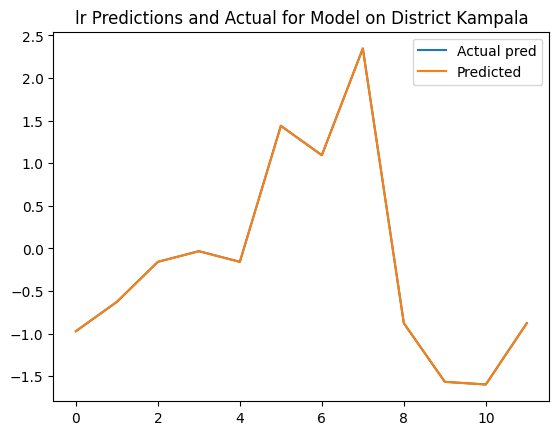

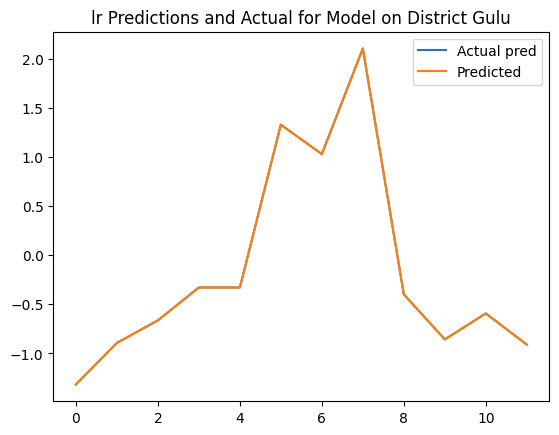

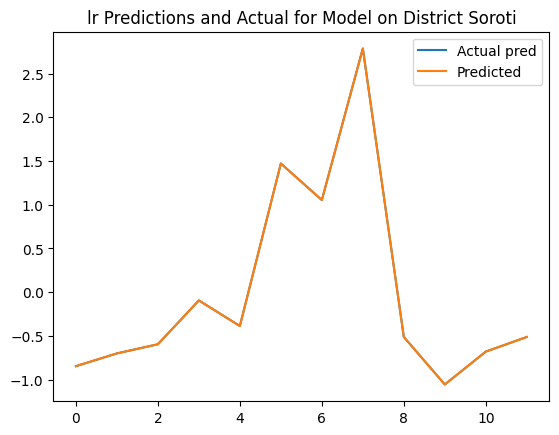

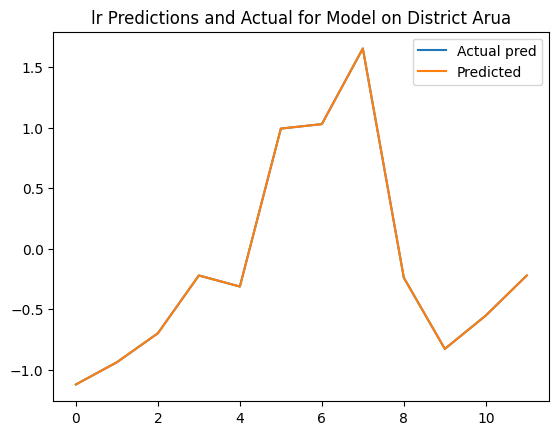

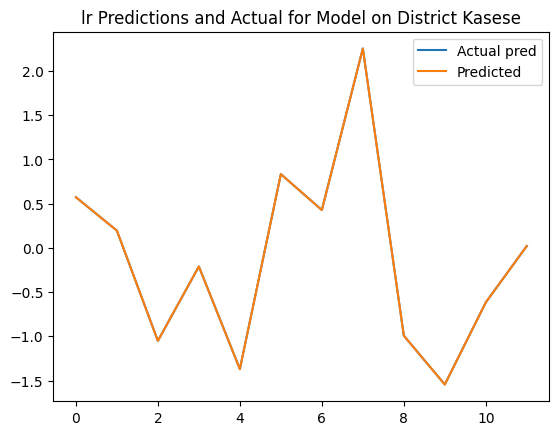

...

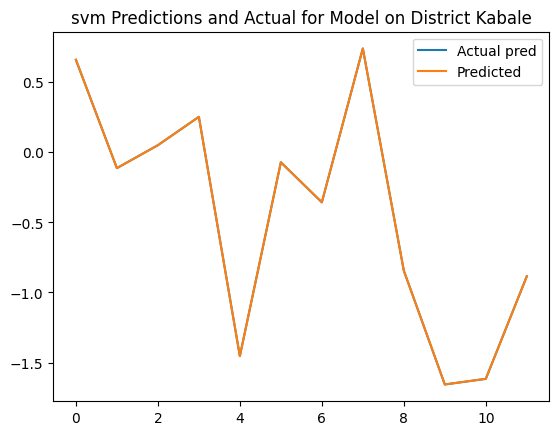

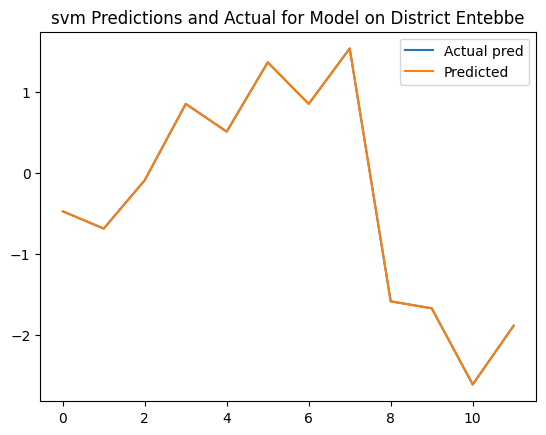

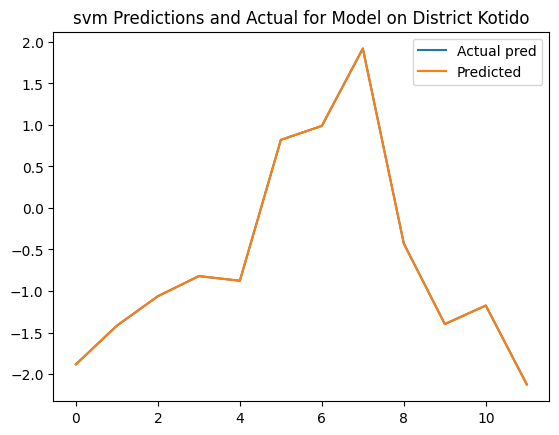

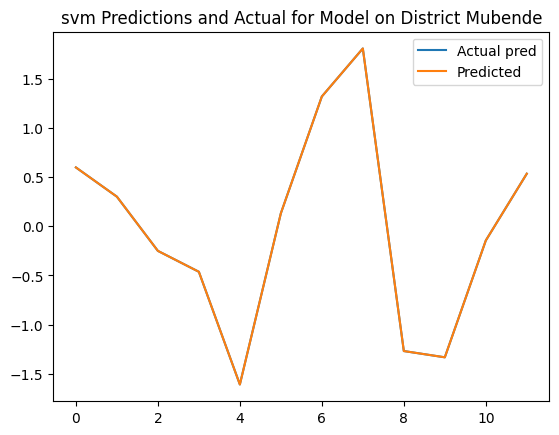

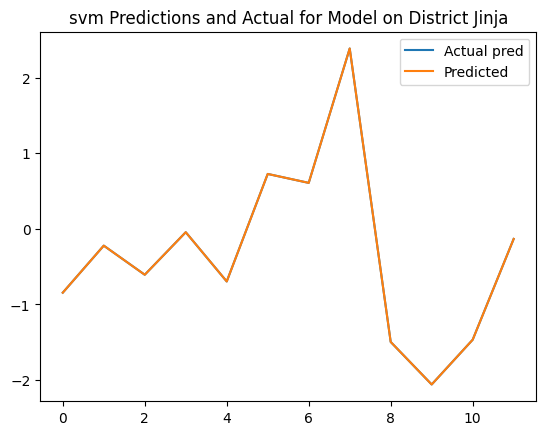

{'lr': [('Kampala', 3.8276094e-14),
  ('Gulu', 4.8479738e-14),
  ('Soroti', 1.2057022e-13),
  ('Arua', 5.345724e-14),
  ('Kasese', 4.9016347e-14),
  ('Kabale', 3.0546166e-14),
  ('Entebbe', 1.4418096e-13),
  ('Kotido', 1.7082631e-13),
  ('Mubende', 1.9147646e-13),
  ('Jinja', 3.3283098e-13)],
 'ridge': [('Kampala', 0.0008717885),
  ('Gulu', 0.0019656036),
  ('Soroti', 0.0015327311),
  ('Arua', 0.0013598586),
  ('Kasese', 0.0012242078),
  ('Kabale', 0.0009420715),
  ('Entebbe', 0.0007598411),
  ('Kotido', 0.0011374139),
  ('Mubende', 0.0008826848),
  ('Jinja', 0.0013646901)],
 'forest': [('Kampala', 0.037276084160223315),
  ('Gulu', 0.006723751698401102),
  ('Soroti', 0.037740084617829676),
  ('Arua', 0.002058488133831695),
  ('Kasese', 0.015926255009646523),
  ('Kabale', 0.009170741631671387),
  ('Entebbe', 0.14450748745837017),
  ('Kotido', 0.025653672721092858),
  ('Mubende', 0.010136565255525224),
  ('Jinja', 0.0998218764630011)],
 'xtree': [('Kampala', 0.025464226584167183),
  ('Gu

In [11]:
train_ML_models(models, 3)

## Lookback 4

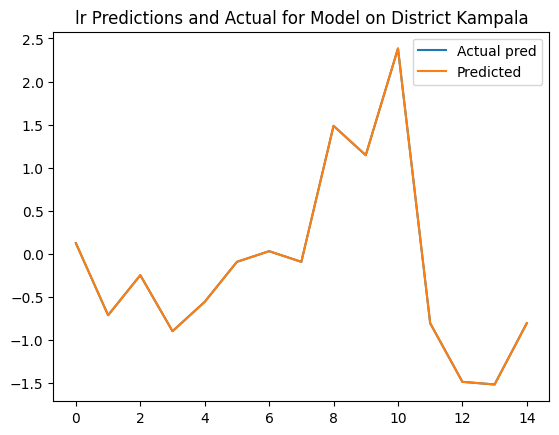

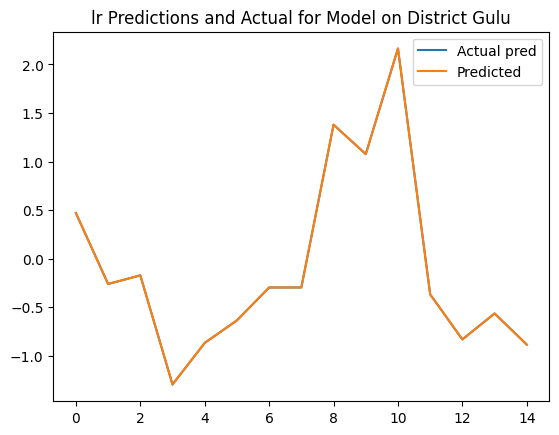

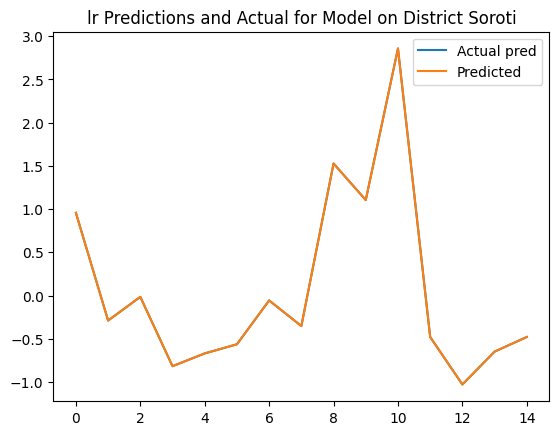

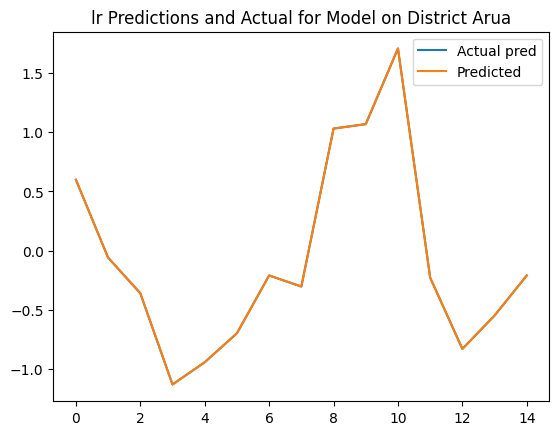

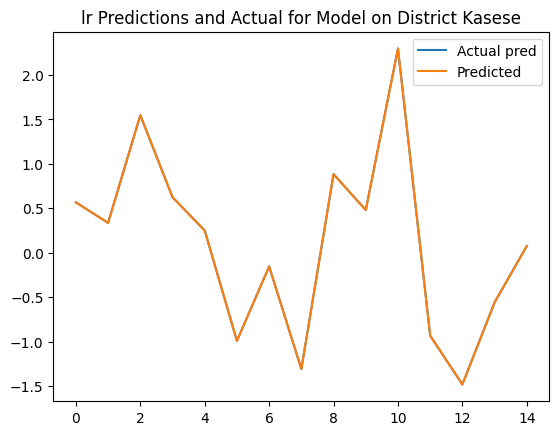

...

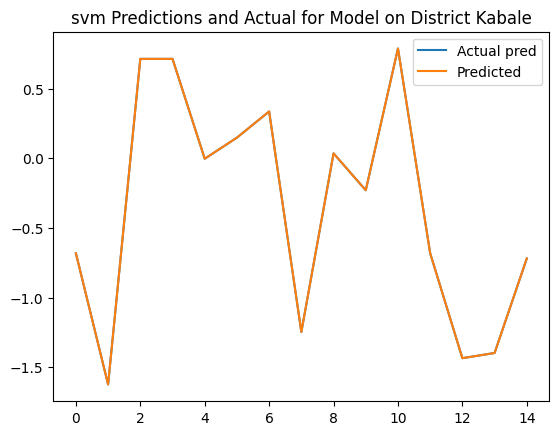

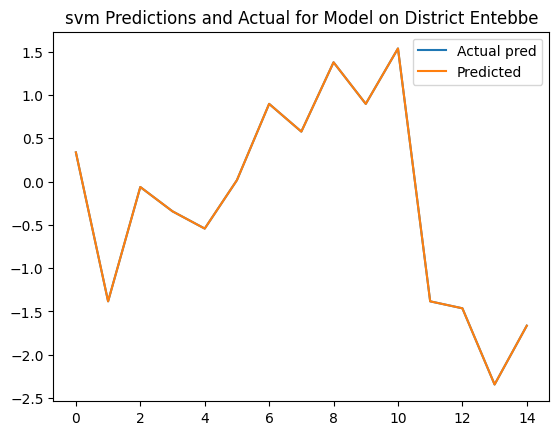

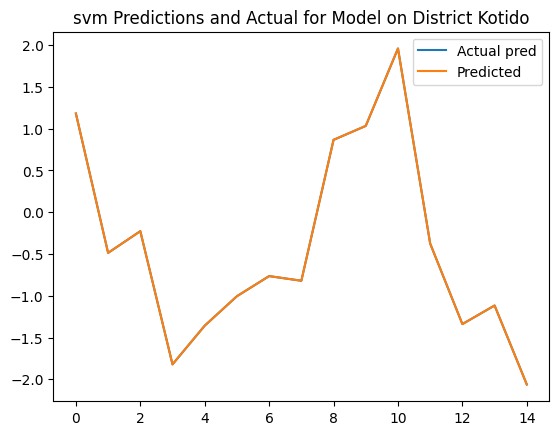

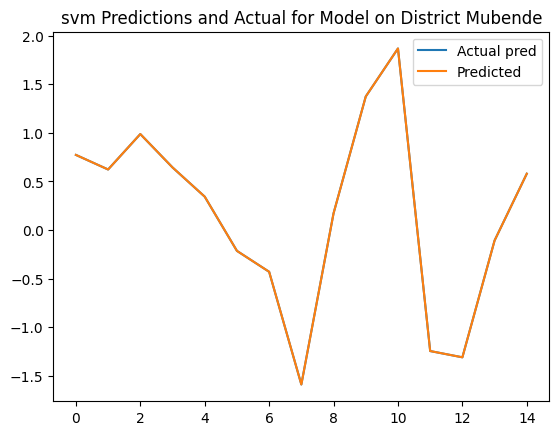

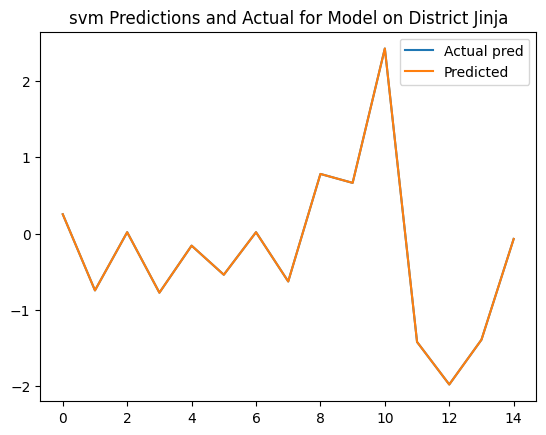

{'lr': [('Kampala', 6.48058e-14),
  ('Gulu', 1.0914232e-13),
  ('Soroti', 1.6818087e-14),
  ('Arua', 2.4635848e-14),
  ('Kasese', 1.5424699e-14),
  ('Kabale', 9.571824e-14),
  ('Entebbe', 9.432478e-14),
  ('Kotido', 3.921308e-14),
  ('Mubende', 7.2242214e-14),
  ('Jinja', 9.059651e-14)],
 'ridge': [('Kampala', 0.00070059474),
  ('Gulu', 0.001049957),
  ('Soroti', 0.00096011214),
  ('Arua', 0.00069977803),
  ('Kasese', 0.00078300876),
  ('Kabale', 0.0005992753),
  ('Entebbe', 0.00059285143),
  ('Kotido', 0.00086051476),
  ('Mubende', 0.00063965906),
  ('Jinja', 0.0010866566)],
 'forest': [('Kampala', 0.00597058599903751),
  ('Gulu', 0.006578902968934282),
  ('Soroti', 0.02495889090367401),
  ('Arua', 0.00386346460702771),
  ('Kasese', 0.003175127555395987),
  ('Kabale', 0.004665944155438486),
  ('Entebbe', 0.026352021578413466),
  ('Kotido', 0.020670027055920238),
  ('Mubende', 0.003867410234304277),
  ('Jinja', 0.04896061904061762)],
 'xtree': [('Kampala', 0.0019367501094851437),
  ('G

In [12]:
lookback = 4
train_ML_models(models, 4)

## Lookback 5

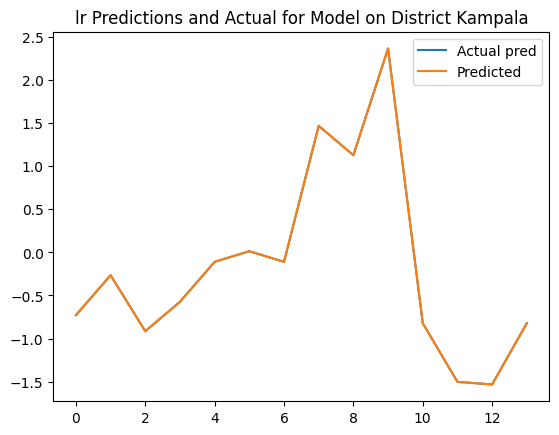

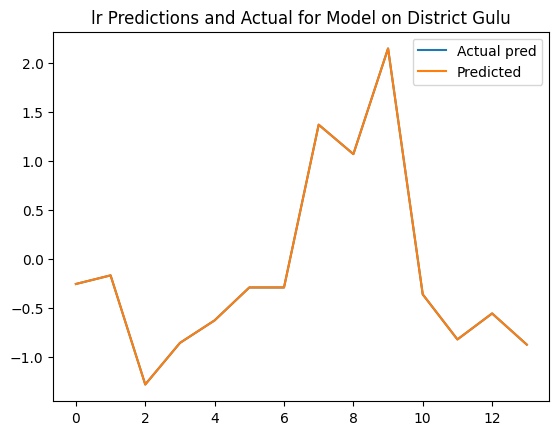

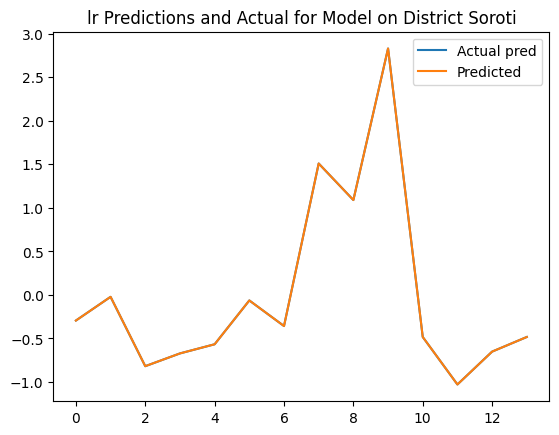

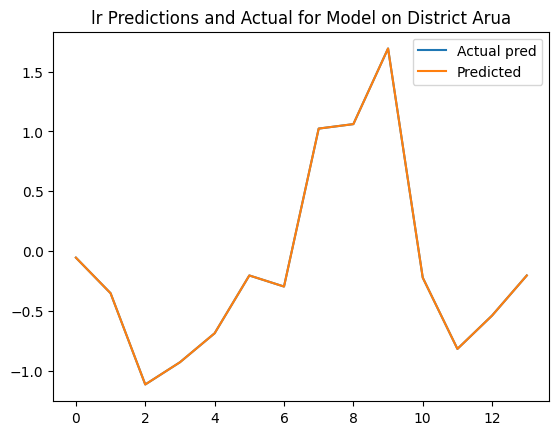

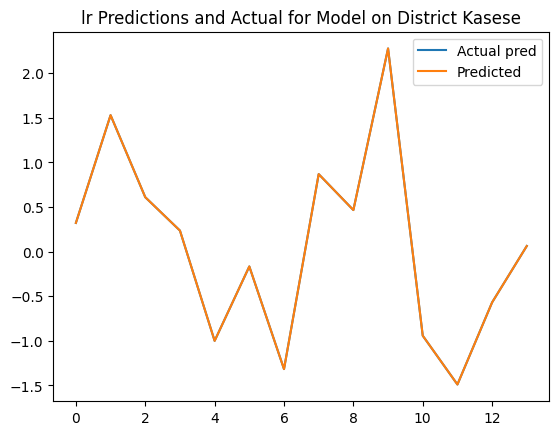

...

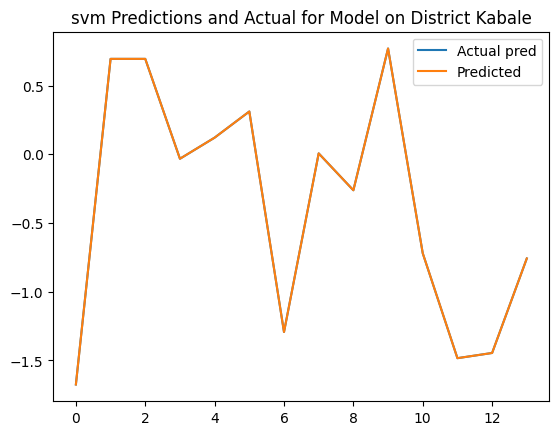

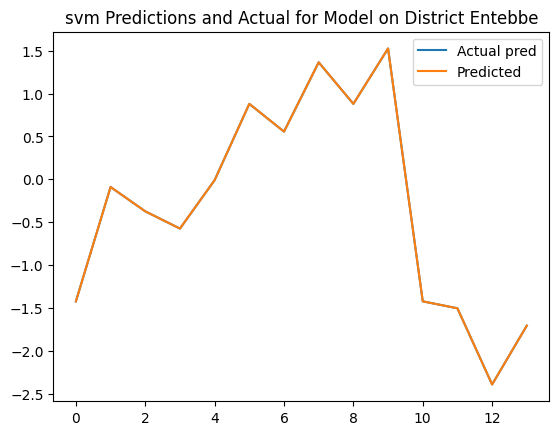

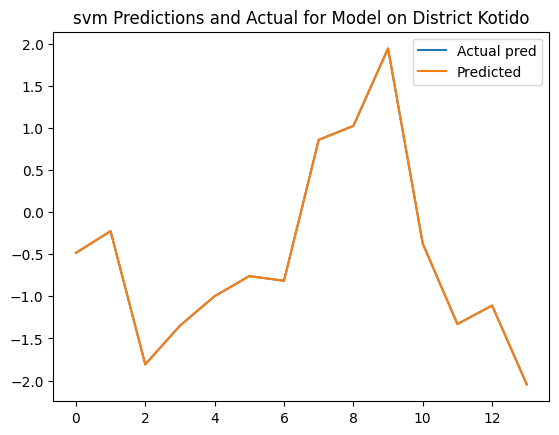

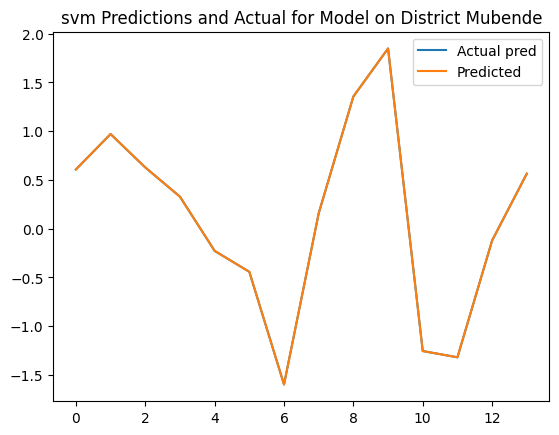

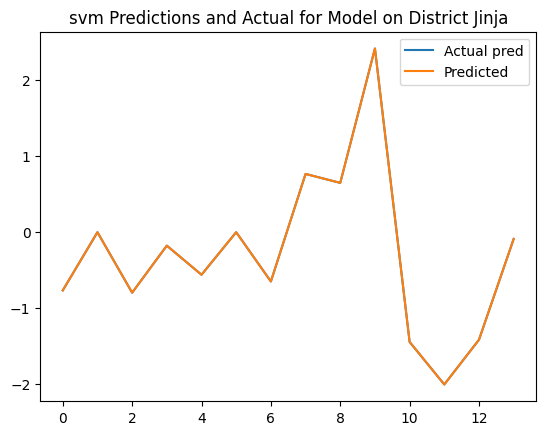

{'lr': [('Kampala', 1.1286855e-14),
  ('Gulu', 5.2719734e-14),
  ('Soroti', 1.1110656e-13),
  ('Arua', 5.510275e-14),
  ('Kasese', 1.1533632e-13),
  ('Kabale', 1.0684882e-13),
  ('Entebbe', 1.2035215e-13),
  ('Kotido', 7.4860755e-15),
  ('Mubende', 1.8428512e-13),
  ('Jinja', 2.4937016e-13)],
 'ridge': [('Kampala', 0.00075755443),
  ('Gulu', 0.001585428),
  ('Soroti', 0.0012397472),
  ('Arua', 0.0012034901),
  ('Kasese', 0.0009081874),
  ('Kabale', 0.0008183154),
  ('Entebbe', 0.0007157293),
  ('Kotido', 0.0009269518),
  ('Mubende', 0.0006738209),
  ('Jinja', 0.0011497458)],
 'forest': [('Kampala', 0.012362087575129943),
  ('Gulu', 0.003371112865808212),
  ('Soroti', 0.03248208738037569),
  ('Arua', 0.0019601367142078286),
  ('Kasese', 0.014869004015268365),
  ('Kabale', 0.003067068640443502),
  ('Entebbe', 0.039497174402662795),
  ('Kotido', 0.01270387124087241),
  ('Mubende', 0.006881412157786864),
  ('Jinja', 0.04978810813241051)],
 'xtree': [('Kampala', 0.0009367137169291548),
  ('

In [13]:
lookback = 5
train_ML_models(models, 5)

## Lookback 6

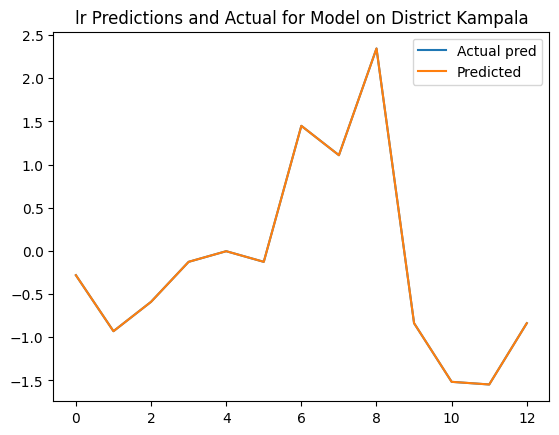

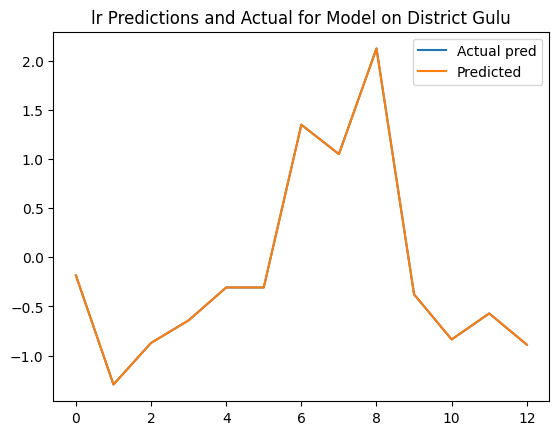

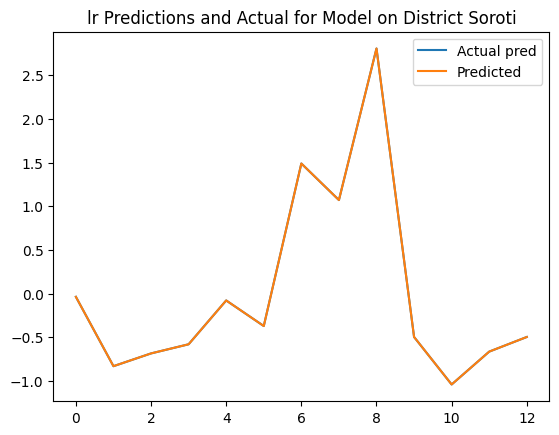

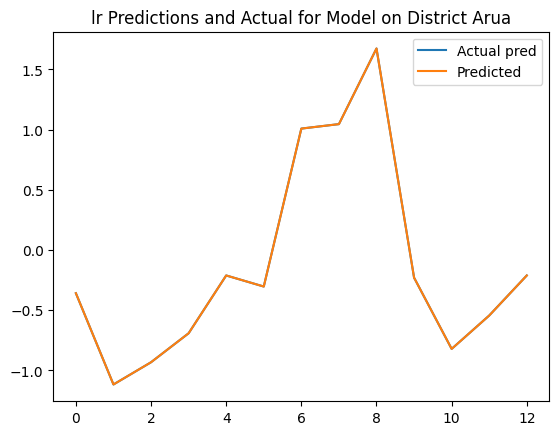

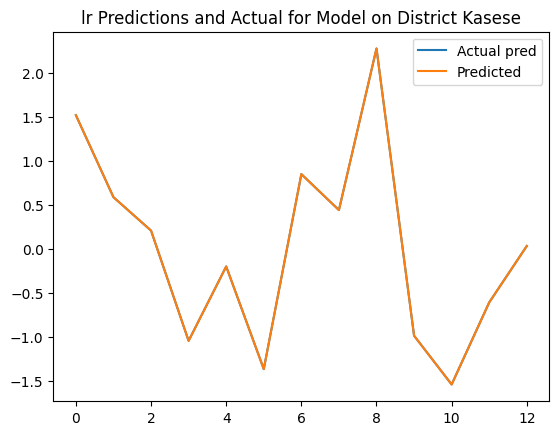

...

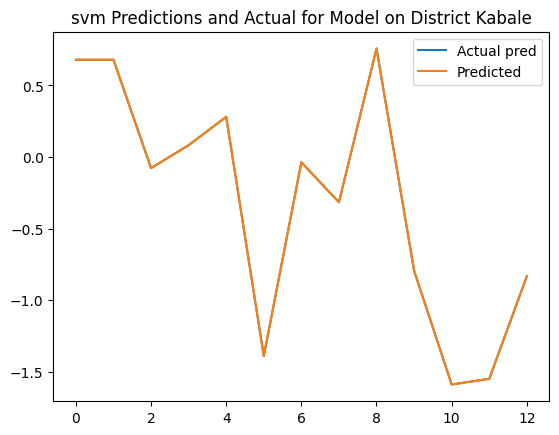

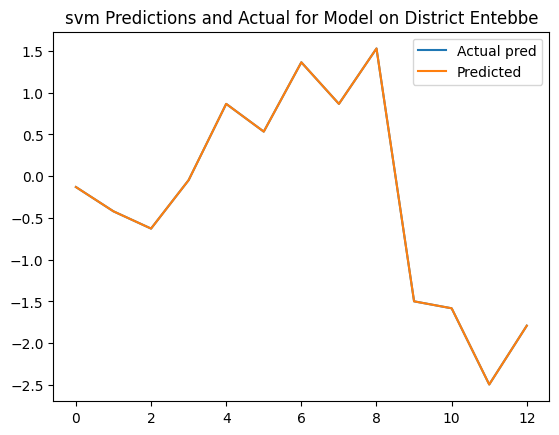

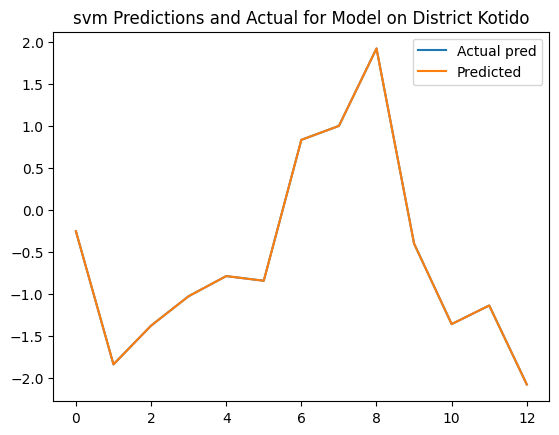

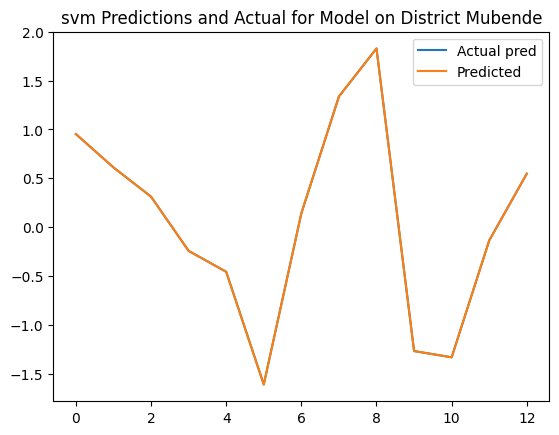

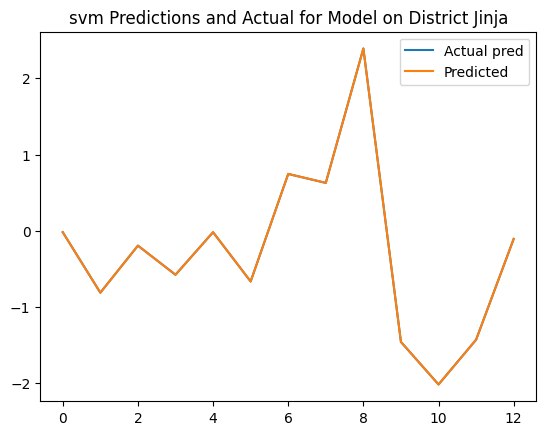

{'lr': [('Kampala', 1.7333996e-14),
  ('Gulu', 4.230804e-14),
  ('Soroti', 1.0226542e-13),
  ('Arua', 2.360505e-14),
  ('Kasese', 1.6050515e-13),
  ('Kabale', 1.544918e-14),
  ('Entebbe', 9.173965e-14),
  ('Kotido', 1.0195263e-13),
  ('Mubende', 4.1385698e-14),
  ('Jinja', 7.902493e-14)],
 'ridge': [('Kampala', 0.00081820175),
  ('Gulu', 0.0016346482),
  ('Soroti', 0.0013866095),
  ('Arua', 0.0012062589),
  ('Kasese', 0.0012300594),
  ('Kabale', 0.0008757127),
  ('Entebbe', 0.0006887063),
  ('Kotido', 0.00096599443),
  ('Mubende', 0.0008208965),
  ('Jinja', 0.0012183451)],
 'forest': [('Kampala', 0.015450112498864015),
  ('Gulu', 0.004733128227187504),
  ('Soroti', 0.035577947348267025),
  ('Arua', 0.003379165482554572),
  ('Kasese', 0.01228443658548311),
  ('Kabale', 0.004987432344605677),
  ('Entebbe', 0.07767001696025393),
  ('Kotido', 0.024645768250299696),
  ('Mubende', 0.011499114748185426),
  ('Jinja', 0.07347370812973895)],
 'xtree': [('Kampala', 0.0015462256434117178),
  ('Gul

In [14]:
lookback = 6
train_ML_models(models, 6)

## Lookback 7

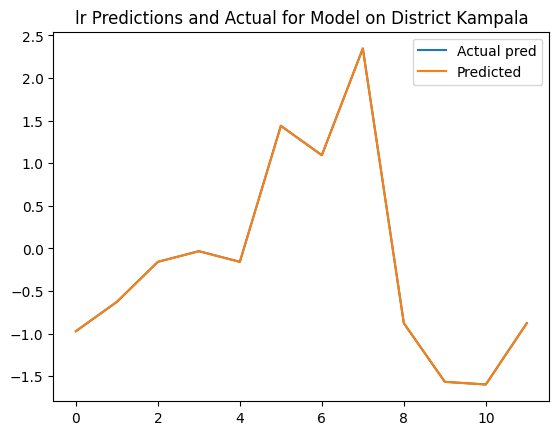

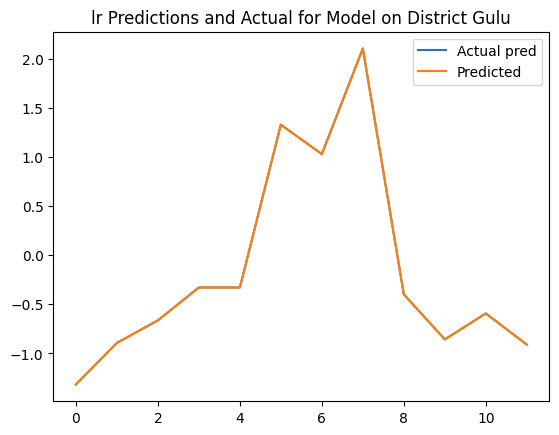

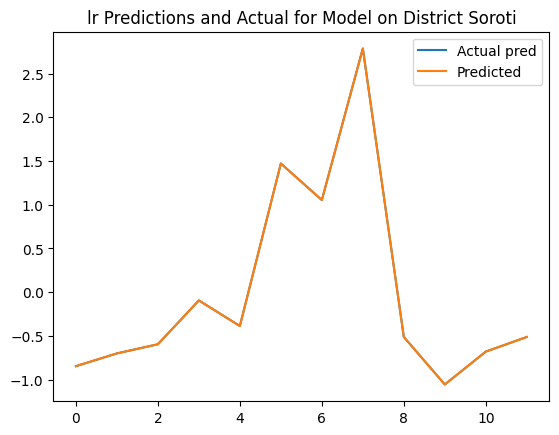

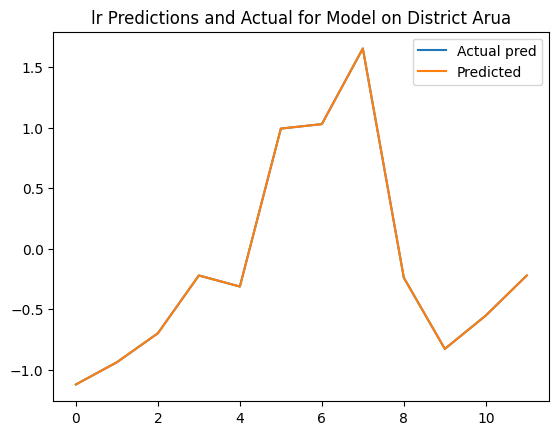

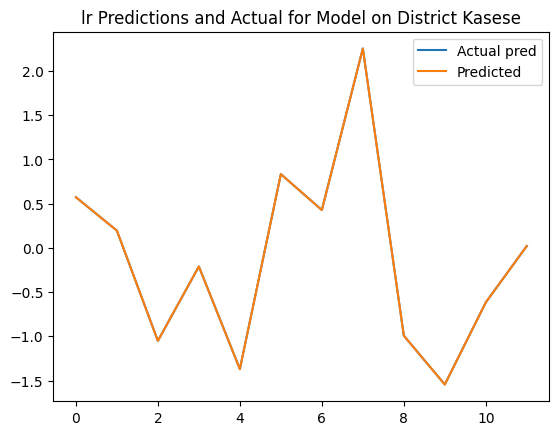

...

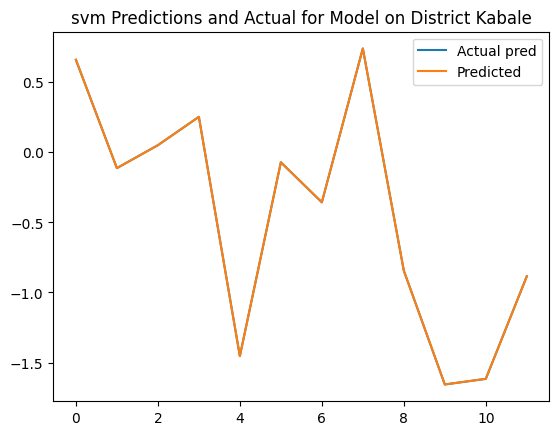

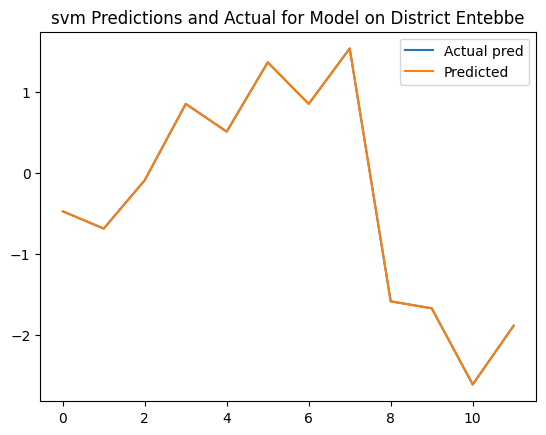

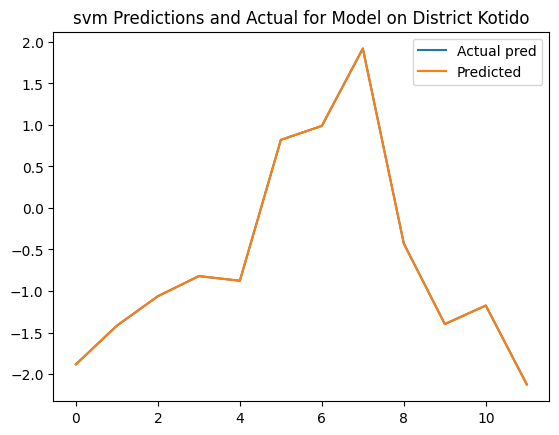

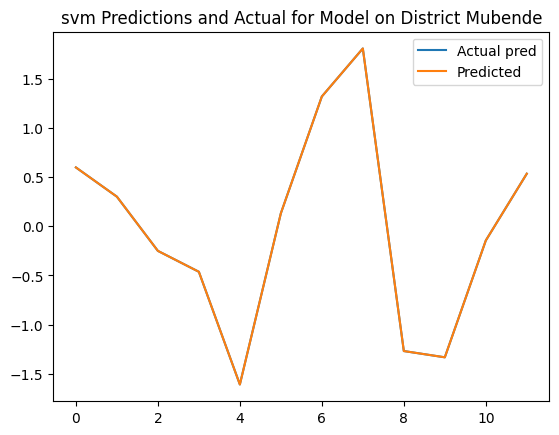

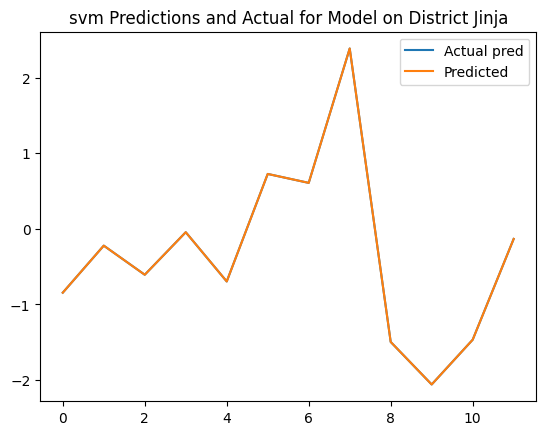

{'lr': [('Kampala', 3.8276094e-14),
  ('Gulu', 4.8479738e-14),
  ('Soroti', 1.2057022e-13),
  ('Arua', 5.345724e-14),
  ('Kasese', 4.9016347e-14),
  ('Kabale', 3.0546166e-14),
  ('Entebbe', 1.4418096e-13),
  ('Kotido', 1.7082631e-13),
  ('Mubende', 1.9147646e-13),
  ('Jinja', 3.3283098e-13)],
 'ridge': [('Kampala', 0.0008717885),
  ('Gulu', 0.0019656036),
  ('Soroti', 0.0015327311),
  ('Arua', 0.0013598586),
  ('Kasese', 0.0012242078),
  ('Kabale', 0.0009420715),
  ('Entebbe', 0.0007598411),
  ('Kotido', 0.0011374139),
  ('Mubende', 0.0008826848),
  ('Jinja', 0.0013646901)],
 'forest': [('Kampala', 0.037276084160223315),
  ('Gulu', 0.006723751698401102),
  ('Soroti', 0.037740084617829676),
  ('Arua', 0.002058488133831695),
  ('Kasese', 0.015926255009646523),
  ('Kabale', 0.009170741631671387),
  ('Entebbe', 0.14450748745837017),
  ('Kotido', 0.025653672721092858),
  ('Mubende', 0.010136565255525224),
  ('Jinja', 0.0998218764630011)],
 'xtree': [('Kampala', 0.025464226584167183),
  ('Gu

In [15]:
lookback = 7
train_ML_models(models, 7)

## Lookback 8

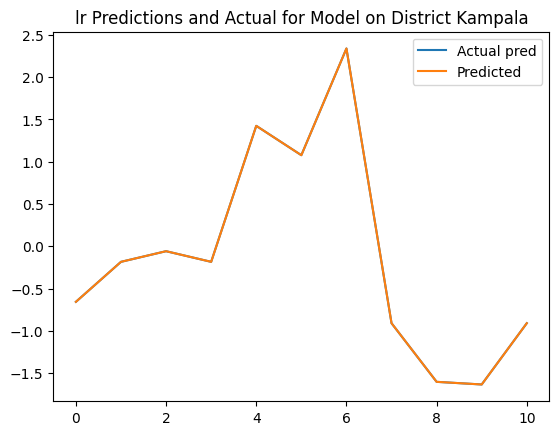

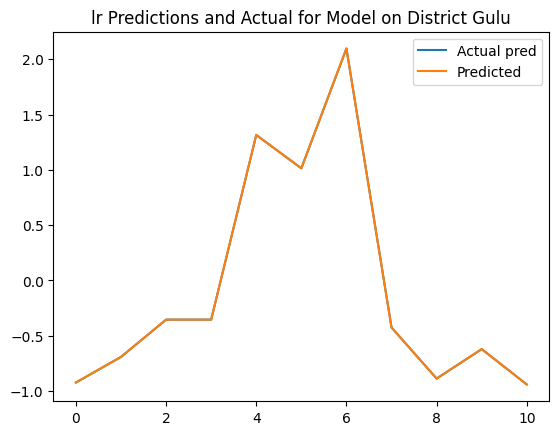

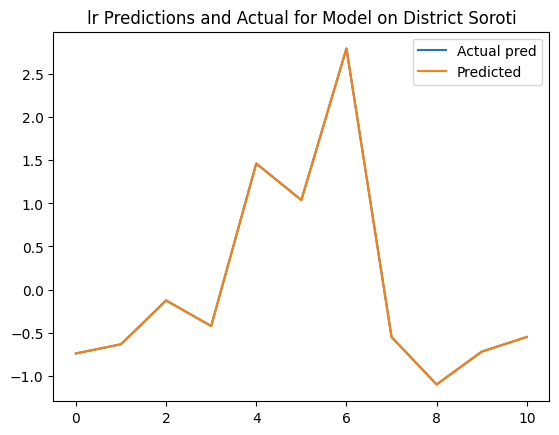

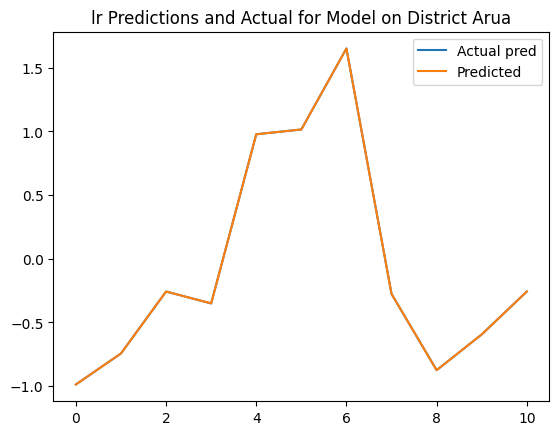

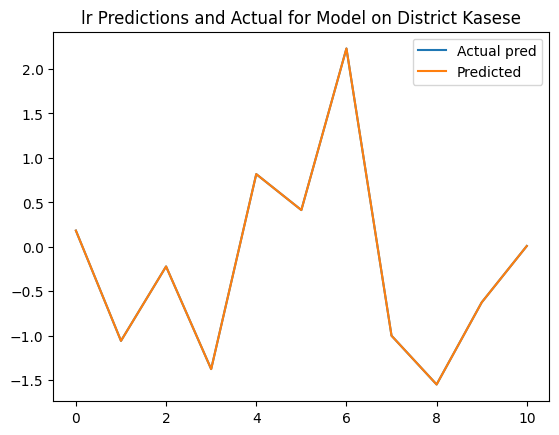

...

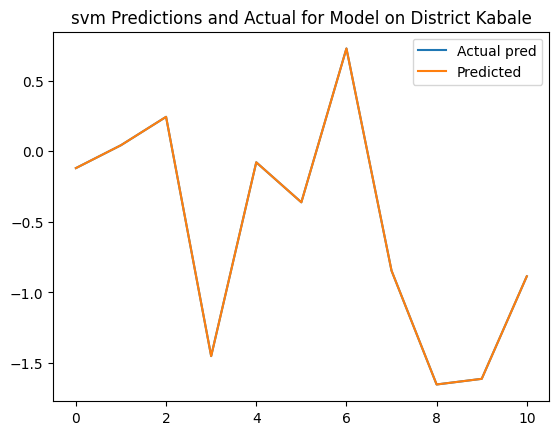

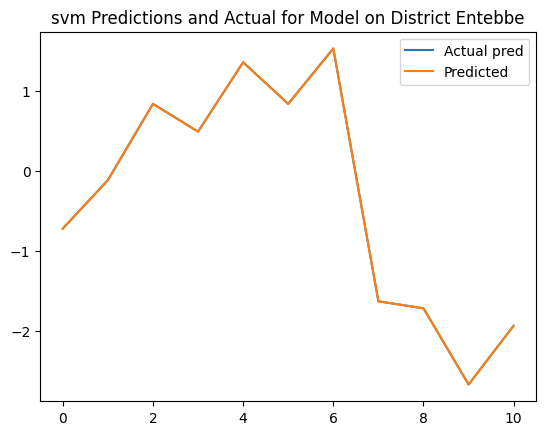

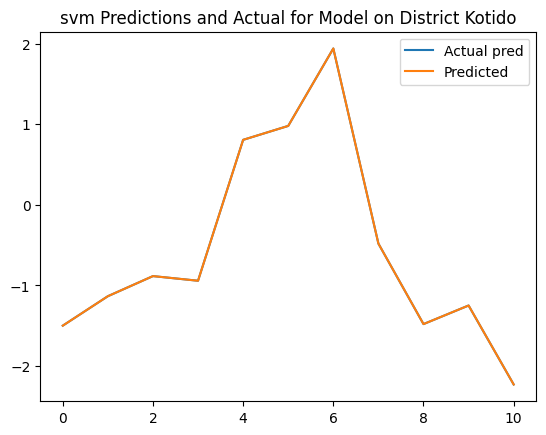

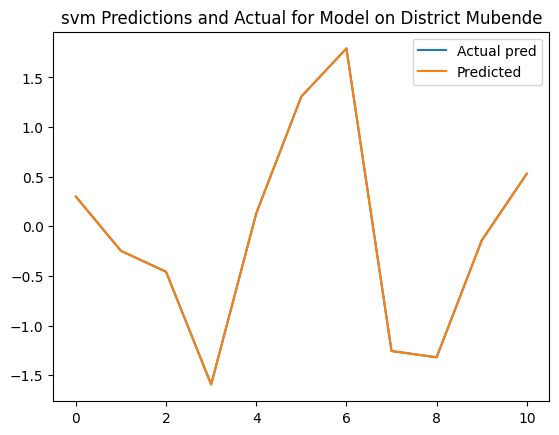

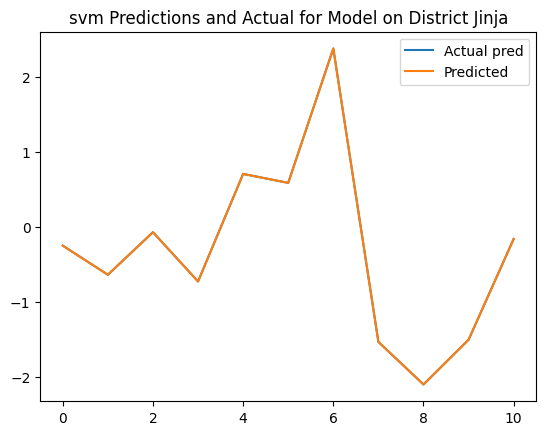

{'lr': [('Kampala', 2.0906509e-13),
  ('Gulu', 1.6786572e-13),
  ('Soroti', 8.116739e-14),
  ('Arua', 2.2656624e-13),
  ('Kasese', 3.355854e-13),
  ('Kabale', 1.3806127e-13),
  ('Entebbe', 5.910424e-14),
  ('Kotido', 4.1421412e-14),
  ('Mubende', 1.7250848e-13),
  ('Jinja', 9.667015e-14)],
 'ridge': [('Kampala', 0.0009181733),
  ('Gulu', 0.001993743),
  ('Soroti', 0.0015931536),
  ('Arua', 0.0015384194),
  ('Kasese', 0.0013938253),
  ('Kabale', 0.0010725763),
  ('Entebbe', 0.00083804695),
  ('Kotido', 0.0011871748),
  ('Mubende', 0.0010118807),
  ('Jinja', 0.0014205794)],
 'forest': [('Kampala', 0.05127340761711419),
  ('Gulu', 0.001215935070833474),
  ('Soroti', 0.048789683077651726),
  ('Arua', 0.005784122119170246),
  ('Kasese', 0.01755195809015295),
  ('Kabale', 0.011497799749912663),
  ('Entebbe', 0.16861667314007409),
  ('Kotido', 0.04944734818962057),
  ('Mubende', 0.014166204207997878),
  ('Jinja', 0.1345263234315289)],
 'xtree': [('Kampala', 0.026178441254737176),
  ('Gulu', 0

In [16]:
lookback = 8
train_ML_models(models, 8)

## Lookback 9

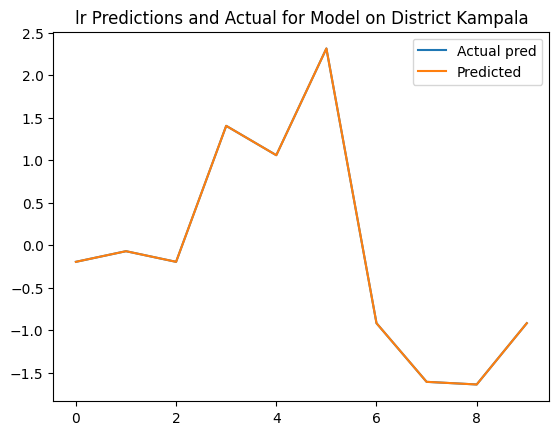

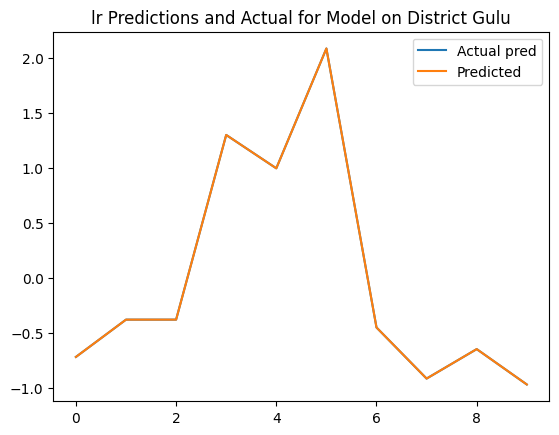

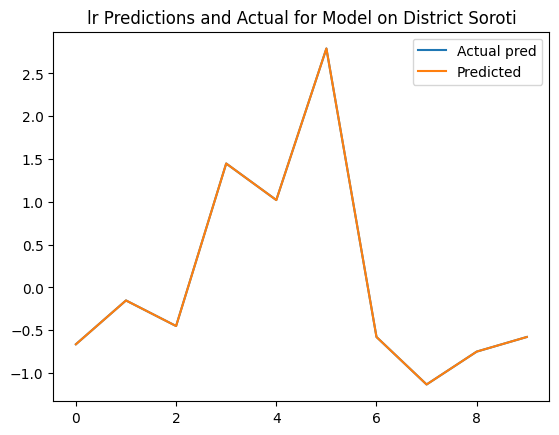

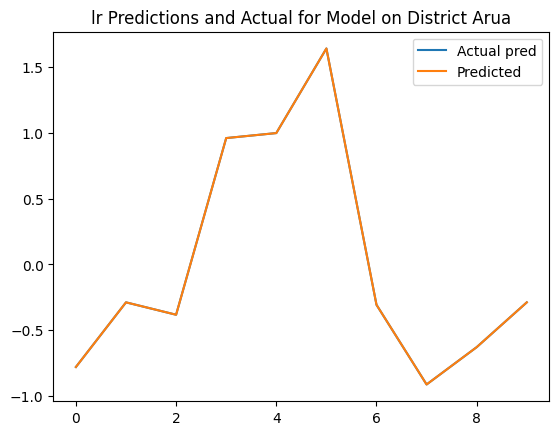

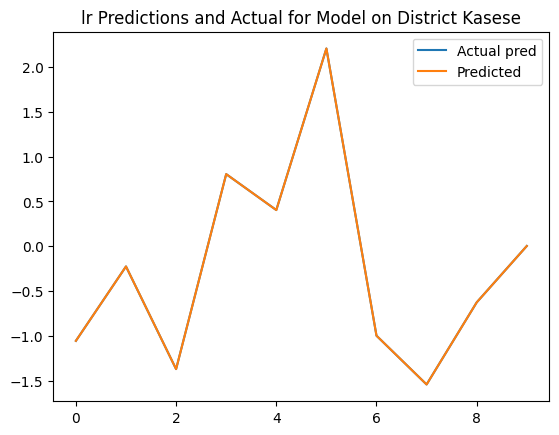

...

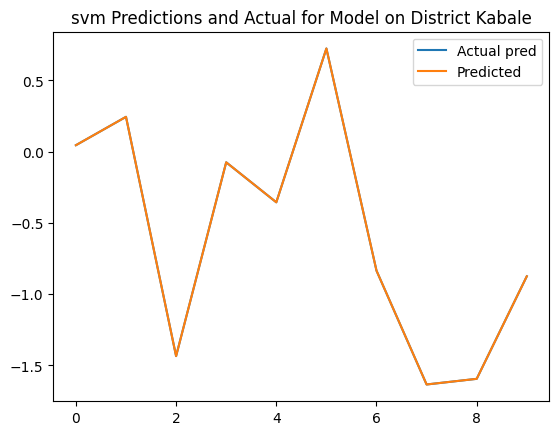

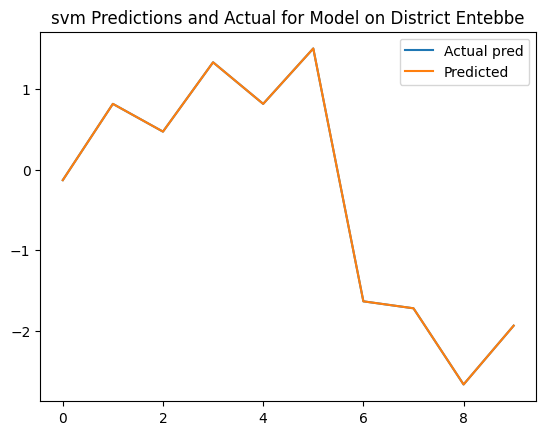

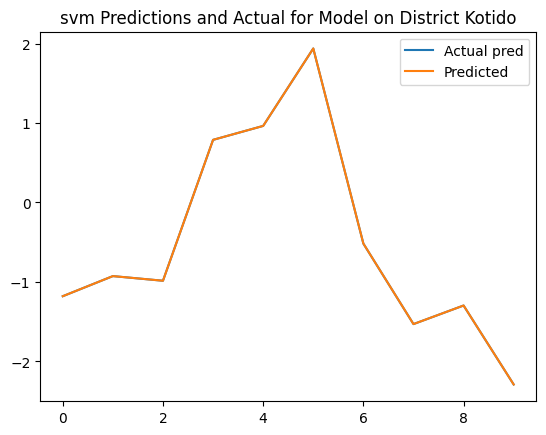

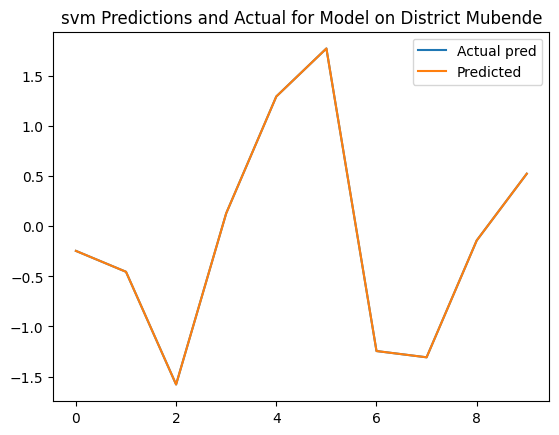

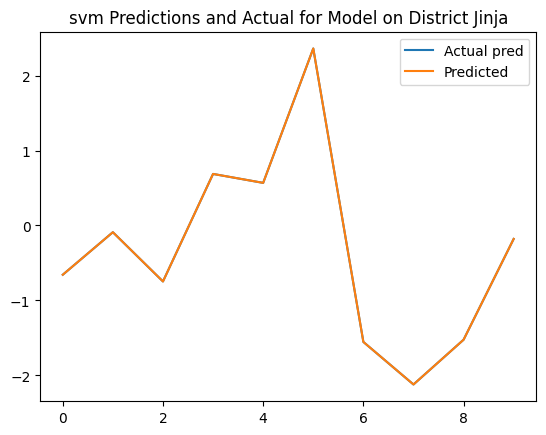

{'lr': [('Kampala', 5.708767e-14),
  ('Gulu', 1.4406254e-13),
  ('Soroti', 2.9747315e-13),
  ('Arua', 2.4220627e-13),
  ('Kasese', 7.340912e-14),
  ('Kabale', 1.2759238e-13),
  ('Entebbe', 2.1629364e-13),
  ('Kotido', 9.094947e-14),
  ('Mubende', 1.13020704e-13),
  ('Jinja', 1.07253094e-13)],
 'ridge': [('Kampala', 0.0011177959),
  ('Gulu', 0.0028639892),
  ('Soroti', 0.0023789816),
  ('Arua', 0.0016931957),
  ('Kasese', 0.0021463914),
  ('Kabale', 0.0013641577),
  ('Entebbe', 0.00093760603),
  ('Kotido', 0.0017953215),
  ('Mubende', 0.0014129638),
  ('Jinja', 0.0017461304)],
 'forest': [('Kampala', 0.05387867040674101),
  ('Gulu', 0.0031870644516000376),
  ('Soroti', 0.06093490756518335),
  ('Arua', 0.001988264538375492),
  ('Kasese', 0.01921115752924398),
  ('Kabale', 0.01491292062524954),
  ('Entebbe', 0.19896584145280613),
  ('Kotido', 0.07326752382151672),
  ('Mubende', 0.014778605977395725),
  ('Jinja', 0.15681147358543934)],
 'xtree': [('Kampala', 0.03074062175292664),
  ('Gulu'

In [17]:
lookback = 9
train_ML_models(models, 9)

## Lookback 10

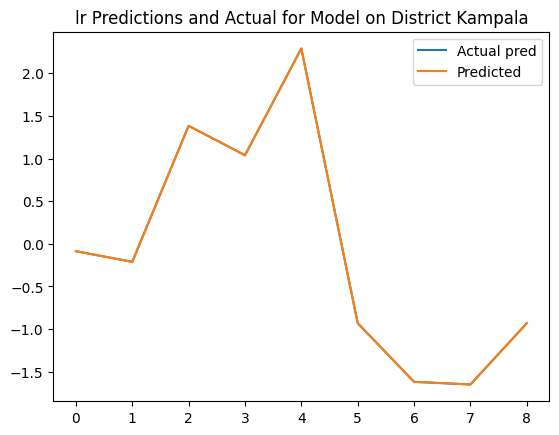

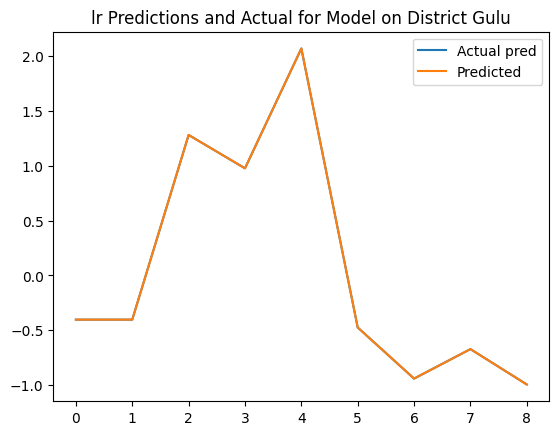

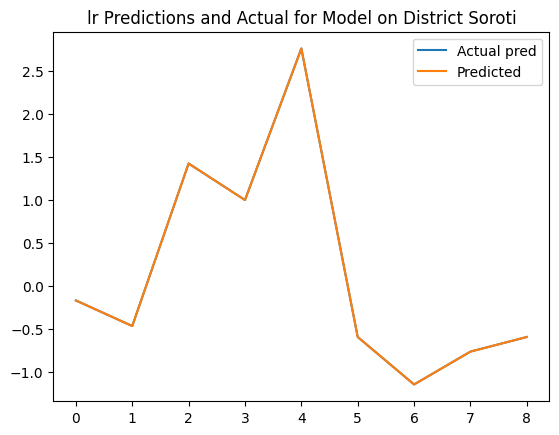

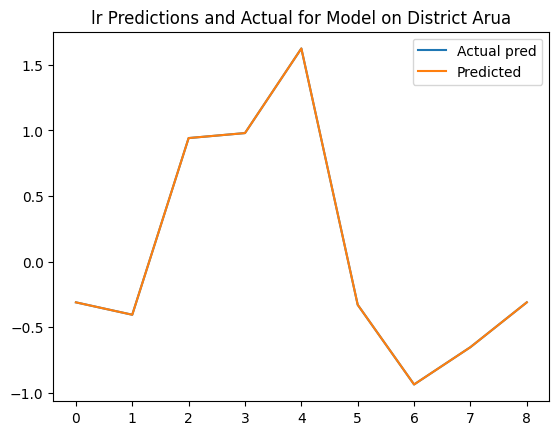

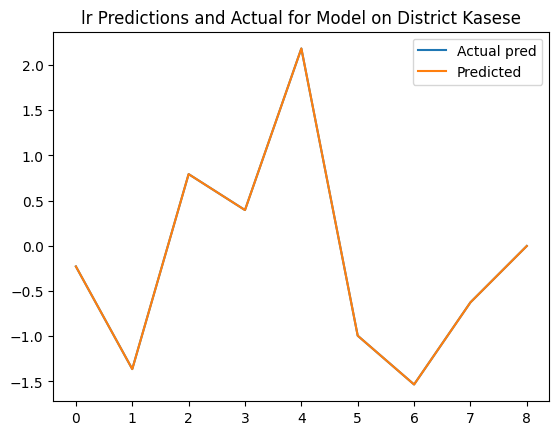

...

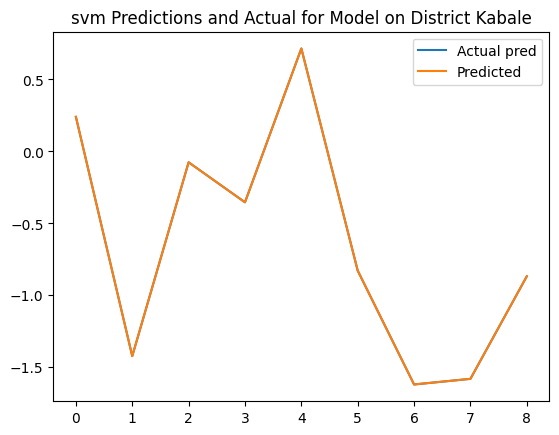

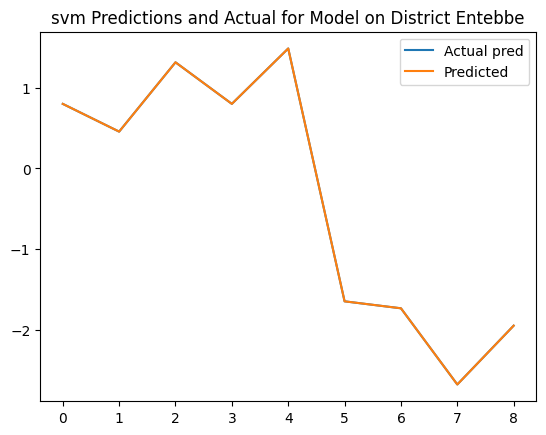

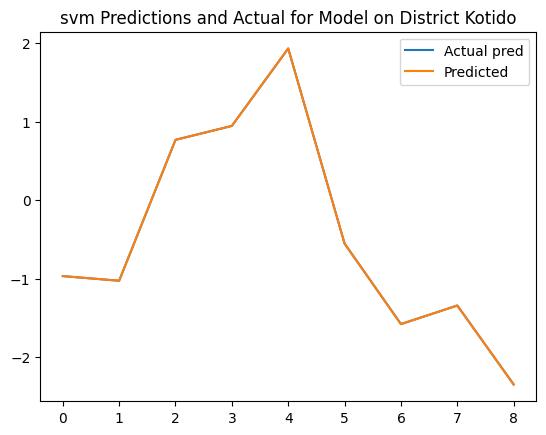

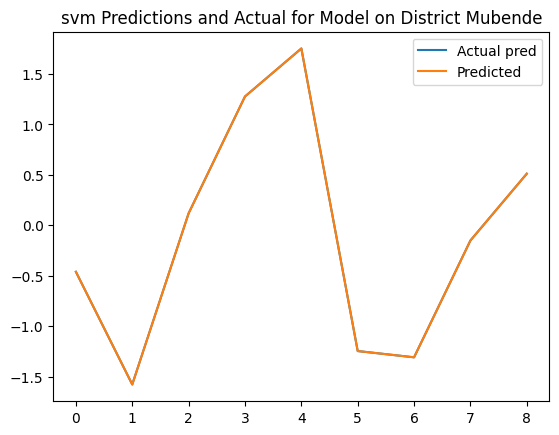

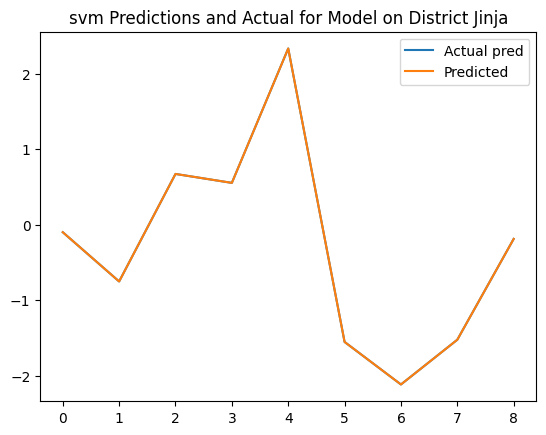

{'lr': [('Kampala', 6.329011e-13),
  ('Gulu', 1.0954201e-13),
  ('Soroti', 1.9115574e-13),
  ('Arua', 7.490305e-14),
  ('Kasese', 4.0107796e-14),
  ('Kabale', 8.569071e-14),
  ('Entebbe', 1.2010147e-13),
  ('Kotido', 6.039613e-14),
  ('Mubende', 1.3592214e-13),
  ('Jinja', 2.3598408e-13)],
 'ridge': [('Kampala', 0.0012222267),
  ('Gulu', 0.0029132855),
  ('Soroti', 0.0025726866),
  ('Arua', 0.0019134051),
  ('Kasese', 0.002243012),
  ('Kabale', 0.0015717443),
  ('Entebbe', 0.0011124747),
  ('Kotido', 0.0019777066),
  ('Mubende', 0.0015077149),
  ('Jinja', 0.0019060746)],
 'forest': [('Kampala', 0.06250427994510584),
  ('Gulu', 0.0023848585239102343),
  ('Soroti', 0.07713733650493462),
  ('Arua', 0.002034022027929399),
  ('Kasese', 0.01971389937631204),
  ('Kabale', 0.015724756235363083),
  ('Entebbe', 0.21094476566582138),
  ('Kotido', 0.07476472495420994),
  ('Mubende', 0.013666985989066033),
  ('Jinja', 0.16996222525568877)],
 'xtree': [('Kampala', 0.03347927153710721),
  ('Gulu', 0.

In [18]:
lookback = 10
train_ML_models(models, 10)

# Prepare dataset

In [19]:
class RNNDataset(Dataset):
    def __init__(self, X, y):
        super().__init__()
        self.X = X
        self.y = y
        
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, i):
        return self.X[i], self.y[i]

In [20]:
batch = 5
lookback = 7

In [21]:
def create_series_dataloader_on_district(district : str):
    series_df = new_df[[district]].astype('float32').copy()
    plot_series_data(series_df, district)
    Xtrain = series_df[:60]
    Xtest = series_df[60:]
    Train_df = create_dataset(Xtrain, district)
    Test_df = create_dataset(Xtest, district)
    
    scaler = StandardScaler().fit(Train_df.to_numpy())

    Train_scaled = scaler.transform(Train_df.to_numpy())
    Test_scaled = scaler.transform(Test_df.to_numpy())
    
    Xtrain = Train_scaled[:, 1:]
    ytrain = Train_scaled[:, 0]

    Xtest = Test_scaled[:, 1:]
    ytest = Test_scaled[:, 0]
    
    Xtrain = Xtrain.reshape((-1, lookback, 1))
    Xtest = Xtest.reshape((-1, lookback, 1))

    ytrain = ytrain.reshape((-1, 1))
    ytest = ytest.reshape((-1, 1))
    
    Train_dataset = RNNDataset(torch.from_numpy(Xtrain), torch.from_numpy(ytrain))
    Test_dataset = RNNDataset(torch.from_numpy(Xtest), torch.from_numpy(ytest))
    
    Train_dataloader = DataLoader(Train_dataset, batch, shuffle = True)
    Test_dataloader = DataLoader(Test_dataset, batch)
    
    data_dict = {
        "Xtrain" : Xtrain,
        "Xtest" : Xtest,
        "ytrain" : ytrain,
        "ytest" : ytest
    }
    
    return Train_dataloader, Test_dataloader, data_dict

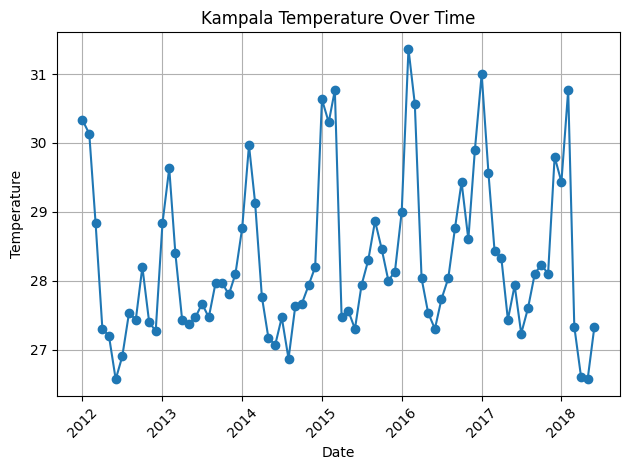

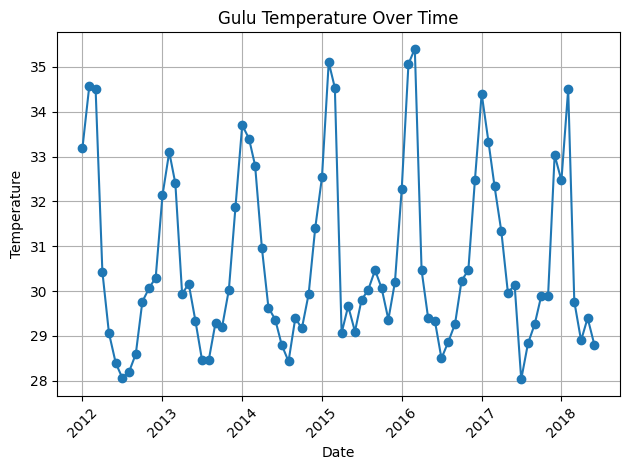

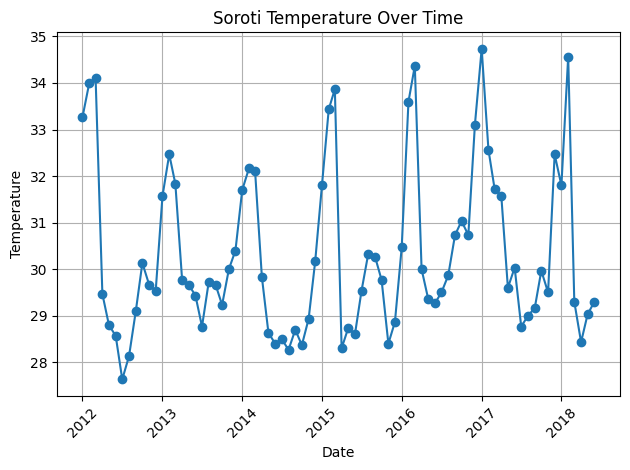

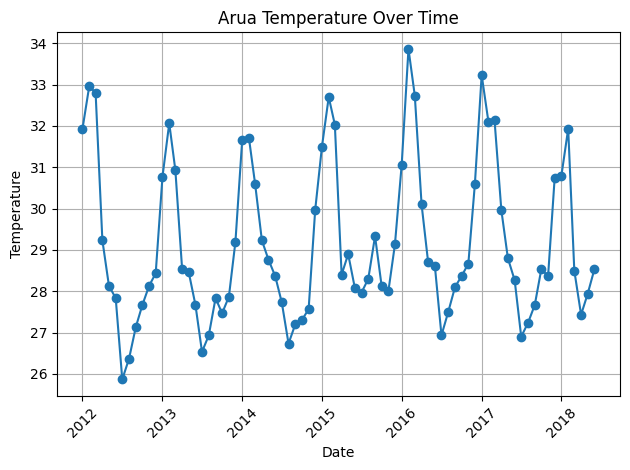

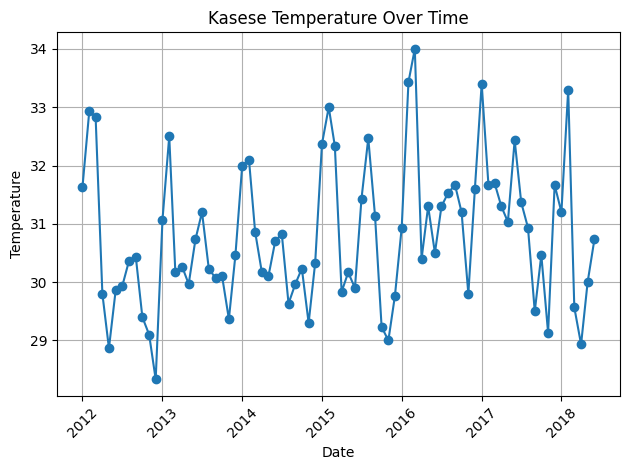

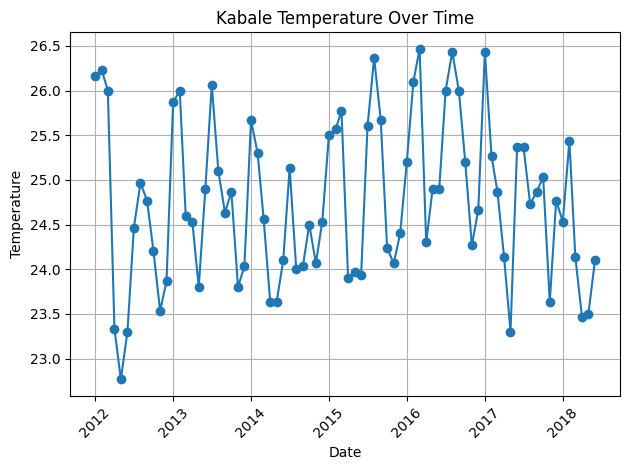

In [22]:
kampala_train_dataloader, kampale_test_dataloader, kampala_dict = create_series_dataloader_on_district('Kampala')
gulu_train_dataloader, gulu_test_dataloader, gulu_dict = create_series_dataloader_on_district('Gulu')
soroti_train_dataloader, soroti_test_dataloader, soroti_dict = create_series_dataloader_on_district('Soroti')
arua_train_dataloader, arua_test_dataloader, arua_dict = create_series_dataloader_on_district('Arua')
kasese_train_dataloader, kasese_test_dataloader, kasese_dict = create_series_dataloader_on_district('Kasese')
kabale_train_dataloader, kabale_test_dataloader, kabale_dict = create_series_dataloader_on_district('Kabale')

# LSTM_Model

In [23]:
class ModelLSTM(nn.Module):
    def __init__(self, num_ouput = 1, hidden_size = 128, num_layers = 1):
        super().__init__()
        self.num_layers = num_layers
        self.hidden_size = hidden_size
        
        self.lstm = nn.LSTM(input_size=1, hidden_size=self.hidden_size, num_layers=num_layers, batch_first = True)
        self.linear = nn.Linear(hidden_size, 1)
        
    def forward(self, x):
        batch_size = x.size(0)
        h0 = torch.zeros(self.num_layers, batch_size, self.hidden_size)
        c0 = torch.zeros(self.num_layers, batch_size, self.hidden_size)
        
        x, _ = self.lstm(x, (h0, c0))
        x = self.linear(x)
        return x[:, -1, :]

In [24]:
# test
for _, batch in enumerate(kabale_train_dataloader):
    train_batch, y_batch = batch[0], batch[1]
    print(train_batch.shape)
    print(y_batch.shape)
    break

torch.Size([5, 7, 1])
torch.Size([5, 1])


# Train

In [25]:
epochs = 100

In [26]:
def train_and_plot(train_dataloader, test_dataloader, data_dict, district):
    lstm_model = ModelLSTM()
    loss_fn = nn.MSELoss()
    optimizer = Adam(lstm_model.parameters())
    
    torch.manual_seed(1234)

    train_losses = []
    test_losses = []
    
    print(f"*************Model For District {district}")

    for epoch in range(epochs):
        lstm_model.train()
        train_loss = 0
        test_loss = 0

        for index, batch in enumerate(train_dataloader):
            X_batch, y_batch = batch[0], batch[1]
            y_pred = lstm_model(X_batch)
            loss = loss_fn(y_pred, y_batch)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        if epoch % 10 != 0:
            continue
            
        lstm_model.eval()
        with torch.inference_mode():
            for index, batch in enumerate(test_dataloader):
                X_batch, y_batch = batch[0], batch[1]
                y_pred_test = lstm_model(X_batch)
                loss = loss_fn(y_pred_test, y_batch)
                test_loss += loss.item()

            train_rmse = np.sqrt(train_loss)
            test_rmse = np.sqrt(test_loss)

            train_losses.append(train_loss)
            test_losses.append(test_loss)

        print("Epoch %d: train MSE %.4f, test MSE %.4f, train RMSE %.4f, test RMSE %.4f" % (epoch, train_loss, test_loss, train_rmse, test_rmse))
        
    #Plot
    lstm_model.eval()
    plot_pred_actual(lstm_model, district + ", Train", data_dict['Xtrain'], data_dict['ytrain'])
    plot_pred_actual(lstm_model, district + ", Test", data_dict['Xtest'], data_dict['ytest'])

In [27]:
def plot_pred_actual(lstm_model, district, X, y):
    with torch.inference_mode():
        predictions = lstm_model(torch.from_numpy(X)).numpy()

    plt.title(f"Model Predictions and Actual for Model on District {district}")
    plt.plot(y, label='Actual pred')
    plt.plot(predictions, label = "Predicted")
    plt.legend()
    plt.show()

*************Model For District Kampala
Epoch 0: train MSE 11.2279, test MSE 4.5435, train RMSE 3.3508, test RMSE 2.1315
Epoch 10: train MSE 9.5123, test MSE 4.1374, train RMSE 3.0842, test RMSE 2.0341
Epoch 20: train MSE 3.9710, test MSE 0.8044, train RMSE 1.9927, test RMSE 0.8969
Epoch 30: train MSE 3.6767, test MSE 1.0608, train RMSE 1.9175, test RMSE 1.0300
Epoch 40: train MSE 5.9049, test MSE 3.1236, train RMSE 2.4300, test RMSE 1.7674
Epoch 50: train MSE 4.6934, test MSE 1.0980, train RMSE 2.1664, test RMSE 1.0479
Epoch 60: train MSE 1.4442, test MSE 0.7091, train RMSE 1.2018, test RMSE 0.8421
Epoch 70: train MSE 3.2543, test MSE 1.7611, train RMSE 1.8040, test RMSE 1.3271
Epoch 80: train MSE 5.7984, test MSE 1.1731, train RMSE 2.4080, test RMSE 1.0831
Epoch 90: train MSE 7.1135, test MSE 2.2827, train RMSE 2.6671, test RMSE 1.5109


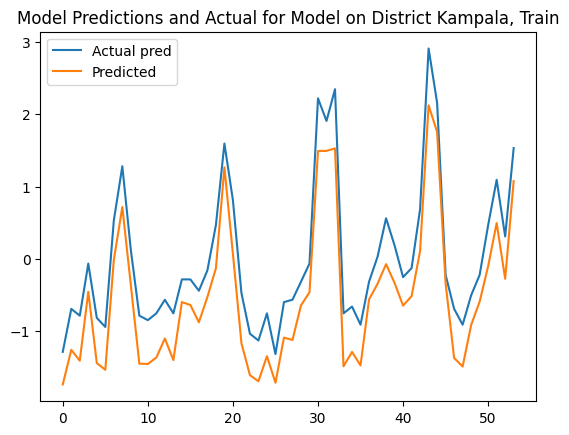

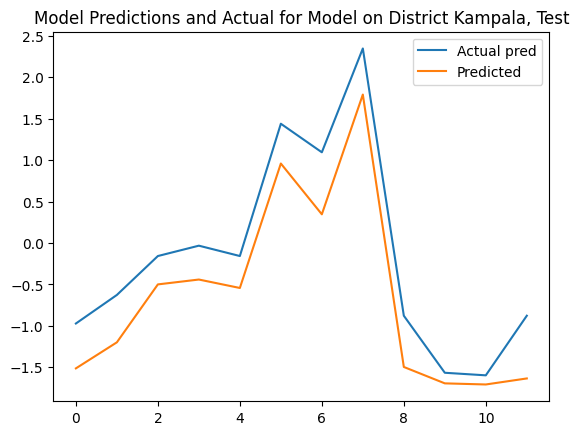

In [28]:
train_and_plot(kampala_train_dataloader, kampale_test_dataloader, kampala_dict, "Kampala")

*************Model For District Gulu
Epoch 0: train MSE 10.5805, test MSE 2.6333, train RMSE 3.2528, test RMSE 1.6227
Epoch 10: train MSE 10.7891, test MSE 2.8498, train RMSE 3.2847, test RMSE 1.6881
Epoch 20: train MSE 3.4183, test MSE 1.5895, train RMSE 1.8489, test RMSE 1.2608
Epoch 30: train MSE 2.5147, test MSE 0.6959, train RMSE 1.5858, test RMSE 0.8342
Epoch 40: train MSE 4.4916, test MSE 0.6092, train RMSE 2.1193, test RMSE 0.7805
Epoch 50: train MSE 13.3884, test MSE 2.3806, train RMSE 3.6590, test RMSE 1.5429
Epoch 60: train MSE 8.2358, test MSE 2.1717, train RMSE 2.8698, test RMSE 1.4737
Epoch 70: train MSE 4.7581, test MSE 0.6934, train RMSE 2.1813, test RMSE 0.8327
Epoch 80: train MSE 2.2882, test MSE 0.6205, train RMSE 1.5127, test RMSE 0.7877
Epoch 90: train MSE 2.4579, test MSE 0.3084, train RMSE 1.5678, test RMSE 0.5553


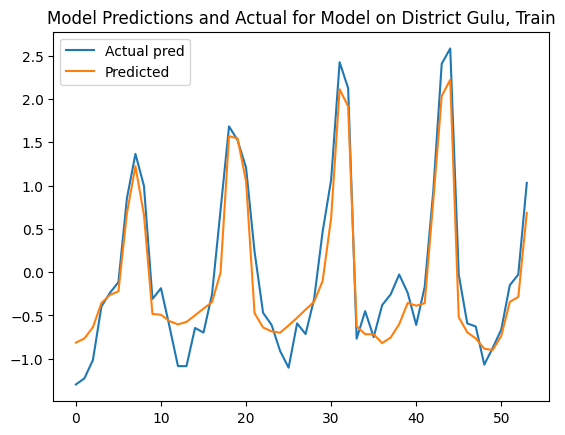

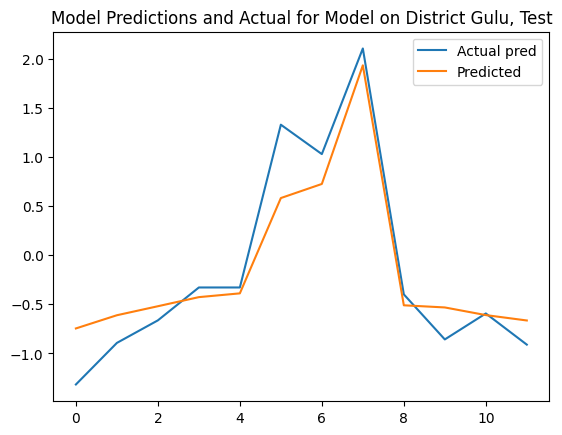

In [29]:
train_and_plot(gulu_train_dataloader, gulu_test_dataloader, gulu_dict, "Gulu")

*************Model For District Soroti
Epoch 0: train MSE 10.7046, test MSE 2.9921, train RMSE 3.2718, test RMSE 1.7298
Epoch 10: train MSE 10.8507, test MSE 3.1895, train RMSE 3.2940, test RMSE 1.7859
Epoch 20: train MSE 11.6145, test MSE 2.4291, train RMSE 3.4080, test RMSE 1.5586
Epoch 30: train MSE 10.7712, test MSE 2.7840, train RMSE 3.2820, test RMSE 1.6685
Epoch 40: train MSE 8.6089, test MSE 2.4157, train RMSE 2.9341, test RMSE 1.5543
Epoch 50: train MSE 5.5413, test MSE 1.5645, train RMSE 2.3540, test RMSE 1.2508
Epoch 60: train MSE 5.5663, test MSE 1.6248, train RMSE 2.3593, test RMSE 1.2747
Epoch 70: train MSE 6.4861, test MSE 1.0054, train RMSE 2.5468, test RMSE 1.0027
Epoch 80: train MSE 7.0254, test MSE 1.7938, train RMSE 2.6505, test RMSE 1.3393
Epoch 90: train MSE 4.0150, test MSE 0.6099, train RMSE 2.0037, test RMSE 0.7809


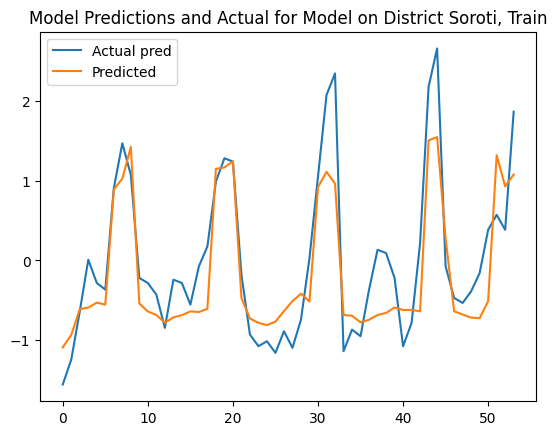

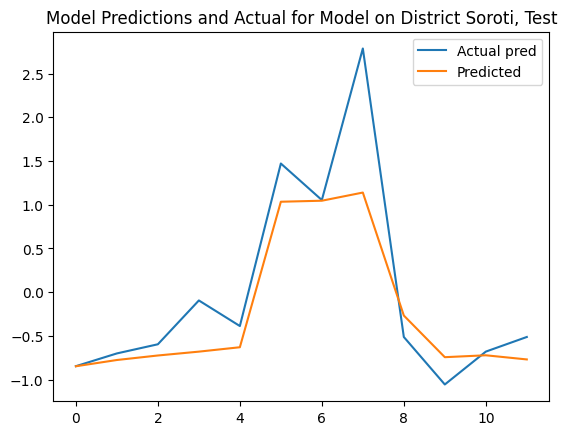

In [30]:
train_and_plot(soroti_train_dataloader, soroti_test_dataloader, soroti_dict, "Soroti")

*************Model For District Arua
Epoch 0: train MSE 10.5537, test MSE 1.6567, train RMSE 3.2486, test RMSE 1.2871
Epoch 10: train MSE 9.9793, test MSE 1.6379, train RMSE 3.1590, test RMSE 1.2798
Epoch 20: train MSE 9.8826, test MSE 1.5141, train RMSE 3.1437, test RMSE 1.2305
Epoch 30: train MSE 7.6777, test MSE 1.2169, train RMSE 2.7709, test RMSE 1.1031
Epoch 40: train MSE 4.0241, test MSE 0.5070, train RMSE 2.0060, test RMSE 0.7120
Epoch 50: train MSE 3.4152, test MSE 0.8352, train RMSE 1.8480, test RMSE 0.9139
Epoch 60: train MSE 3.0950, test MSE 0.3955, train RMSE 1.7593, test RMSE 0.6289
Epoch 70: train MSE 3.0921, test MSE 0.6143, train RMSE 1.7584, test RMSE 0.7838
Epoch 80: train MSE 3.7896, test MSE 0.8876, train RMSE 1.9467, test RMSE 0.9421
Epoch 90: train MSE 3.7213, test MSE 0.7753, train RMSE 1.9291, test RMSE 0.8805


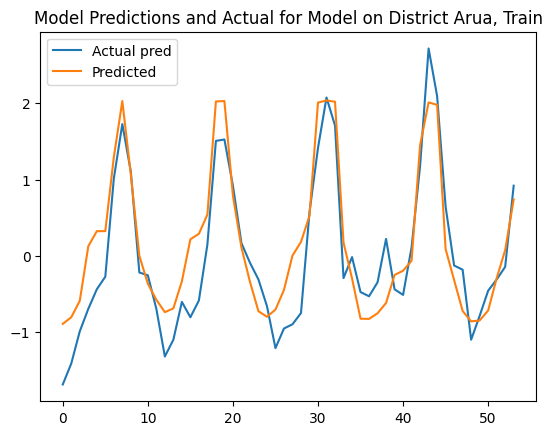

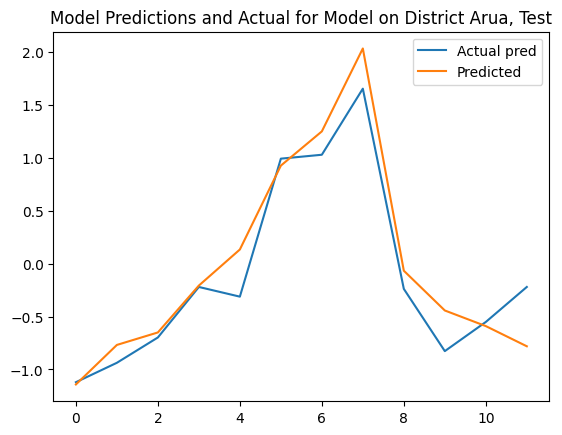

In [31]:
train_and_plot(arua_train_dataloader, arua_test_dataloader, arua_dict, "Arua")

*************Model For District Kasese
Epoch 0: train MSE 11.0513, test MSE 2.6627, train RMSE 3.3243, test RMSE 1.6318
Epoch 10: train MSE 14.9962, test MSE 3.5604, train RMSE 3.8725, test RMSE 1.8869
Epoch 20: train MSE 11.1851, test MSE 2.7537, train RMSE 3.3444, test RMSE 1.6594
Epoch 30: train MSE 9.7302, test MSE 2.8053, train RMSE 3.1193, test RMSE 1.6749
Epoch 40: train MSE 8.2365, test MSE 2.2563, train RMSE 2.8699, test RMSE 1.5021
Epoch 50: train MSE 5.1820, test MSE 0.9556, train RMSE 2.2764, test RMSE 0.9775
Epoch 60: train MSE 3.6370, test MSE 1.4054, train RMSE 1.9071, test RMSE 1.1855
Epoch 70: train MSE 3.0309, test MSE 2.1613, train RMSE 1.7409, test RMSE 1.4701
Epoch 80: train MSE 2.4529, test MSE 2.2717, train RMSE 1.5662, test RMSE 1.5072
Epoch 90: train MSE 1.9724, test MSE 1.6972, train RMSE 1.4044, test RMSE 1.3028


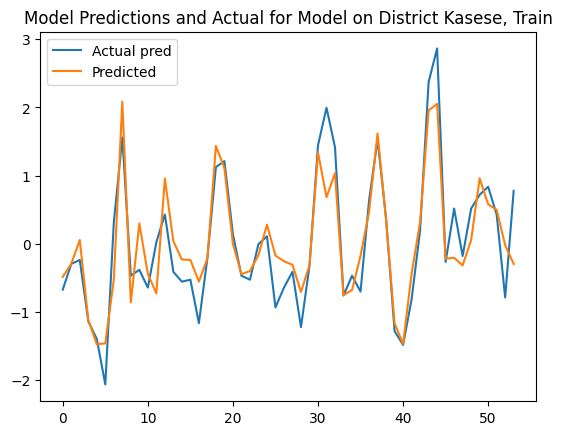

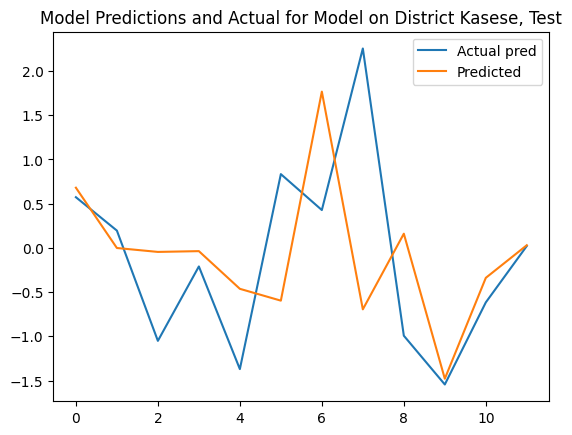

In [32]:
train_and_plot(kasese_train_dataloader, kasese_test_dataloader, kasese_dict, "Kasese")

*************Model For District Kabale
Epoch 0: train MSE 11.1099, test MSE 2.8817, train RMSE 3.3332, test RMSE 1.6976
Epoch 10: train MSE 8.6404, test MSE 2.0188, train RMSE 2.9395, test RMSE 1.4209
Epoch 20: train MSE 2.4173, test MSE 1.1645, train RMSE 1.5548, test RMSE 1.0791
Epoch 30: train MSE 2.8417, test MSE 1.2823, train RMSE 1.6857, test RMSE 1.1324
Epoch 40: train MSE 2.0483, test MSE 0.4633, train RMSE 1.4312, test RMSE 0.6807
Epoch 50: train MSE 2.2923, test MSE 0.8592, train RMSE 1.5140, test RMSE 0.9269
Epoch 60: train MSE 2.1422, test MSE 1.3222, train RMSE 1.4636, test RMSE 1.1499
Epoch 70: train MSE 2.6386, test MSE 0.3059, train RMSE 1.6244, test RMSE 0.5531
Epoch 80: train MSE 2.5913, test MSE 0.6806, train RMSE 1.6097, test RMSE 0.8250
Epoch 90: train MSE 1.3760, test MSE 0.3402, train RMSE 1.1730, test RMSE 0.5833


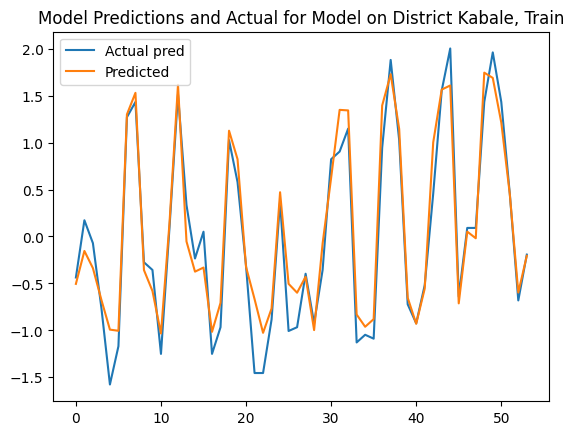

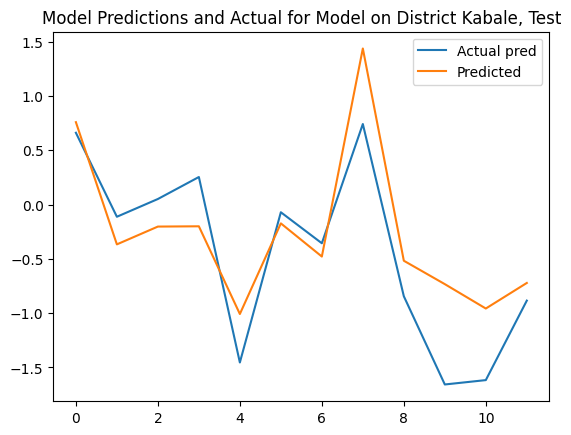

In [33]:
train_and_plot(kabale_train_dataloader, kabale_test_dataloader, kabale_dict, "Kabale")

# Test the model's Performance with different Lookback values

## Testing with Lookback = 3

In [34]:
lookback = 3
batch = 5

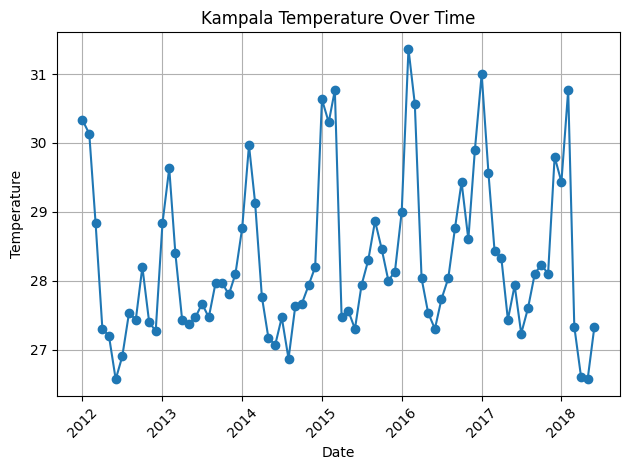

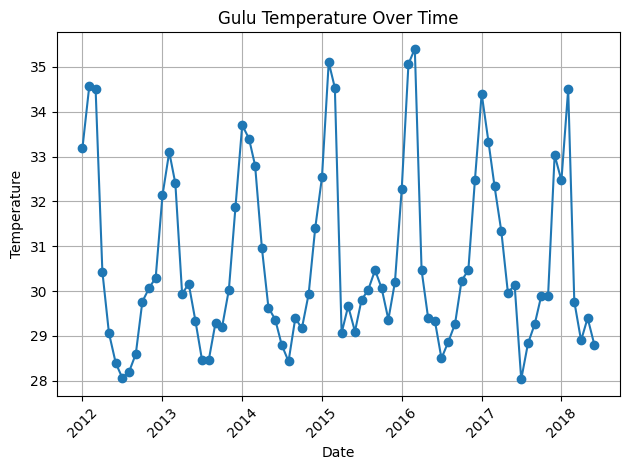

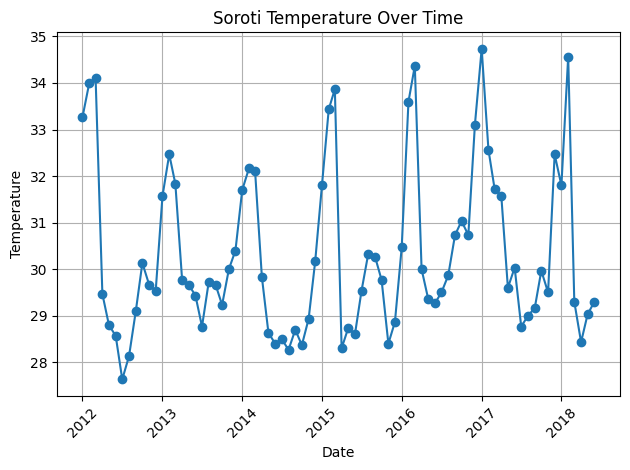

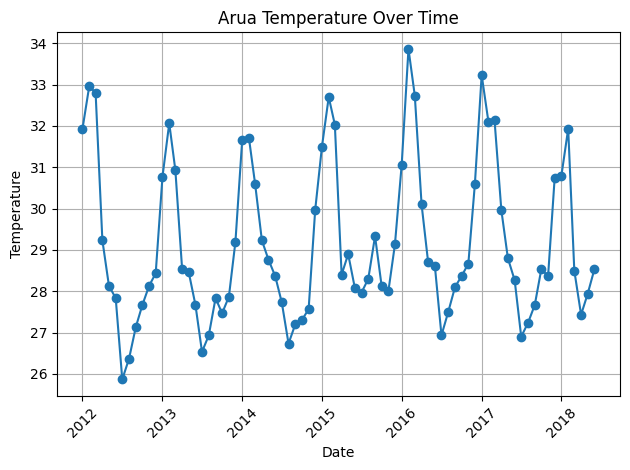

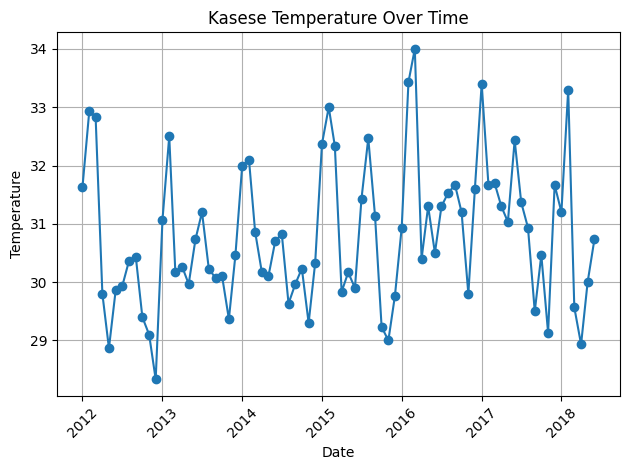

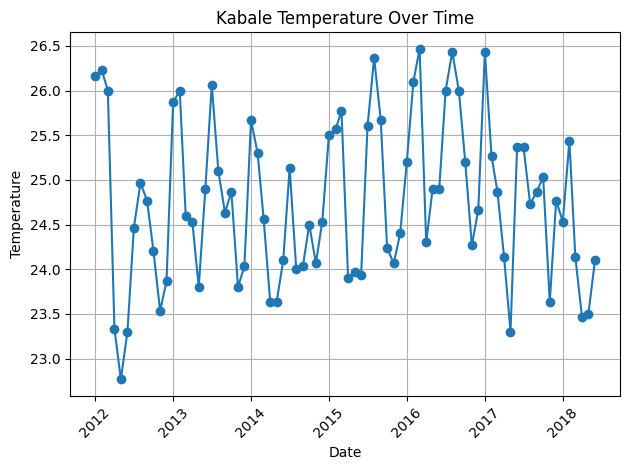

In [35]:
kampala_train_dataloader, kampale_test_dataloader, kampala_dict = create_series_dataloader_on_district('Kampala')
gulu_train_dataloader, gulu_test_dataloader, gulu_dict = create_series_dataloader_on_district('Gulu')
soroti_train_dataloader, soroti_test_dataloader, soroti_dict = create_series_dataloader_on_district('Soroti')
arua_train_dataloader, arua_test_dataloader, arua_dict = create_series_dataloader_on_district('Arua')
kasese_train_dataloader, kasese_test_dataloader, kasese_dict = create_series_dataloader_on_district('Kasese')
kabale_train_dataloader, kabale_test_dataloader, kabale_dict = create_series_dataloader_on_district('Kabale')

*************Model For District Kampala
Epoch 0: train MSE 11.5277, test MSE 3.4604, train RMSE 3.3952, test RMSE 1.8602
Epoch 10: train MSE 9.5642, test MSE 3.3251, train RMSE 3.0926, test RMSE 1.8235
Epoch 20: train MSE 8.4577, test MSE 1.8741, train RMSE 2.9082, test RMSE 1.3690
Epoch 30: train MSE 6.7821, test MSE 2.4004, train RMSE 2.6043, test RMSE 1.5493
Epoch 40: train MSE 2.2617, test MSE 0.8151, train RMSE 1.5039, test RMSE 0.9028
Epoch 50: train MSE 3.7877, test MSE 0.9862, train RMSE 1.9462, test RMSE 0.9931
Epoch 60: train MSE 2.1089, test MSE 0.6186, train RMSE 1.4522, test RMSE 0.7865
Epoch 70: train MSE 0.6040, test MSE 0.3627, train RMSE 0.7772, test RMSE 0.6023
Epoch 80: train MSE 0.6161, test MSE 0.2801, train RMSE 0.7849, test RMSE 0.5293
Epoch 90: train MSE 2.8445, test MSE 0.5860, train RMSE 1.6866, test RMSE 0.7655


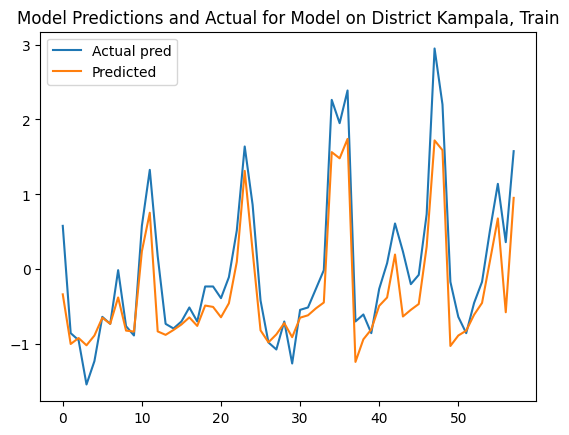

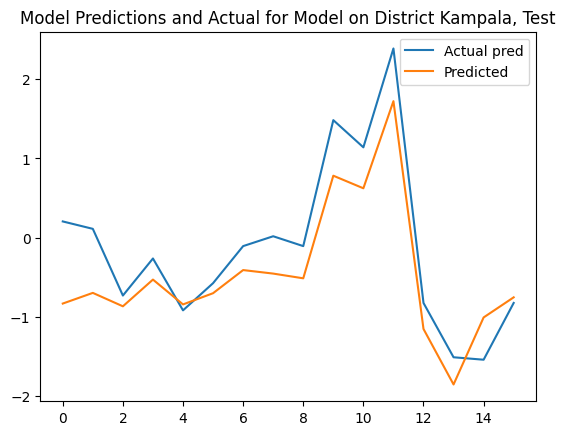

In [36]:
train_and_plot(kampala_train_dataloader, kampale_test_dataloader, kampala_dict, "Kampala")

*************Model For District Gulu
Epoch 0: train MSE 11.2149, test MSE 2.8514, train RMSE 3.3489, test RMSE 1.6886
Epoch 10: train MSE 8.7121, test MSE 2.5734, train RMSE 2.9516, test RMSE 1.6042
Epoch 20: train MSE 12.6414, test MSE 2.3894, train RMSE 3.5555, test RMSE 1.5458
Epoch 30: train MSE 9.0758, test MSE 2.1093, train RMSE 3.0126, test RMSE 1.4523
Epoch 40: train MSE 2.3497, test MSE 0.7452, train RMSE 1.5329, test RMSE 0.8632
Epoch 50: train MSE 2.1456, test MSE 0.5543, train RMSE 1.4648, test RMSE 0.7445
Epoch 60: train MSE 0.4717, test MSE 0.1437, train RMSE 0.6868, test RMSE 0.3791
Epoch 70: train MSE 0.7921, test MSE 0.4170, train RMSE 0.8900, test RMSE 0.6457
Epoch 80: train MSE 1.3696, test MSE 0.3458, train RMSE 1.1703, test RMSE 0.5881
Epoch 90: train MSE 0.9763, test MSE 0.4137, train RMSE 0.9881, test RMSE 0.6432


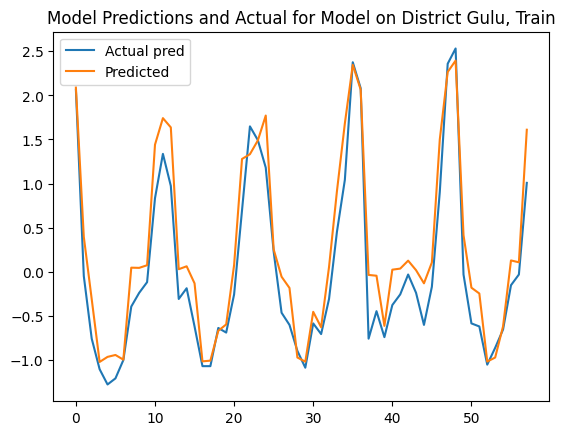

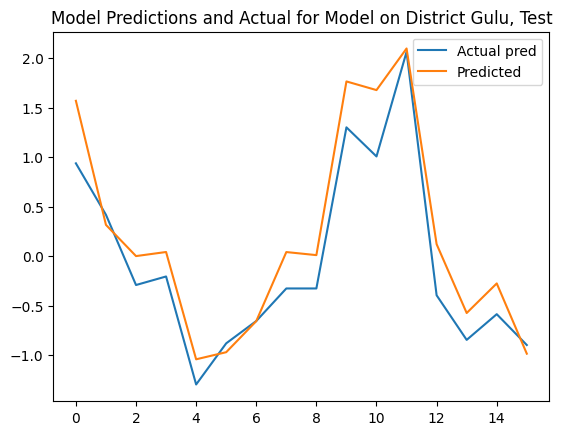

In [37]:
train_and_plot(gulu_train_dataloader, gulu_test_dataloader, gulu_dict, "Gulu")

*************Model For District Soroti
Epoch 0: train MSE 11.4850, test MSE 3.0108, train RMSE 3.3889, test RMSE 1.7352
Epoch 10: train MSE 9.0324, test MSE 2.4240, train RMSE 3.0054, test RMSE 1.5569
Epoch 20: train MSE 9.1105, test MSE 2.3550, train RMSE 3.0184, test RMSE 1.5346
Epoch 30: train MSE 5.9094, test MSE 1.7940, train RMSE 2.4309, test RMSE 1.3394
Epoch 40: train MSE 3.0067, test MSE 0.9301, train RMSE 1.7340, test RMSE 0.9644
Epoch 50: train MSE 2.5793, test MSE 0.5663, train RMSE 1.6060, test RMSE 0.7525
Epoch 60: train MSE 0.3167, test MSE 0.1606, train RMSE 0.5628, test RMSE 0.4008
Epoch 70: train MSE 2.0079, test MSE 0.9688, train RMSE 1.4170, test RMSE 0.9843
Epoch 80: train MSE 2.4733, test MSE 0.2263, train RMSE 1.5727, test RMSE 0.4757
Epoch 90: train MSE 1.1765, test MSE 0.9605, train RMSE 1.0847, test RMSE 0.9800


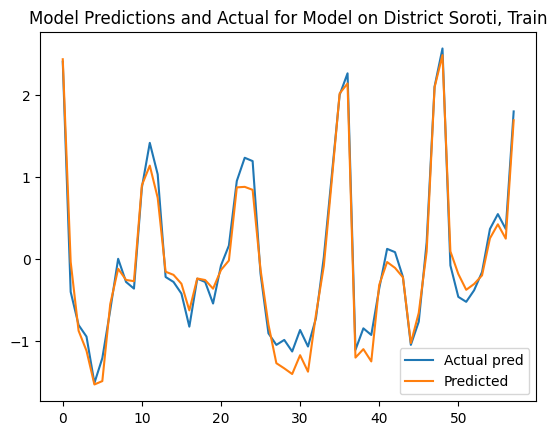

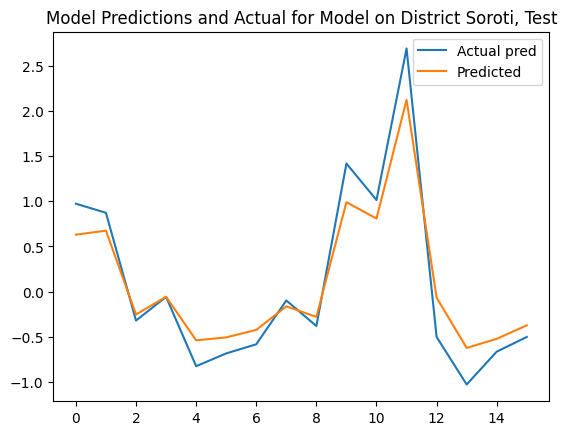

In [38]:
train_and_plot(soroti_train_dataloader, soroti_test_dataloader, soroti_dict, "Soroti")

*************Model For District Arua
Epoch 0: train MSE 11.2397, test MSE 2.0983, train RMSE 3.3526, test RMSE 1.4485
Epoch 10: train MSE 9.9672, test MSE 2.0108, train RMSE 3.1571, test RMSE 1.4180
Epoch 20: train MSE 9.5359, test MSE 2.0181, train RMSE 3.0880, test RMSE 1.4206
Epoch 30: train MSE 3.0298, test MSE 0.7644, train RMSE 1.7406, test RMSE 0.8743
Epoch 40: train MSE 4.8752, test MSE 0.9242, train RMSE 2.2080, test RMSE 0.9613
Epoch 50: train MSE 0.9753, test MSE 0.2523, train RMSE 0.9876, test RMSE 0.5023
Epoch 60: train MSE 0.8388, test MSE 0.1368, train RMSE 0.9159, test RMSE 0.3698
Epoch 70: train MSE 2.8869, test MSE 0.5529, train RMSE 1.6991, test RMSE 0.7436
Epoch 80: train MSE 4.4751, test MSE 2.2766, train RMSE 2.1154, test RMSE 1.5088
Epoch 90: train MSE 11.1656, test MSE 4.6979, train RMSE 3.3415, test RMSE 2.1675


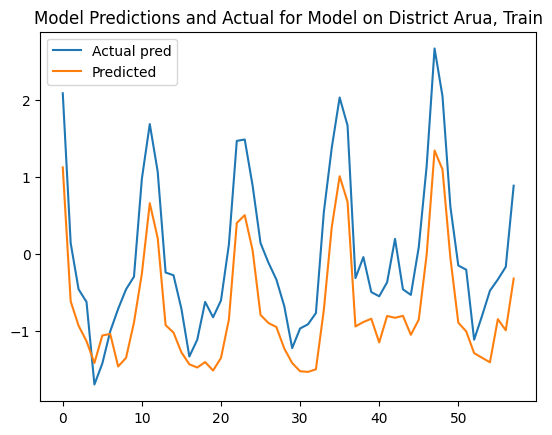

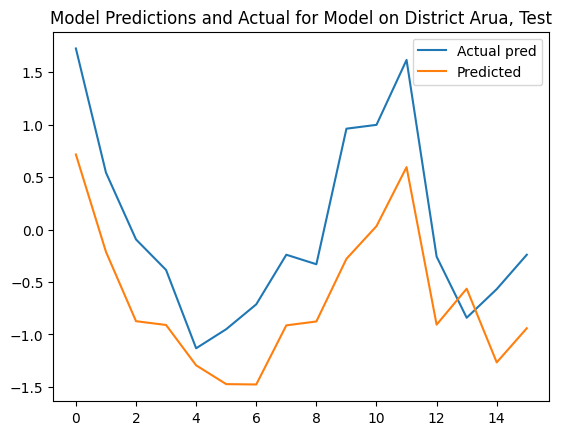

In [39]:
train_and_plot(arua_train_dataloader, arua_test_dataloader, arua_dict, "Arua")

*************Model For District Kasese
Epoch 0: train MSE 11.8246, test MSE 2.9245, train RMSE 3.4387, test RMSE 1.7101
Epoch 10: train MSE 10.7511, test MSE 2.8483, train RMSE 3.2789, test RMSE 1.6877
Epoch 20: train MSE 4.7647, test MSE 2.1245, train RMSE 2.1828, test RMSE 1.4576
Epoch 30: train MSE 7.4794, test MSE 3.0260, train RMSE 2.7348, test RMSE 1.7395
Epoch 40: train MSE 9.2542, test MSE 3.0047, train RMSE 3.0421, test RMSE 1.7334
Epoch 50: train MSE 1.8186, test MSE 0.8053, train RMSE 1.3485, test RMSE 0.8974
Epoch 60: train MSE 2.1655, test MSE 0.4614, train RMSE 1.4716, test RMSE 0.6793
Epoch 70: train MSE 3.7128, test MSE 2.0590, train RMSE 1.9269, test RMSE 1.4349
Epoch 80: train MSE 2.0161, test MSE 0.9192, train RMSE 1.4199, test RMSE 0.9588
Epoch 90: train MSE 2.0659, test MSE 0.6437, train RMSE 1.4373, test RMSE 0.8023


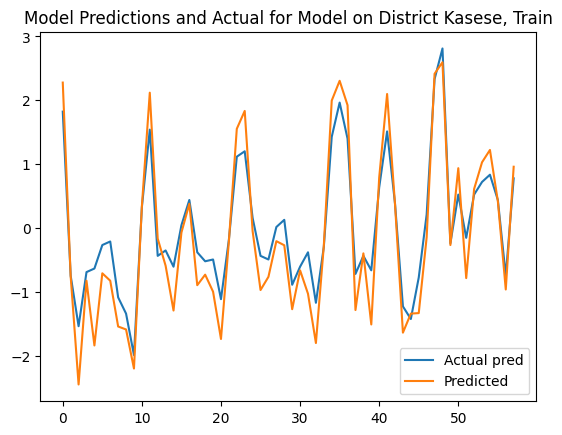

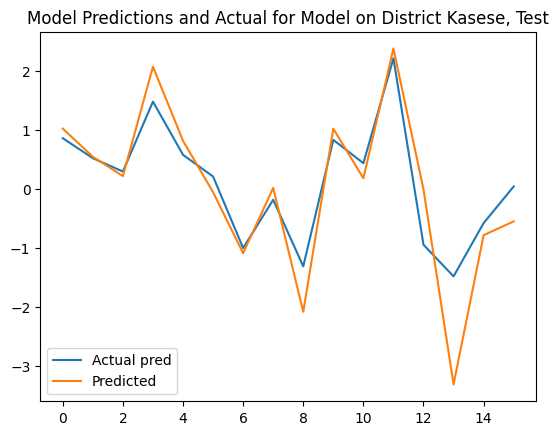

In [40]:
train_and_plot(kasese_train_dataloader, kasese_test_dataloader, kasese_dict, "Kasese")

*************Model For District Kabale
Epoch 0: train MSE 11.6481, test MSE 2.4040, train RMSE 3.4129, test RMSE 1.5505
Epoch 10: train MSE 11.3161, test MSE 2.1842, train RMSE 3.3639, test RMSE 1.4779
Epoch 20: train MSE 6.7871, test MSE 1.0898, train RMSE 2.6052, test RMSE 1.0439
Epoch 30: train MSE 5.0841, test MSE 0.2859, train RMSE 2.2548, test RMSE 0.5347
Epoch 40: train MSE 1.6371, test MSE 0.5670, train RMSE 1.2795, test RMSE 0.7530
Epoch 50: train MSE 0.3882, test MSE 0.0860, train RMSE 0.6230, test RMSE 0.2932
Epoch 60: train MSE 2.3713, test MSE 0.9565, train RMSE 1.5399, test RMSE 0.9780
Epoch 70: train MSE 2.0705, test MSE 0.6462, train RMSE 1.4389, test RMSE 0.8039
Epoch 80: train MSE 1.3119, test MSE 0.3734, train RMSE 1.1454, test RMSE 0.6111
Epoch 90: train MSE 1.7253, test MSE 0.3651, train RMSE 1.3135, test RMSE 0.6043


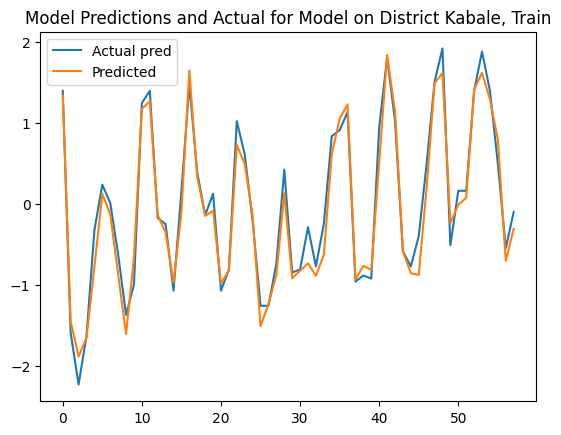

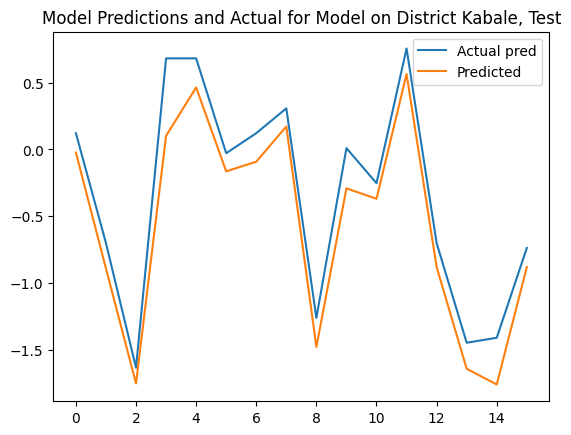

In [41]:
train_and_plot(kabale_train_dataloader, kabale_test_dataloader, kabale_dict, "Kabale")

## Testing with Lookback = 4

In [42]:
lookback = 4
batch = 5

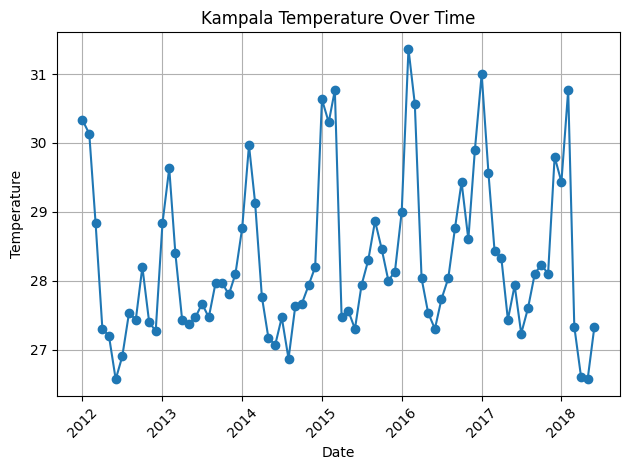

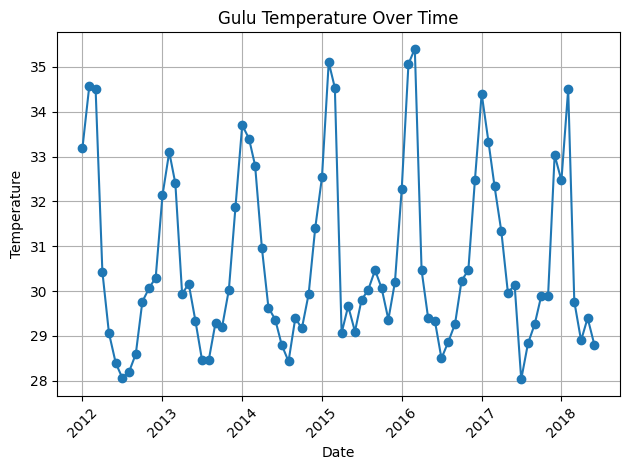

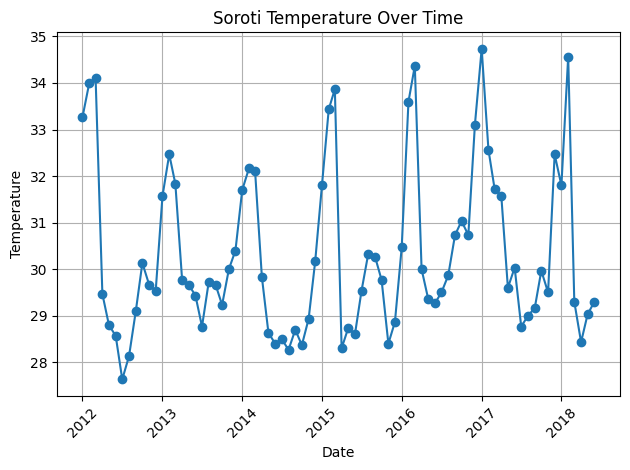

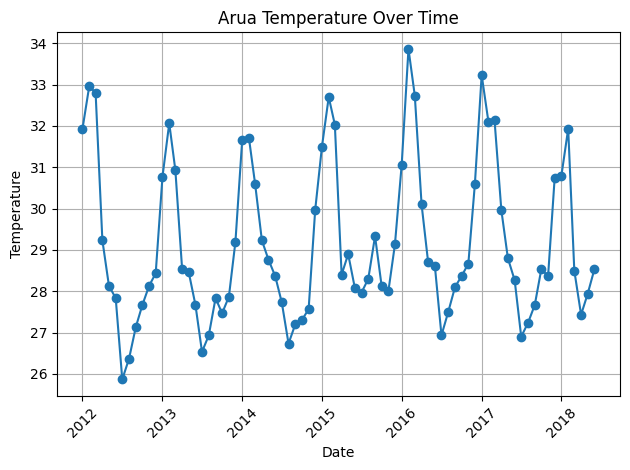

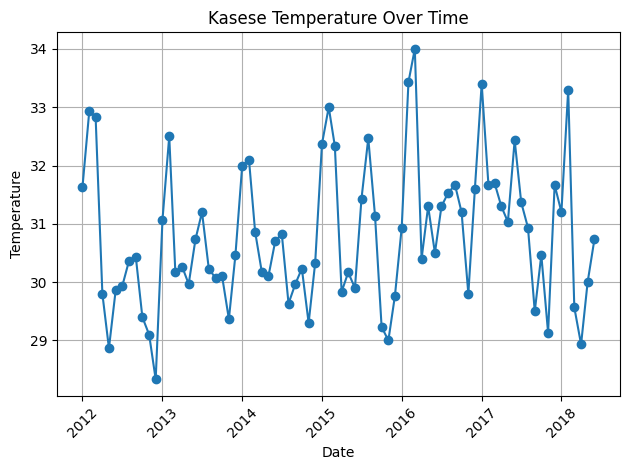

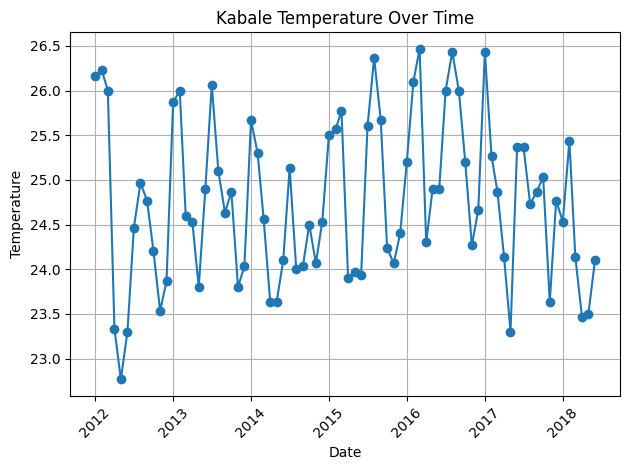

In [43]:
kampala_train_dataloader, kampale_test_dataloader, kampala_dict = create_series_dataloader_on_district('Kampala')
gulu_train_dataloader, gulu_test_dataloader, gulu_dict = create_series_dataloader_on_district('Gulu')
soroti_train_dataloader, soroti_test_dataloader, soroti_dict = create_series_dataloader_on_district('Soroti')
arua_train_dataloader, arua_test_dataloader, arua_dict = create_series_dataloader_on_district('Arua')
kasese_train_dataloader, kasese_test_dataloader, kasese_dict = create_series_dataloader_on_district('Kasese')
kabale_train_dataloader, kabale_test_dataloader, kabale_dict = create_series_dataloader_on_district('Kabale')

*************Model For District Kampala
Epoch 0: train MSE 11.3894, test MSE 3.0480, train RMSE 3.3748, test RMSE 1.7458
Epoch 10: train MSE 11.1359, test MSE 2.6093, train RMSE 3.3370, test RMSE 1.6153
Epoch 20: train MSE 8.9840, test MSE 2.3316, train RMSE 2.9973, test RMSE 1.5270
Epoch 30: train MSE 3.5979, test MSE 0.9962, train RMSE 1.8968, test RMSE 0.9981
Epoch 40: train MSE 3.3876, test MSE 0.7103, train RMSE 1.8405, test RMSE 0.8428
Epoch 50: train MSE 1.5965, test MSE 0.3734, train RMSE 1.2635, test RMSE 0.6111
Epoch 60: train MSE 2.5438, test MSE 0.6351, train RMSE 1.5949, test RMSE 0.7969
Epoch 70: train MSE 2.9757, test MSE 0.9774, train RMSE 1.7250, test RMSE 0.9886
Epoch 80: train MSE 2.4798, test MSE 0.4915, train RMSE 1.5747, test RMSE 0.7011
Epoch 90: train MSE 2.2264, test MSE 0.8274, train RMSE 1.4921, test RMSE 0.9096


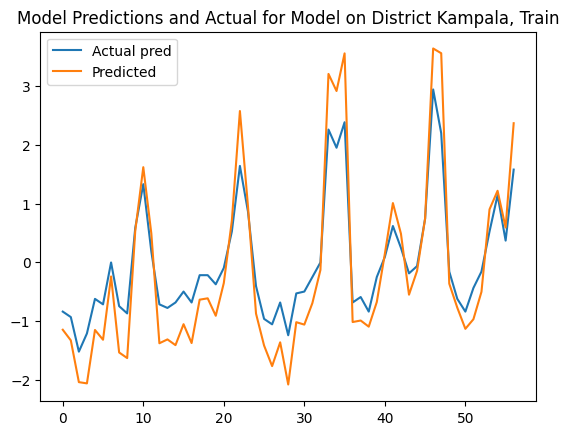

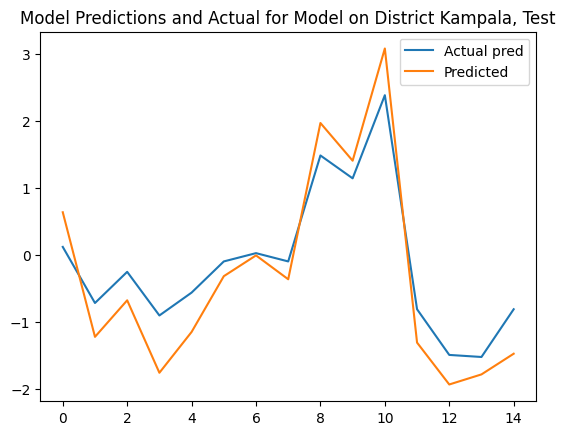

In [44]:
train_and_plot(kampala_train_dataloader, kampale_test_dataloader, kampala_dict, "Kampala")

*************Model For District Gulu
Epoch 0: train MSE 11.1977, test MSE 2.3559, train RMSE 3.3463, test RMSE 1.5349
Epoch 10: train MSE 11.7160, test MSE 2.7349, train RMSE 3.4229, test RMSE 1.6537
Epoch 20: train MSE 2.1070, test MSE 2.1037, train RMSE 1.4515, test RMSE 1.4504
Epoch 30: train MSE 3.1019, test MSE 0.5835, train RMSE 1.7612, test RMSE 0.7639
Epoch 40: train MSE 2.5874, test MSE 0.4530, train RMSE 1.6085, test RMSE 0.6731
Epoch 50: train MSE 2.7298, test MSE 0.6010, train RMSE 1.6522, test RMSE 0.7752
Epoch 60: train MSE 1.9596, test MSE 0.8531, train RMSE 1.3999, test RMSE 0.9236
Epoch 70: train MSE 4.3967, test MSE 0.7391, train RMSE 2.0968, test RMSE 0.8597
Epoch 80: train MSE 2.8401, test MSE 0.8027, train RMSE 1.6853, test RMSE 0.8959
Epoch 90: train MSE 2.1791, test MSE 0.6277, train RMSE 1.4762, test RMSE 0.7923


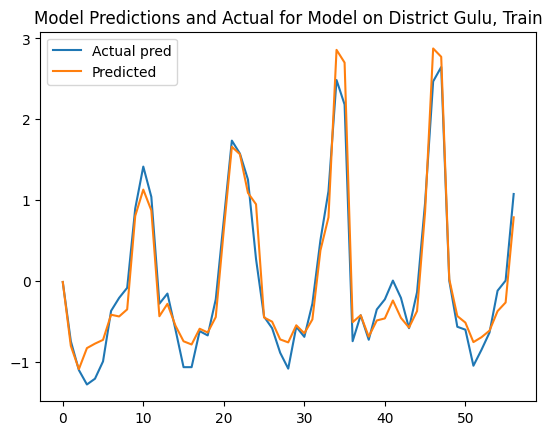

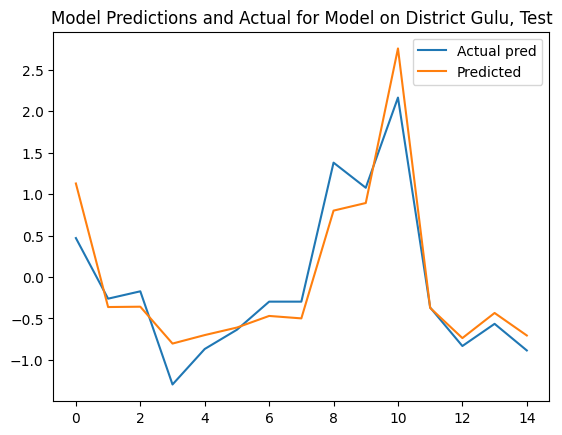

In [45]:
train_and_plot(gulu_train_dataloader, gulu_test_dataloader, gulu_dict, "Gulu")

*************Model For District Soroti
Epoch 0: train MSE 11.2091, test MSE 3.0178, train RMSE 3.3480, test RMSE 1.7372
Epoch 10: train MSE 10.9989, test MSE 2.9503, train RMSE 3.3165, test RMSE 1.7176
Epoch 20: train MSE 7.5604, test MSE 2.2124, train RMSE 2.7496, test RMSE 1.4874
Epoch 30: train MSE 6.0734, test MSE 1.3356, train RMSE 2.4644, test RMSE 1.1557
Epoch 40: train MSE 1.4918, test MSE 0.8075, train RMSE 1.2214, test RMSE 0.8986
Epoch 50: train MSE 3.0448, test MSE 0.8423, train RMSE 1.7449, test RMSE 0.9177
Epoch 60: train MSE 2.4507, test MSE 1.1843, train RMSE 1.5655, test RMSE 1.0882
Epoch 70: train MSE 1.4860, test MSE 1.1888, train RMSE 1.2190, test RMSE 1.0903
Epoch 80: train MSE 1.5612, test MSE 1.2067, train RMSE 1.2495, test RMSE 1.0985
Epoch 90: train MSE 0.8028, test MSE 0.6986, train RMSE 0.8960, test RMSE 0.8358


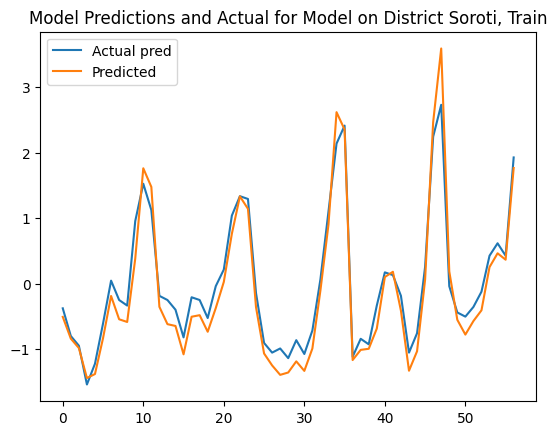

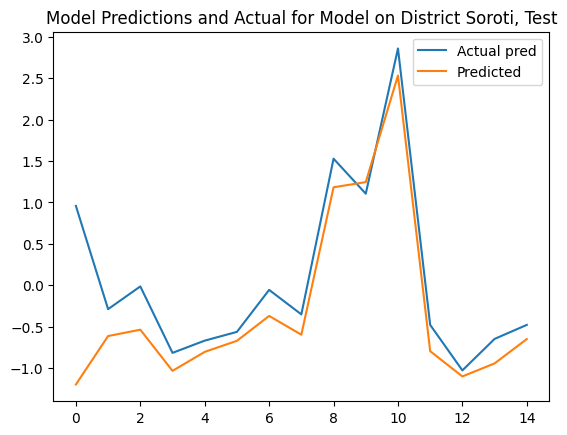

In [46]:
train_and_plot(soroti_train_dataloader, soroti_test_dataloader, soroti_dict, "Soroti")

*************Model For District Arua
Epoch 0: train MSE 11.1714, test MSE 1.6987, train RMSE 3.3424, test RMSE 1.3033
Epoch 10: train MSE 9.4807, test MSE 1.3882, train RMSE 3.0791, test RMSE 1.1782
Epoch 20: train MSE 6.1292, test MSE 0.7804, train RMSE 2.4757, test RMSE 0.8834
Epoch 30: train MSE 4.1600, test MSE 0.6650, train RMSE 2.0396, test RMSE 0.8155
Epoch 40: train MSE 4.6607, test MSE 0.4176, train RMSE 2.1589, test RMSE 0.6462
Epoch 50: train MSE 2.5795, test MSE 0.3888, train RMSE 1.6061, test RMSE 0.6235
Epoch 60: train MSE 6.9743, test MSE 1.3500, train RMSE 2.6409, test RMSE 1.1619
Epoch 70: train MSE 4.5511, test MSE 1.3780, train RMSE 2.1333, test RMSE 1.1739
Epoch 80: train MSE 2.2402, test MSE 0.5369, train RMSE 1.4967, test RMSE 0.7327
Epoch 90: train MSE 2.0748, test MSE 0.4447, train RMSE 1.4404, test RMSE 0.6668


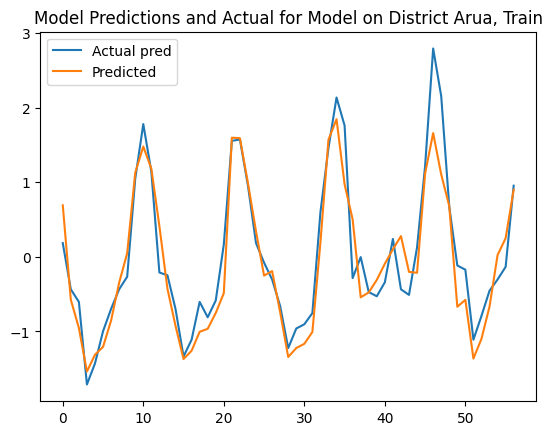

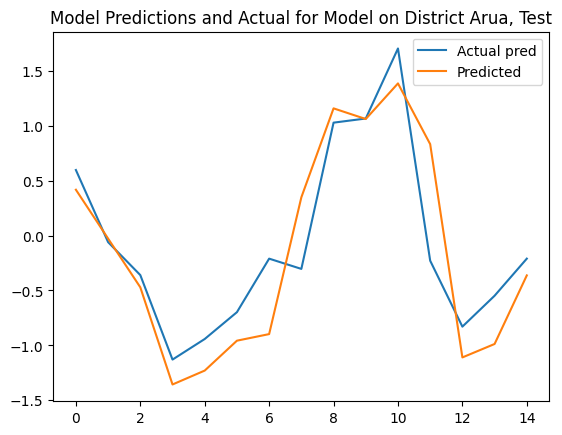

In [47]:
train_and_plot(arua_train_dataloader, arua_test_dataloader, arua_dict, "Arua")

*************Model For District Kasese
Epoch 0: train MSE 11.1819, test MSE 2.9229, train RMSE 3.3439, test RMSE 1.7097
Epoch 10: train MSE 10.5562, test MSE 2.7188, train RMSE 3.2490, test RMSE 1.6489
Epoch 20: train MSE 10.9697, test MSE 2.4790, train RMSE 3.3121, test RMSE 1.5745
Epoch 30: train MSE 5.3823, test MSE 1.4524, train RMSE 2.3200, test RMSE 1.2051
Epoch 40: train MSE 2.2869, test MSE 0.8175, train RMSE 1.5122, test RMSE 0.9041
Epoch 50: train MSE 3.7574, test MSE 0.4536, train RMSE 1.9384, test RMSE 0.6735
Epoch 60: train MSE 2.9201, test MSE 1.0470, train RMSE 1.7088, test RMSE 1.0232
Epoch 70: train MSE 2.2050, test MSE 1.2259, train RMSE 1.4849, test RMSE 1.1072
Epoch 80: train MSE 1.7507, test MSE 1.1080, train RMSE 1.3231, test RMSE 1.0526
Epoch 90: train MSE 0.9831, test MSE 0.4944, train RMSE 0.9915, test RMSE 0.7032


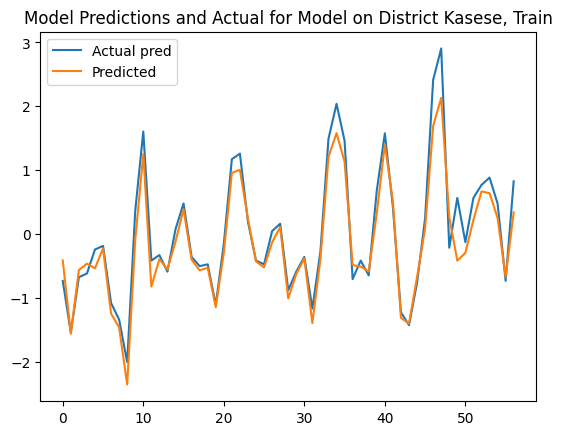

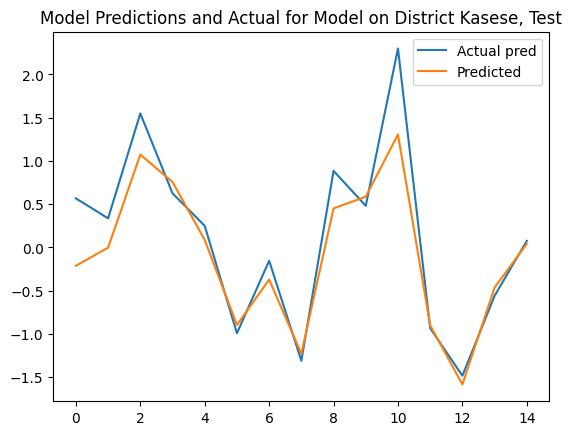

In [48]:
train_and_plot(kasese_train_dataloader, kasese_test_dataloader, kasese_dict, "Kasese")

*************Model For District Kabale
Epoch 0: train MSE 11.4265, test MSE 2.2858, train RMSE 3.3803, test RMSE 1.5119
Epoch 10: train MSE 8.8015, test MSE 2.1749, train RMSE 2.9667, test RMSE 1.4748
Epoch 20: train MSE 8.3521, test MSE 2.3501, train RMSE 2.8900, test RMSE 1.5330
Epoch 30: train MSE 5.3827, test MSE 0.4932, train RMSE 2.3201, test RMSE 0.7023
Epoch 40: train MSE 4.8120, test MSE 0.9926, train RMSE 2.1936, test RMSE 0.9963
Epoch 50: train MSE 2.2313, test MSE 1.0009, train RMSE 1.4938, test RMSE 1.0004
Epoch 60: train MSE 2.2173, test MSE 0.6469, train RMSE 1.4891, test RMSE 0.8043
Epoch 70: train MSE 1.8280, test MSE 0.9512, train RMSE 1.3520, test RMSE 0.9753
Epoch 80: train MSE 1.1243, test MSE 0.5093, train RMSE 1.0603, test RMSE 0.7137
Epoch 90: train MSE 1.2538, test MSE 0.5039, train RMSE 1.1197, test RMSE 0.7099


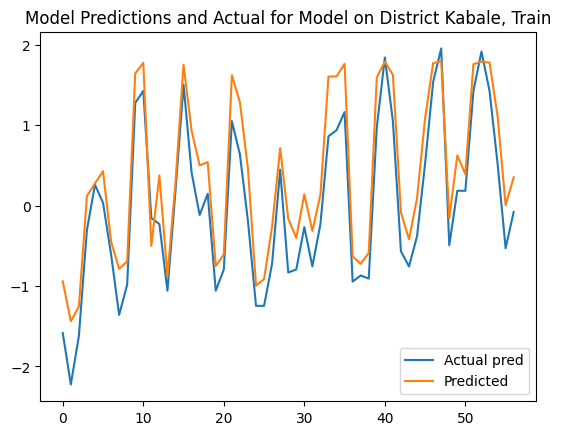

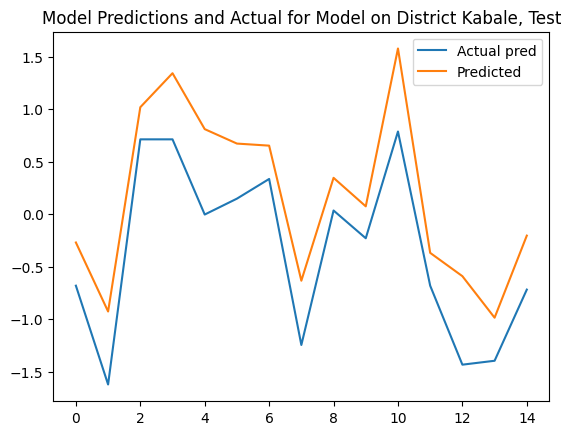

In [49]:
train_and_plot(kabale_train_dataloader, kabale_test_dataloader, kabale_dict, "Kabale")

## Testing with Lookback = 5

In [50]:
lookback = 5
batch = 5

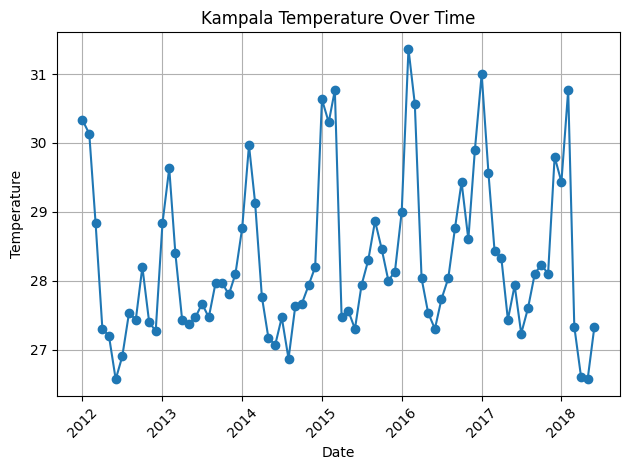

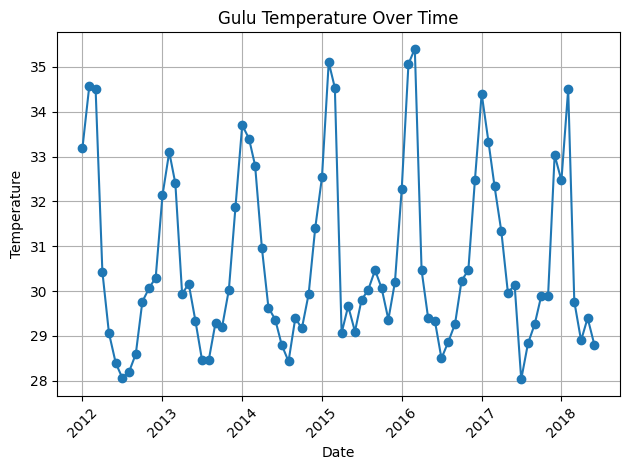

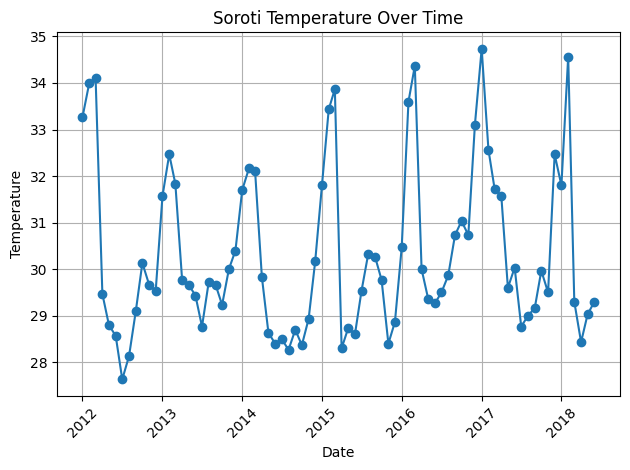

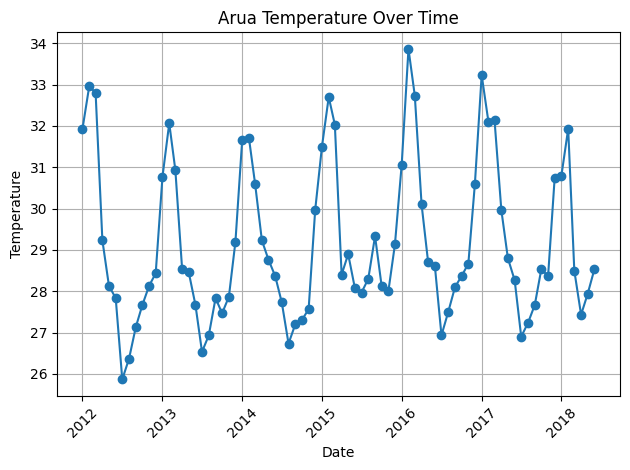

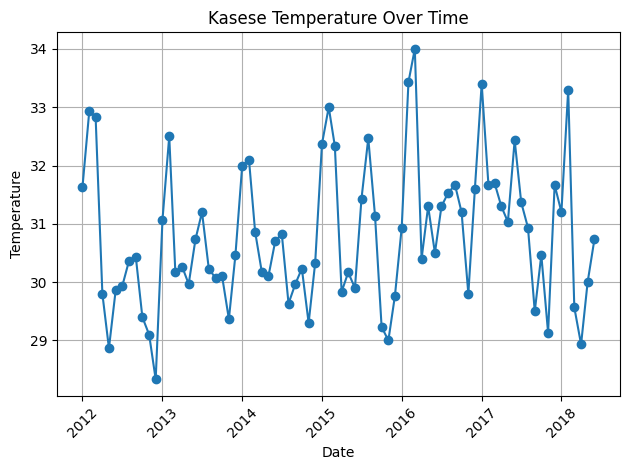

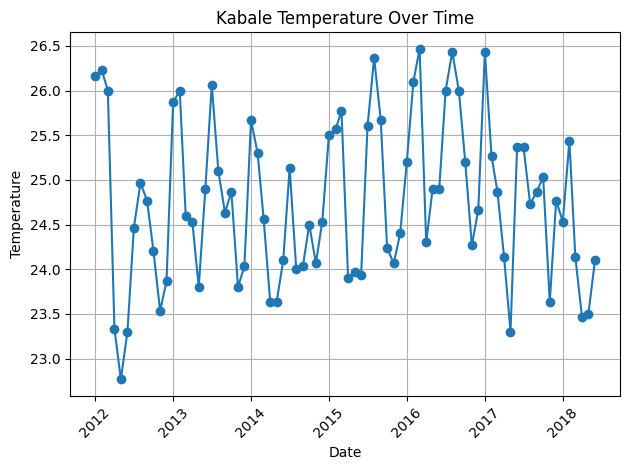

In [51]:
kampala_train_dataloader, kampale_test_dataloader, kampala_dict = create_series_dataloader_on_district('Kampala')
gulu_train_dataloader, gulu_test_dataloader, gulu_dict = create_series_dataloader_on_district('Gulu')
soroti_train_dataloader, soroti_test_dataloader, soroti_dict = create_series_dataloader_on_district('Soroti')
arua_train_dataloader, arua_test_dataloader, arua_dict = create_series_dataloader_on_district('Arua')
kasese_train_dataloader, kasese_test_dataloader, kasese_dict = create_series_dataloader_on_district('Kasese')
kabale_train_dataloader, kabale_test_dataloader, kabale_dict = create_series_dataloader_on_district('Kabale')

*************Model For District Kampala
Epoch 0: train MSE 11.0242, test MSE 3.2891, train RMSE 3.3203, test RMSE 1.8136
Epoch 10: train MSE 16.1365, test MSE 3.3710, train RMSE 4.0170, test RMSE 1.8360
Epoch 20: train MSE 4.6175, test MSE 1.1733, train RMSE 2.1488, test RMSE 1.0832
Epoch 30: train MSE 4.0267, test MSE 0.7361, train RMSE 2.0067, test RMSE 0.8580
Epoch 40: train MSE 2.1622, test MSE 0.6060, train RMSE 1.4704, test RMSE 0.7785
Epoch 50: train MSE 1.8565, test MSE 0.4560, train RMSE 1.3625, test RMSE 0.6753
Epoch 60: train MSE 1.5019, test MSE 0.4073, train RMSE 1.2255, test RMSE 0.6382
Epoch 70: train MSE 0.7307, test MSE 0.2162, train RMSE 0.8548, test RMSE 0.4650
Epoch 80: train MSE 0.7597, test MSE 0.2260, train RMSE 0.8716, test RMSE 0.4754
Epoch 90: train MSE 0.8769, test MSE 0.3491, train RMSE 0.9364, test RMSE 0.5908


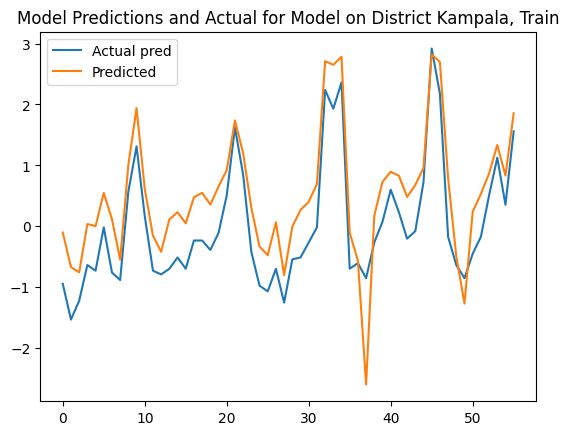

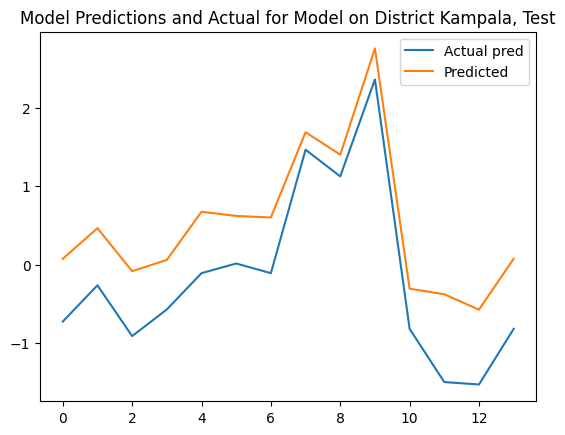

In [52]:
train_and_plot(kampala_train_dataloader, kampale_test_dataloader, kampala_dict, "Kampala")

*************Model For District Gulu
Epoch 0: train MSE 11.1071, test MSE 2.3415, train RMSE 3.3327, test RMSE 1.5302
Epoch 10: train MSE 12.3174, test MSE 2.2537, train RMSE 3.5096, test RMSE 1.5012
Epoch 20: train MSE 46.7213, test MSE 4.7936, train RMSE 6.8353, test RMSE 2.1894
Epoch 30: train MSE 14.2280, test MSE 2.1880, train RMSE 3.7720, test RMSE 1.4792
Epoch 40: train MSE 4.9122, test MSE 1.0952, train RMSE 2.2163, test RMSE 1.0465
Epoch 50: train MSE 2.9193, test MSE 0.6598, train RMSE 1.7086, test RMSE 0.8123
Epoch 60: train MSE 1.1019, test MSE 0.3809, train RMSE 1.0497, test RMSE 0.6172
Epoch 70: train MSE 3.6322, test MSE 1.1127, train RMSE 1.9058, test RMSE 1.0548
Epoch 80: train MSE 4.7581, test MSE 1.2711, train RMSE 2.1813, test RMSE 1.1275
Epoch 90: train MSE 4.8566, test MSE 1.4483, train RMSE 2.2038, test RMSE 1.2035


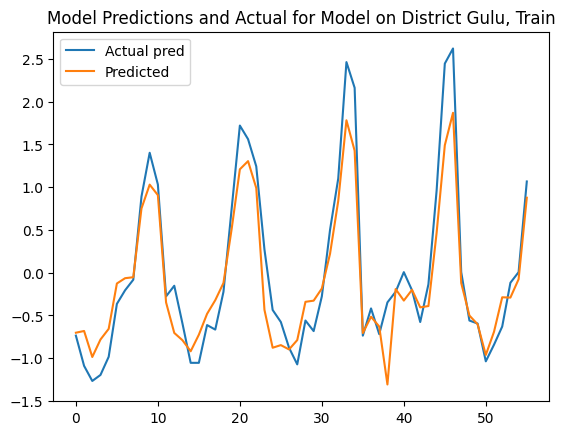

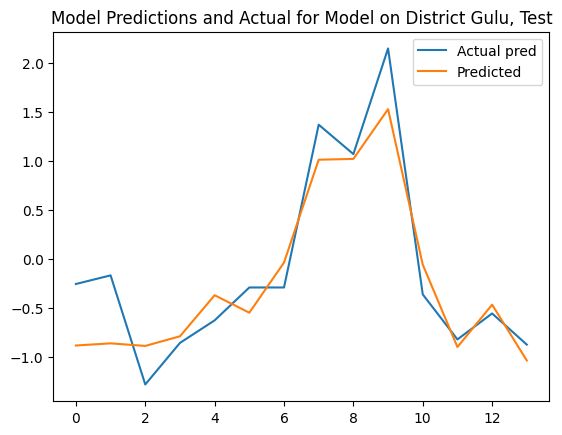

In [53]:
train_and_plot(gulu_train_dataloader, gulu_test_dataloader, gulu_dict, "Gulu")

*************Model For District Soroti
Epoch 0: train MSE 11.2490, test MSE 2.9681, train RMSE 3.3540, test RMSE 1.7228
Epoch 10: train MSE 17.2399, test MSE 3.3654, train RMSE 4.1521, test RMSE 1.8345
Epoch 20: train MSE 8.8354, test MSE 3.0070, train RMSE 2.9724, test RMSE 1.7341
Epoch 30: train MSE 2.2342, test MSE 0.8701, train RMSE 1.4947, test RMSE 0.9328
Epoch 40: train MSE 5.8990, test MSE 1.4451, train RMSE 2.4288, test RMSE 1.2021
Epoch 50: train MSE 2.6483, test MSE 1.0398, train RMSE 1.6274, test RMSE 1.0197
Epoch 60: train MSE 1.7794, test MSE 0.5980, train RMSE 1.3339, test RMSE 0.7733
Epoch 70: train MSE 1.5723, test MSE 0.5823, train RMSE 1.2539, test RMSE 0.7631
Epoch 80: train MSE 3.1291, test MSE 0.7034, train RMSE 1.7689, test RMSE 0.8387
Epoch 90: train MSE 0.9144, test MSE 0.2771, train RMSE 0.9562, test RMSE 0.5264


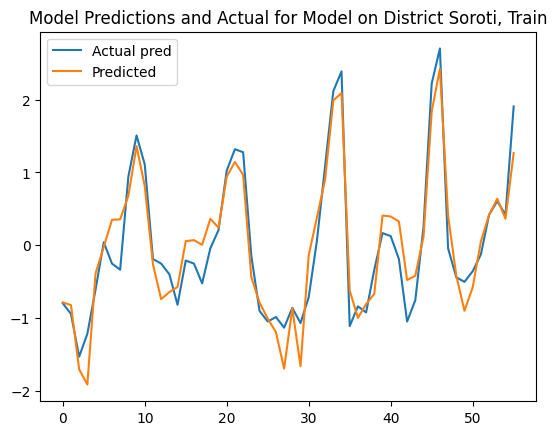

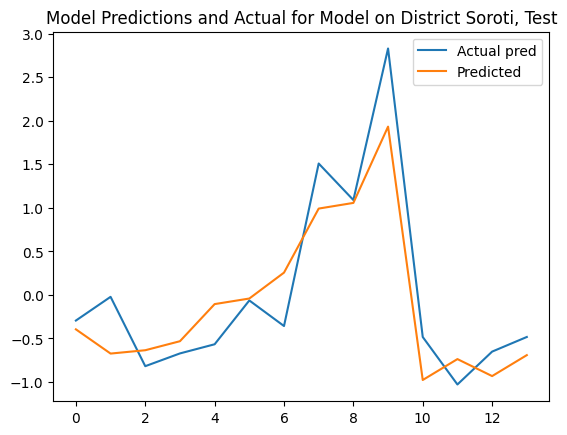

In [54]:
train_and_plot(soroti_train_dataloader, soroti_test_dataloader, soroti_dict, "Soroti")

*************Model For District Arua
Epoch 0: train MSE 11.2723, test MSE 1.6519, train RMSE 3.3574, test RMSE 1.2853
Epoch 10: train MSE 5.9622, test MSE 0.9707, train RMSE 2.4418, test RMSE 0.9852
Epoch 20: train MSE 36.7863, test MSE 6.7441, train RMSE 6.0652, test RMSE 2.5969
Epoch 30: train MSE 105.8233, test MSE 12.0600, train RMSE 10.2870, test RMSE 3.4727
Epoch 40: train MSE 7.3197, test MSE 2.5385, train RMSE 2.7055, test RMSE 1.5933
Epoch 50: train MSE 1.3231, test MSE 0.2988, train RMSE 1.1503, test RMSE 0.5467
Epoch 60: train MSE 2.2449, test MSE 0.5401, train RMSE 1.4983, test RMSE 0.7349
Epoch 70: train MSE 2.1292, test MSE 0.1672, train RMSE 1.4592, test RMSE 0.4089
Epoch 80: train MSE 2.3621, test MSE 0.7554, train RMSE 1.5369, test RMSE 0.8691
Epoch 90: train MSE 2.2605, test MSE 0.6708, train RMSE 1.5035, test RMSE 0.8190


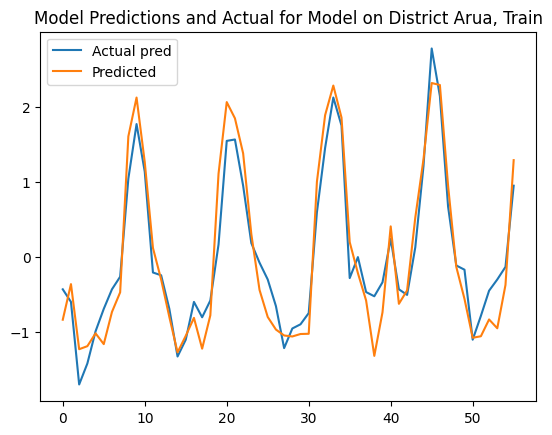

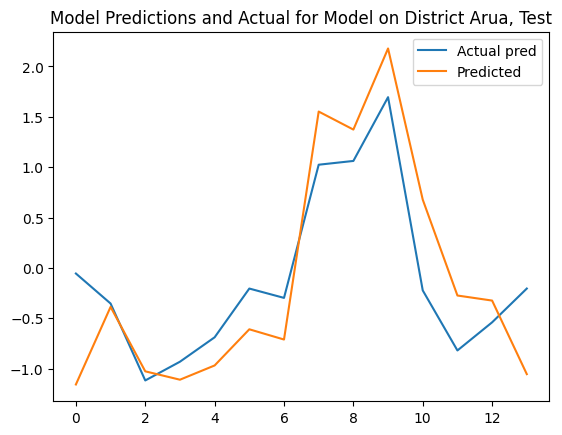

In [55]:
train_and_plot(arua_train_dataloader, arua_test_dataloader, arua_dict, "Arua")

*************Model For District Kasese
Epoch 0: train MSE 12.0041, test MSE 3.2057, train RMSE 3.4647, test RMSE 1.7904
Epoch 10: train MSE 9.0911, test MSE 3.4945, train RMSE 3.0151, test RMSE 1.8694
Epoch 20: train MSE 6.9473, test MSE 2.9053, train RMSE 2.6358, test RMSE 1.7045
Epoch 30: train MSE 5.5759, test MSE 1.3932, train RMSE 2.3613, test RMSE 1.1803
Epoch 40: train MSE 2.0191, test MSE 0.9042, train RMSE 1.4210, test RMSE 0.9509
Epoch 50: train MSE 2.3054, test MSE 1.2032, train RMSE 1.5184, test RMSE 1.0969
Epoch 60: train MSE 3.4307, test MSE 1.1034, train RMSE 1.8522, test RMSE 1.0504
Epoch 70: train MSE 2.9504, test MSE 1.3435, train RMSE 1.7177, test RMSE 1.1591
Epoch 80: train MSE 1.1935, test MSE 0.5126, train RMSE 1.0925, test RMSE 0.7159
Epoch 90: train MSE 1.6339, test MSE 1.0734, train RMSE 1.2782, test RMSE 1.0360


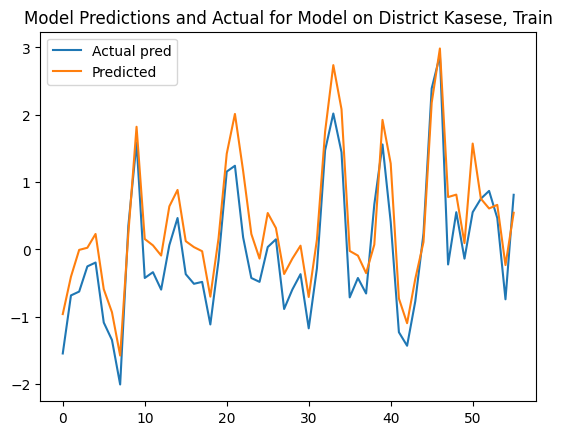

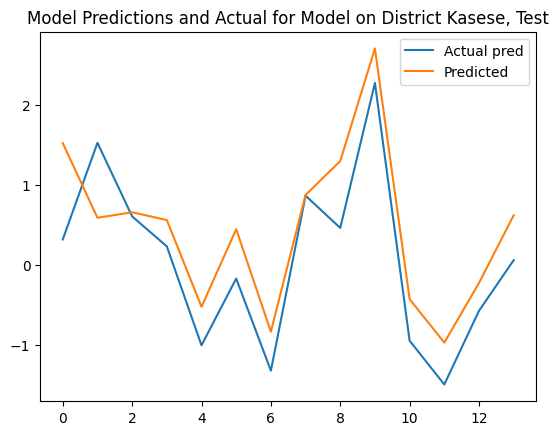

In [56]:
train_and_plot(kasese_train_dataloader, kasese_test_dataloader, kasese_dict, "Kasese")

*************Model For District Kabale
Epoch 0: train MSE 11.2846, test MSE 2.4380, train RMSE 3.3593, test RMSE 1.5614
Epoch 10: train MSE 7.9041, test MSE 1.8180, train RMSE 2.8114, test RMSE 1.3483
Epoch 20: train MSE 11.4368, test MSE 2.0378, train RMSE 3.3818, test RMSE 1.4275
Epoch 30: train MSE 6.4179, test MSE 1.4300, train RMSE 2.5334, test RMSE 1.1958
Epoch 40: train MSE 5.3193, test MSE 1.4754, train RMSE 2.3064, test RMSE 1.2147
Epoch 50: train MSE 2.8495, test MSE 0.2347, train RMSE 1.6880, test RMSE 0.4844
Epoch 60: train MSE 1.5802, test MSE 0.3769, train RMSE 1.2571, test RMSE 0.6139
Epoch 70: train MSE 0.9817, test MSE 0.1745, train RMSE 0.9908, test RMSE 0.4177
Epoch 80: train MSE 1.6128, test MSE 0.1916, train RMSE 1.2700, test RMSE 0.4377
Epoch 90: train MSE 3.2472, test MSE 0.8438, train RMSE 1.8020, test RMSE 0.9186


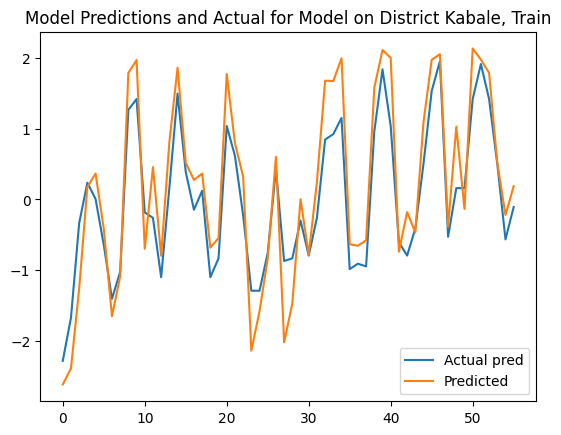

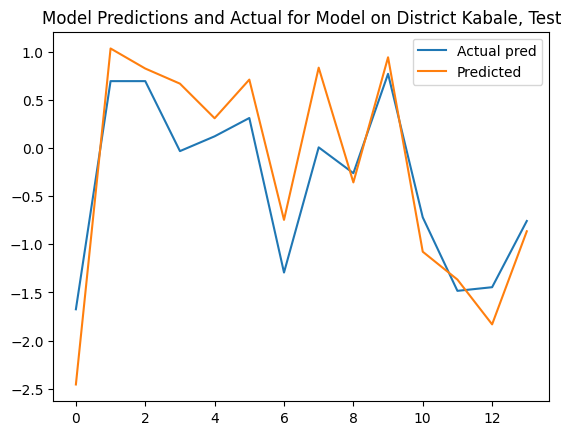

In [57]:
train_and_plot(kabale_train_dataloader, kabale_test_dataloader, kabale_dict, "Kabale")

## Testing with Lookback = 6

In [58]:
lookback = 6
batch = 5

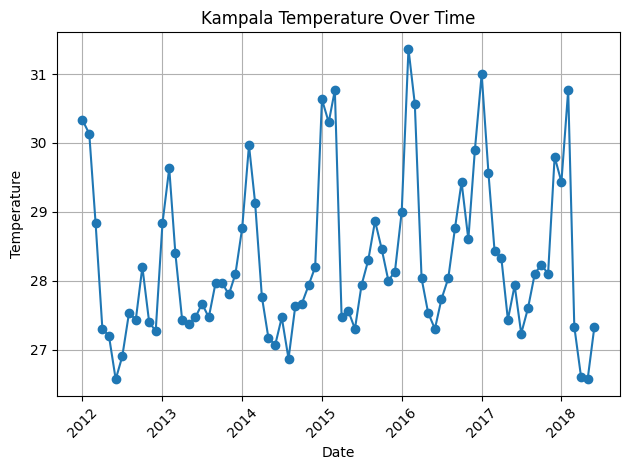

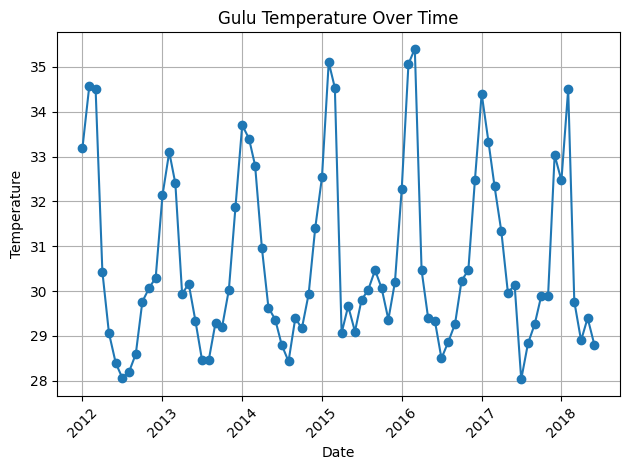

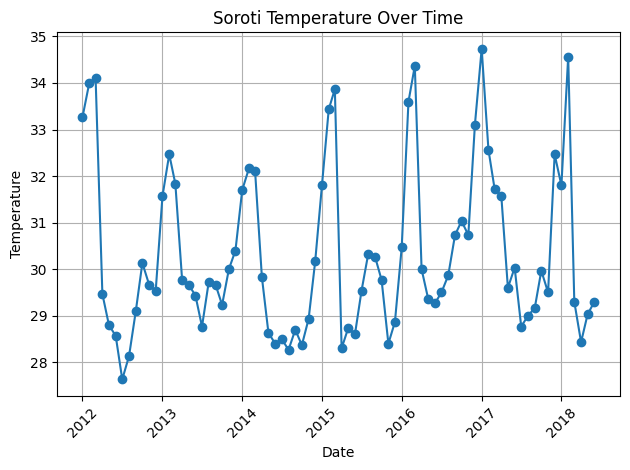

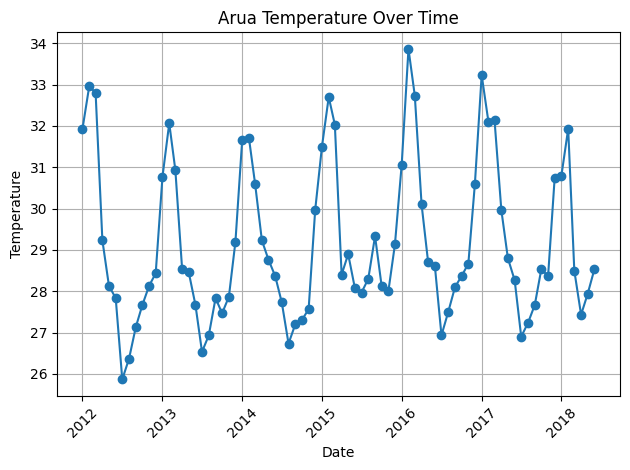

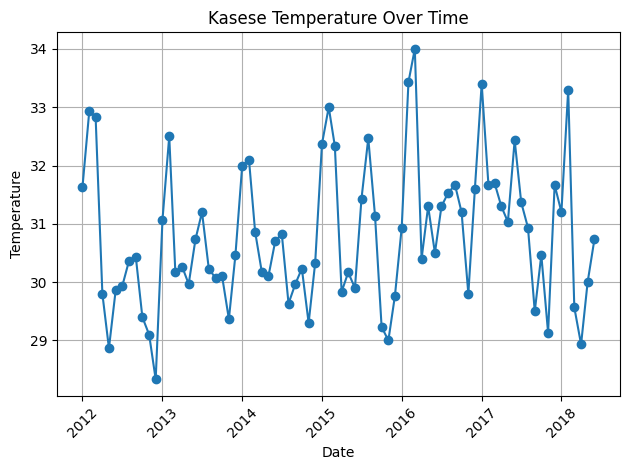

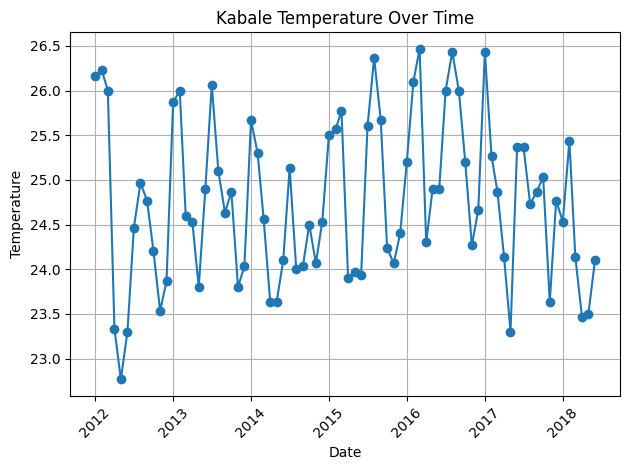

In [59]:
kampala_train_dataloader, kampale_test_dataloader, kampala_dict = create_series_dataloader_on_district('Kampala')
gulu_train_dataloader, gulu_test_dataloader, gulu_dict = create_series_dataloader_on_district('Gulu')
soroti_train_dataloader, soroti_test_dataloader, soroti_dict = create_series_dataloader_on_district('Soroti')
arua_train_dataloader, arua_test_dataloader, arua_dict = create_series_dataloader_on_district('Arua')
kasese_train_dataloader, kasese_test_dataloader, kasese_dict = create_series_dataloader_on_district('Kasese')
kabale_train_dataloader, kabale_test_dataloader, kabale_dict = create_series_dataloader_on_district('Kabale')

*************Model For District Kampala
Epoch 0: train MSE 11.0052, test MSE 3.5484, train RMSE 3.3174, test RMSE 1.8837
Epoch 10: train MSE 19.2147, test MSE 4.4832, train RMSE 4.3835, test RMSE 2.1174
Epoch 20: train MSE 10.7824, test MSE 3.0475, train RMSE 3.2837, test RMSE 1.7457
Epoch 30: train MSE 8.2589, test MSE 2.4506, train RMSE 2.8738, test RMSE 1.5654
Epoch 40: train MSE 4.8512, test MSE 1.5507, train RMSE 2.2025, test RMSE 1.2453
Epoch 50: train MSE 4.1713, test MSE 1.8864, train RMSE 2.0424, test RMSE 1.3735
Epoch 60: train MSE 2.3352, test MSE 0.9208, train RMSE 1.5281, test RMSE 0.9596
Epoch 70: train MSE 2.0244, test MSE 0.6834, train RMSE 1.4228, test RMSE 0.8267
Epoch 80: train MSE 1.5093, test MSE 0.8431, train RMSE 1.2285, test RMSE 0.9182
Epoch 90: train MSE 1.5800, test MSE 0.6261, train RMSE 1.2570, test RMSE 0.7913


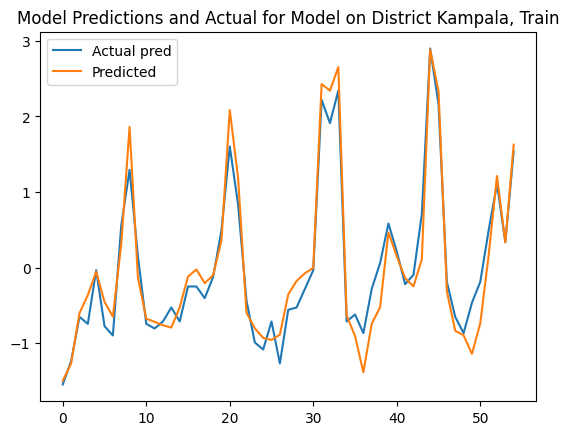

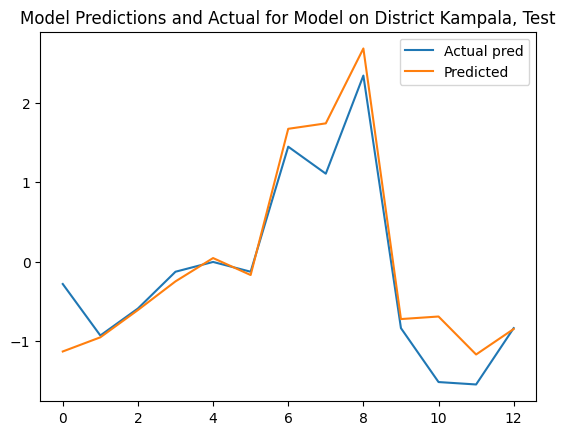

In [60]:
train_and_plot(kampala_train_dataloader, kampale_test_dataloader, kampala_dict, "Kampala")

*************Model For District Gulu
Epoch 0: train MSE 10.6238, test MSE 2.4626, train RMSE 3.2594, test RMSE 1.5693
Epoch 10: train MSE 9.0555, test MSE 2.6829, train RMSE 3.0092, test RMSE 1.6379
Epoch 20: train MSE 8.4988, test MSE 1.7084, train RMSE 2.9153, test RMSE 1.3071
Epoch 30: train MSE 4.9590, test MSE 1.6950, train RMSE 2.2269, test RMSE 1.3019
Epoch 40: train MSE 4.9787, test MSE 1.3815, train RMSE 2.2313, test RMSE 1.1754
Epoch 50: train MSE 3.4667, test MSE 0.6608, train RMSE 1.8619, test RMSE 0.8129
Epoch 60: train MSE 6.3024, test MSE 1.2397, train RMSE 2.5105, test RMSE 1.1134
Epoch 70: train MSE 2.7382, test MSE 0.7784, train RMSE 1.6548, test RMSE 0.8823
Epoch 80: train MSE 2.4436, test MSE 0.7639, train RMSE 1.5632, test RMSE 0.8740
Epoch 90: train MSE 3.1478, test MSE 1.2007, train RMSE 1.7742, test RMSE 1.0958


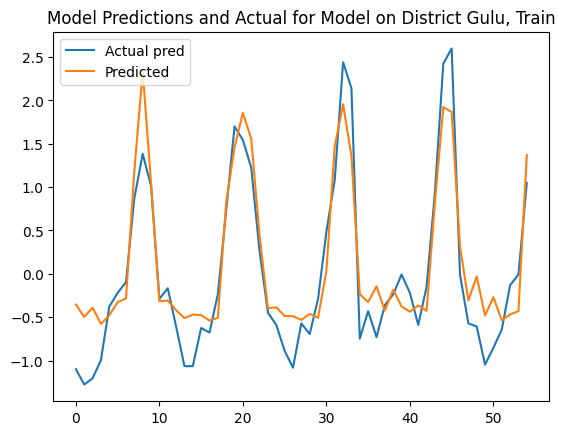

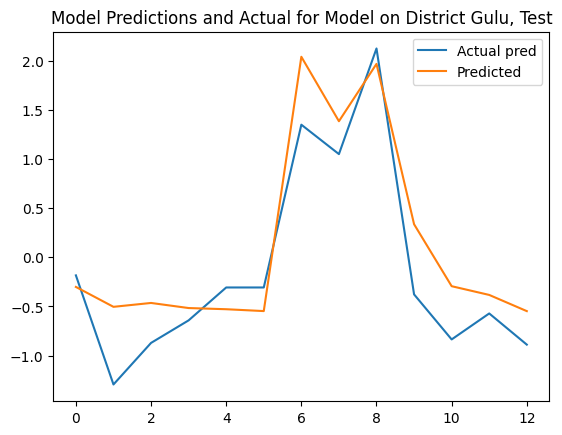

In [61]:
train_and_plot(gulu_train_dataloader, gulu_test_dataloader, gulu_dict, "Gulu")

*************Model For District Soroti
Epoch 0: train MSE 10.7659, test MSE 2.9619, train RMSE 3.2812, test RMSE 1.7210
Epoch 10: train MSE 6.5924, test MSE 2.2844, train RMSE 2.5676, test RMSE 1.5114
Epoch 20: train MSE 5.5776, test MSE 3.6532, train RMSE 2.3617, test RMSE 1.9113
Epoch 30: train MSE 8.5503, test MSE 2.4217, train RMSE 2.9241, test RMSE 1.5562
Epoch 40: train MSE 9.4328, test MSE 1.9007, train RMSE 3.0713, test RMSE 1.3787
Epoch 50: train MSE 1.8205, test MSE 1.3963, train RMSE 1.3493, test RMSE 1.1817
Epoch 60: train MSE 29.9023, test MSE 9.3745, train RMSE 5.4683, test RMSE 3.0618
Epoch 70: train MSE 38.4314, test MSE 11.4987, train RMSE 6.1993, test RMSE 3.3910
Epoch 80: train MSE 26.7591, test MSE 7.6093, train RMSE 5.1729, test RMSE 2.7585
Epoch 90: train MSE 5.9740, test MSE 0.9624, train RMSE 2.4442, test RMSE 0.9810


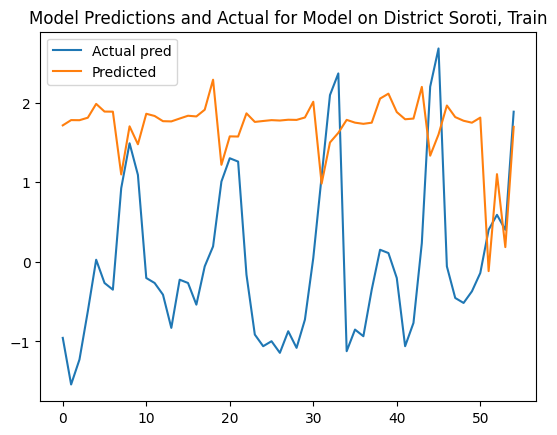

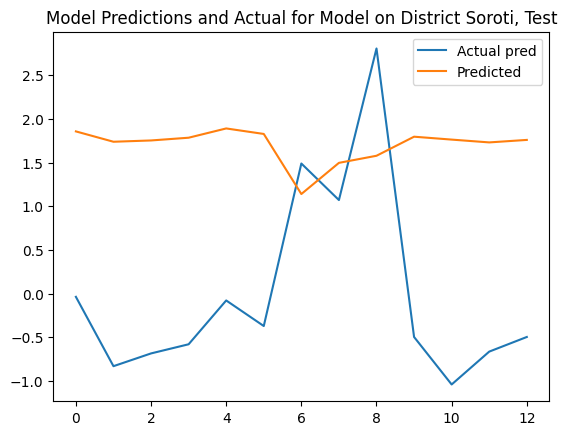

In [62]:
train_and_plot(soroti_train_dataloader, soroti_test_dataloader, soroti_dict, "Soroti")

*************Model For District Arua
Epoch 0: train MSE 10.5611, test MSE 1.6811, train RMSE 3.2498, test RMSE 1.2966
Epoch 10: train MSE 10.8447, test MSE 1.8981, train RMSE 3.2931, test RMSE 1.3777
Epoch 20: train MSE 6.1799, test MSE 0.8577, train RMSE 2.4859, test RMSE 0.9261
Epoch 30: train MSE 3.8769, test MSE 1.9311, train RMSE 1.9690, test RMSE 1.3896
Epoch 40: train MSE 2.9287, test MSE 0.8560, train RMSE 1.7114, test RMSE 0.9252
Epoch 50: train MSE 1.2251, test MSE 0.2328, train RMSE 1.1069, test RMSE 0.4825
Epoch 60: train MSE 2.5197, test MSE 0.6754, train RMSE 1.5874, test RMSE 0.8218
Epoch 70: train MSE 1.2828, test MSE 0.3074, train RMSE 1.1326, test RMSE 0.5544
Epoch 80: train MSE 1.8291, test MSE 0.4439, train RMSE 1.3524, test RMSE 0.6663
Epoch 90: train MSE 1.7108, test MSE 0.5183, train RMSE 1.3080, test RMSE 0.7199


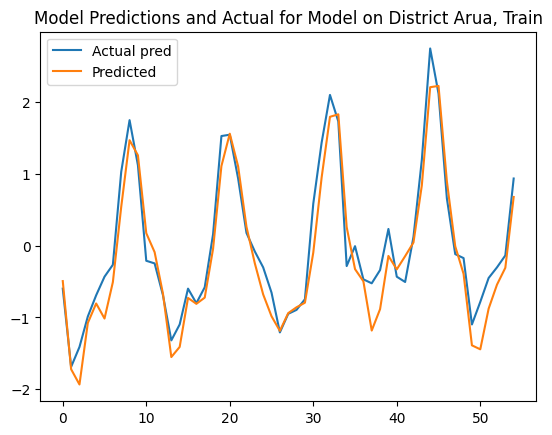

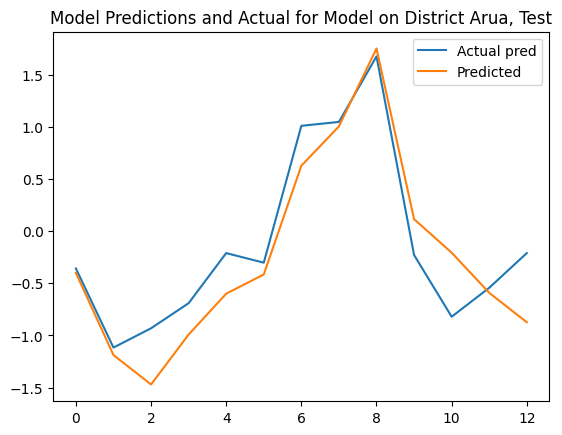

In [63]:
train_and_plot(arua_train_dataloader, arua_test_dataloader, arua_dict, "Arua")

*************Model For District Kasese
Epoch 0: train MSE 11.3525, test MSE 3.4464, train RMSE 3.3693, test RMSE 1.8565
Epoch 10: train MSE 13.7540, test MSE 5.3075, train RMSE 3.7086, test RMSE 2.3038
Epoch 20: train MSE 10.3255, test MSE 2.7936, train RMSE 3.2133, test RMSE 1.6714
Epoch 30: train MSE 4.7862, test MSE 1.3581, train RMSE 2.1877, test RMSE 1.1654
Epoch 40: train MSE 5.4745, test MSE 0.9608, train RMSE 2.3398, test RMSE 0.9802
Epoch 50: train MSE 2.7649, test MSE 1.1948, train RMSE 1.6628, test RMSE 1.0931
Epoch 60: train MSE 3.5219, test MSE 0.7174, train RMSE 1.8767, test RMSE 0.8470
Epoch 70: train MSE 3.5113, test MSE 1.1859, train RMSE 1.8738, test RMSE 1.0890
Epoch 80: train MSE 1.8588, test MSE 0.9231, train RMSE 1.3634, test RMSE 0.9608
Epoch 90: train MSE 2.5092, test MSE 0.6310, train RMSE 1.5840, test RMSE 0.7944


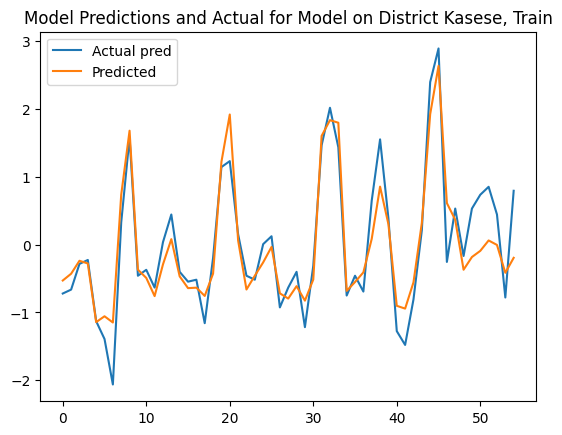

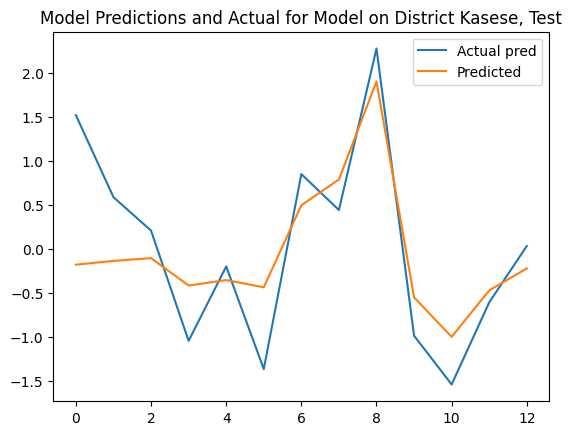

In [64]:
train_and_plot(kasese_train_dataloader, kasese_test_dataloader, kasese_dict, "Kasese")

*************Model For District Kabale
Epoch 0: train MSE 11.2915, test MSE 2.3821, train RMSE 3.3603, test RMSE 1.5434
Epoch 10: train MSE 11.8065, test MSE 6.3299, train RMSE 3.4361, test RMSE 2.5159
Epoch 20: train MSE 6.5282, test MSE 1.3794, train RMSE 2.5550, test RMSE 1.1745
Epoch 30: train MSE 7.0335, test MSE 1.5293, train RMSE 2.6521, test RMSE 1.2367
Epoch 40: train MSE 4.9629, test MSE 1.8547, train RMSE 2.2277, test RMSE 1.3619
Epoch 50: train MSE 1.3073, test MSE 0.4871, train RMSE 1.1434, test RMSE 0.6979
Epoch 60: train MSE 1.2495, test MSE 0.5090, train RMSE 1.1178, test RMSE 0.7134
Epoch 70: train MSE 1.8933, test MSE 0.7582, train RMSE 1.3760, test RMSE 0.8707
Epoch 80: train MSE 2.5130, test MSE 0.5120, train RMSE 1.5852, test RMSE 0.7155
Epoch 90: train MSE 1.4036, test MSE 0.5486, train RMSE 1.1847, test RMSE 0.7407


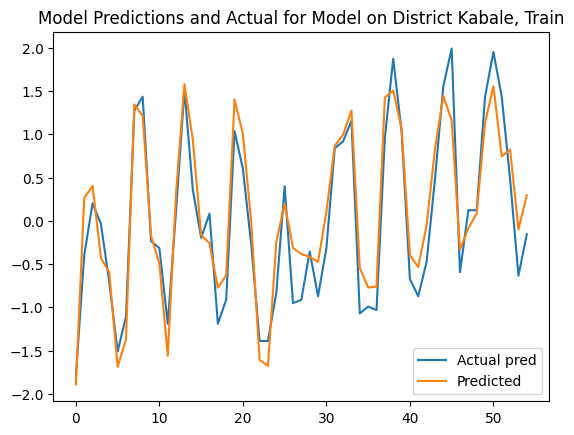

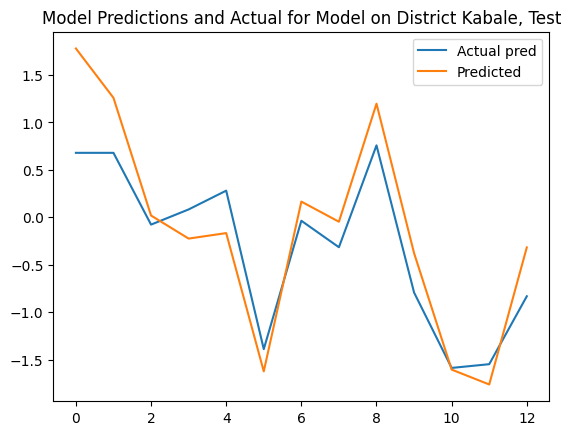

In [65]:
train_and_plot(kabale_train_dataloader, kabale_test_dataloader, kabale_dict, "Kabale")

## Testing with Lookback = 8

In [66]:
lookback = 8
batch = 5

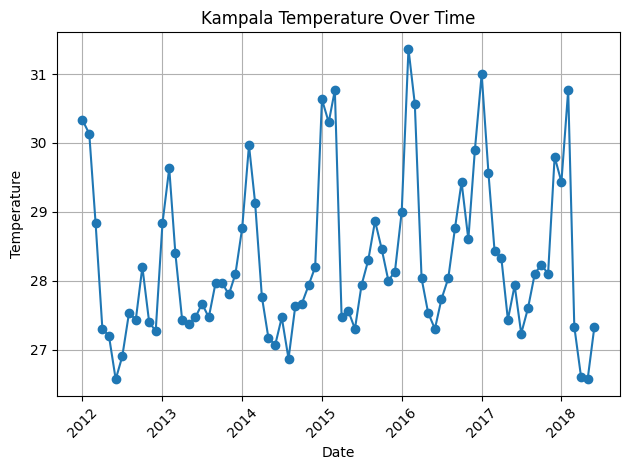

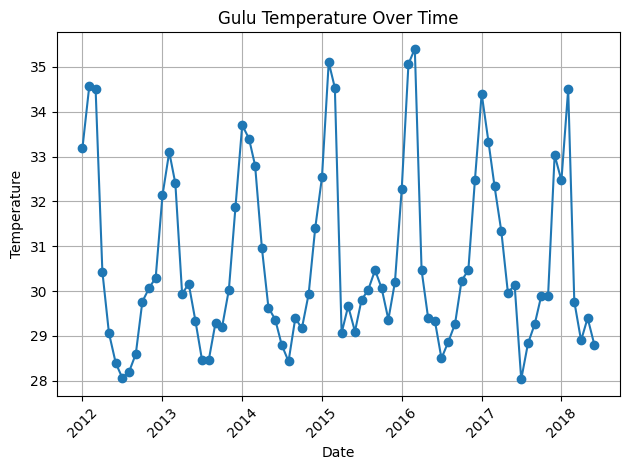

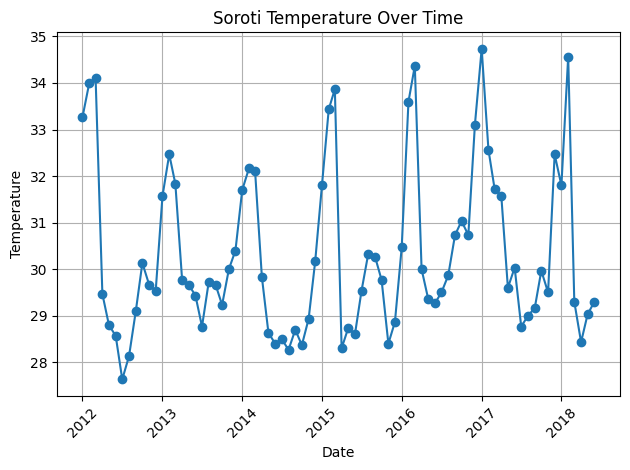

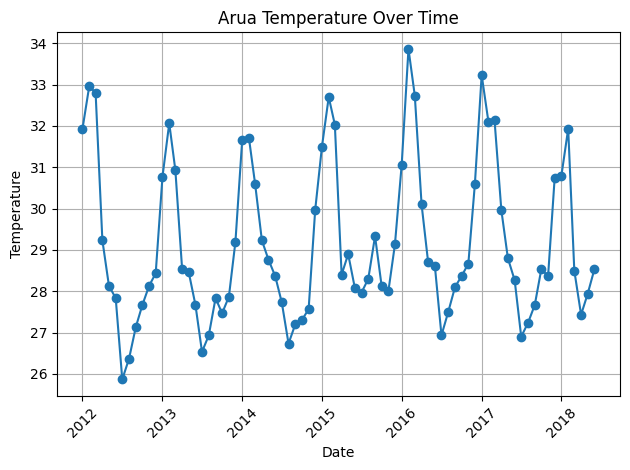

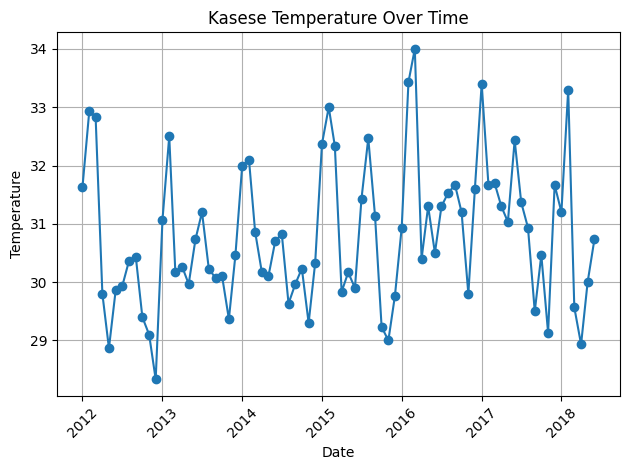

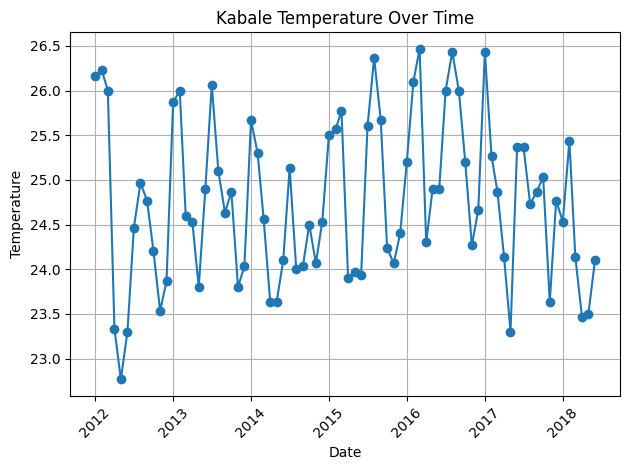

In [67]:
kampala_train_dataloader, kampale_test_dataloader, kampala_dict = create_series_dataloader_on_district('Kampala')
gulu_train_dataloader, gulu_test_dataloader, gulu_dict = create_series_dataloader_on_district('Gulu')
soroti_train_dataloader, soroti_test_dataloader, soroti_dict = create_series_dataloader_on_district('Soroti')
arua_train_dataloader, arua_test_dataloader, arua_dict = create_series_dataloader_on_district('Arua')
kasese_train_dataloader, kasese_test_dataloader, kasese_dict = create_series_dataloader_on_district('Kasese')
kabale_train_dataloader, kabale_test_dataloader, kabale_dict = create_series_dataloader_on_district('Kabale')

*************Model For District Kampala
Epoch 0: train MSE 10.8865, test MSE 3.6470, train RMSE 3.2995, test RMSE 1.9097
Epoch 10: train MSE 11.8596, test MSE 3.4681, train RMSE 3.4438, test RMSE 1.8623
Epoch 20: train MSE 11.4568, test MSE 2.7143, train RMSE 3.3848, test RMSE 1.6475
Epoch 30: train MSE 2.6808, test MSE 1.3792, train RMSE 1.6373, test RMSE 1.1744
Epoch 40: train MSE 2.4131, test MSE 1.2359, train RMSE 1.5534, test RMSE 1.1117
Epoch 50: train MSE 3.6634, test MSE 1.3590, train RMSE 1.9140, test RMSE 1.1658
Epoch 60: train MSE 2.1612, test MSE 0.9412, train RMSE 1.4701, test RMSE 0.9702
Epoch 70: train MSE 1.7569, test MSE 1.4295, train RMSE 1.3255, test RMSE 1.1956
Epoch 80: train MSE 1.6125, test MSE 0.4131, train RMSE 1.2698, test RMSE 0.6428
Epoch 90: train MSE 4.3754, test MSE 0.5314, train RMSE 2.0918, test RMSE 0.7290


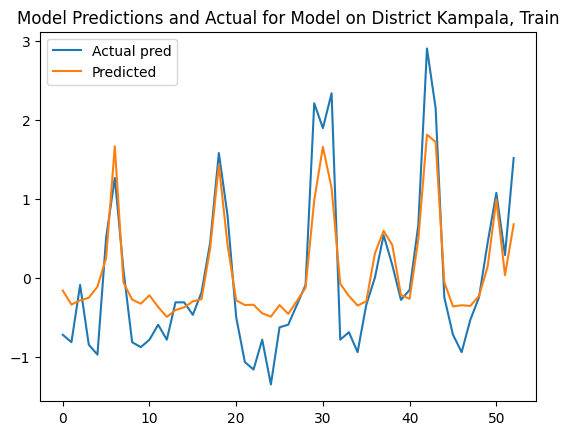

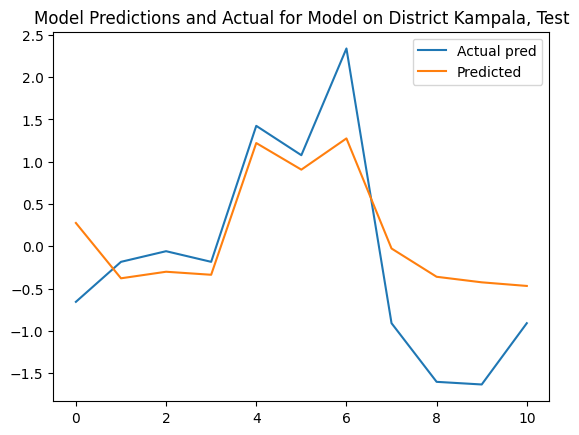

In [68]:
train_and_plot(kampala_train_dataloader, kampale_test_dataloader, kampala_dict, "Kampala")

*************Model For District Gulu
Epoch 0: train MSE 9.9958, test MSE 2.3085, train RMSE 3.1616, test RMSE 1.5194
Epoch 10: train MSE 9.7923, test MSE 2.0415, train RMSE 3.1293, test RMSE 1.4288
Epoch 20: train MSE 7.0375, test MSE 1.5295, train RMSE 2.6528, test RMSE 1.2367
Epoch 30: train MSE 5.3893, test MSE 0.9908, train RMSE 2.3215, test RMSE 0.9954
Epoch 40: train MSE 2.9535, test MSE 0.2894, train RMSE 1.7186, test RMSE 0.5379
Epoch 50: train MSE 3.1007, test MSE 1.7039, train RMSE 1.7609, test RMSE 1.3053
Epoch 60: train MSE 4.4082, test MSE 6.1636, train RMSE 2.0996, test RMSE 2.4827
Epoch 70: train MSE 4.3221, test MSE 4.1558, train RMSE 2.0790, test RMSE 2.0386
Epoch 80: train MSE 3.3367, test MSE 0.9220, train RMSE 1.8267, test RMSE 0.9602
Epoch 90: train MSE 4.7774, test MSE 0.9427, train RMSE 2.1857, test RMSE 0.9709


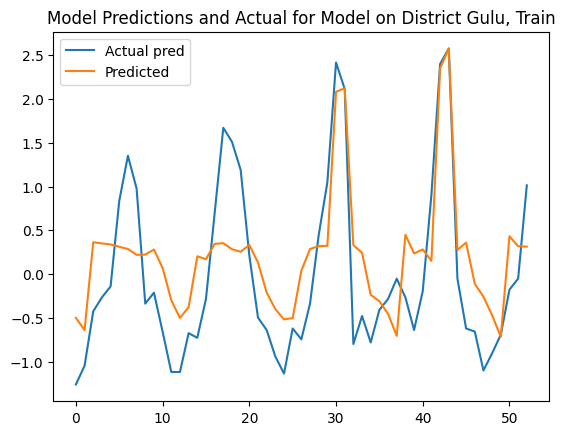

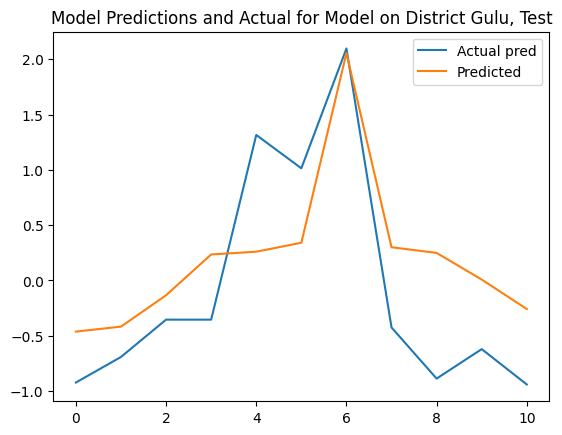

In [69]:
train_and_plot(gulu_train_dataloader, gulu_test_dataloader, gulu_dict, "Gulu")

*************Model For District Soroti
Epoch 0: train MSE 10.5108, test MSE 2.8295, train RMSE 3.2420, test RMSE 1.6821
Epoch 10: train MSE 11.7723, test MSE 2.9503, train RMSE 3.4311, test RMSE 1.7176
Epoch 20: train MSE 9.1116, test MSE 3.1914, train RMSE 3.0185, test RMSE 1.7864
Epoch 30: train MSE 3.1494, test MSE 1.6282, train RMSE 1.7747, test RMSE 1.2760
Epoch 40: train MSE 5.1233, test MSE 1.3690, train RMSE 2.2635, test RMSE 1.1700
Epoch 50: train MSE 3.6525, test MSE 1.2087, train RMSE 1.9111, test RMSE 1.0994
Epoch 60: train MSE 3.3447, test MSE 0.4452, train RMSE 1.8289, test RMSE 0.6673
Epoch 70: train MSE 7.3847, test MSE 1.2697, train RMSE 2.7175, test RMSE 1.1268
Epoch 80: train MSE 7.2797, test MSE 2.0827, train RMSE 2.6981, test RMSE 1.4432
Epoch 90: train MSE 2.1812, test MSE 0.8627, train RMSE 1.4769, test RMSE 0.9288


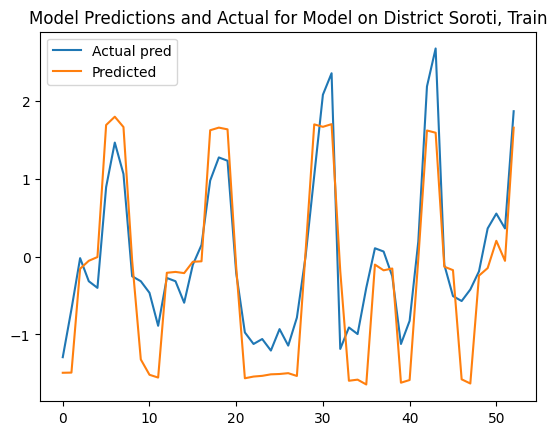

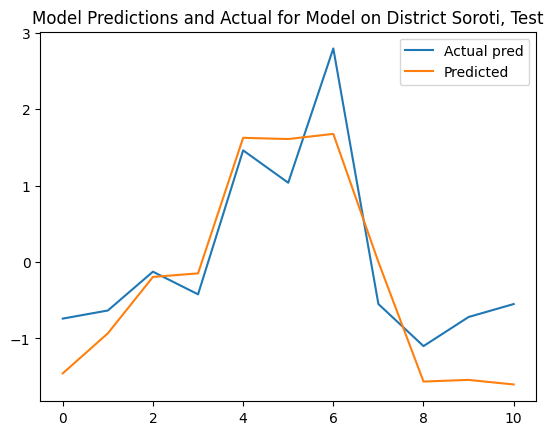

In [70]:
train_and_plot(soroti_train_dataloader, soroti_test_dataloader, soroti_dict, "Soroti")

*************Model For District Arua
Epoch 0: train MSE 10.0880, test MSE 1.2357, train RMSE 3.1762, test RMSE 1.1116
Epoch 10: train MSE 4.1496, test MSE 1.6222, train RMSE 2.0370, test RMSE 1.2737
Epoch 20: train MSE 10.3094, test MSE 1.9991, train RMSE 3.2108, test RMSE 1.4139
Epoch 30: train MSE 4.6230, test MSE 1.1764, train RMSE 2.1501, test RMSE 1.0846
Epoch 40: train MSE 5.1534, test MSE 1.6056, train RMSE 2.2701, test RMSE 1.2671
Epoch 50: train MSE 7.3023, test MSE 1.0985, train RMSE 2.7023, test RMSE 1.0481
Epoch 60: train MSE 6.4264, test MSE 0.8996, train RMSE 2.5350, test RMSE 0.9485
Epoch 70: train MSE 7.7213, test MSE 3.2188, train RMSE 2.7787, test RMSE 1.7941
Epoch 80: train MSE 12.4127, test MSE 3.6539, train RMSE 3.5232, test RMSE 1.9115
Epoch 90: train MSE 17.2653, test MSE 2.6433, train RMSE 4.1552, test RMSE 1.6258


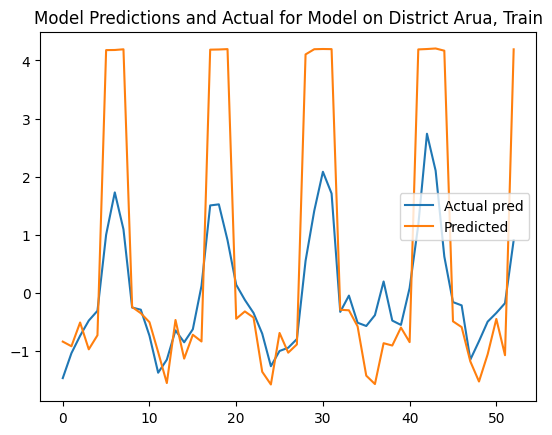

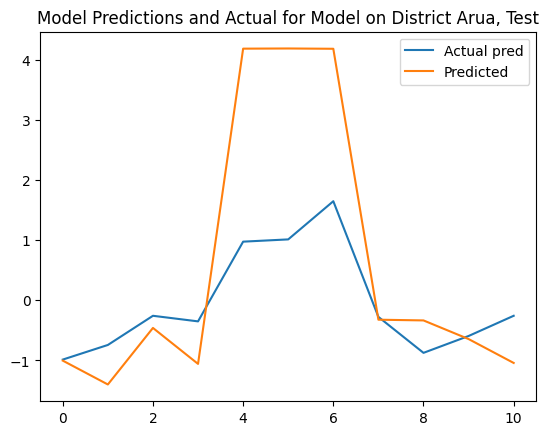

In [71]:
train_and_plot(arua_train_dataloader, arua_test_dataloader, arua_dict, "Arua")

*************Model For District Kasese
Epoch 0: train MSE 11.0116, test MSE 2.5784, train RMSE 3.3184, test RMSE 1.6057
Epoch 10: train MSE 8.0265, test MSE 2.6127, train RMSE 2.8331, test RMSE 1.6164
Epoch 20: train MSE 16.0999, test MSE 8.7893, train RMSE 4.0125, test RMSE 2.9647
Epoch 30: train MSE 5.3754, test MSE 1.3651, train RMSE 2.3185, test RMSE 1.1684
Epoch 40: train MSE 10.7973, test MSE 2.5319, train RMSE 3.2859, test RMSE 1.5912
Epoch 50: train MSE 6.9578, test MSE 1.6312, train RMSE 2.6378, test RMSE 1.2772
Epoch 60: train MSE 4.5169, test MSE 1.5425, train RMSE 2.1253, test RMSE 1.2420
Epoch 70: train MSE 9.8738, test MSE 4.0195, train RMSE 3.1423, test RMSE 2.0049
Epoch 80: train MSE 9.4127, test MSE 2.6221, train RMSE 3.0680, test RMSE 1.6193
Epoch 90: train MSE 9.8873, test MSE 1.9724, train RMSE 3.1444, test RMSE 1.4044


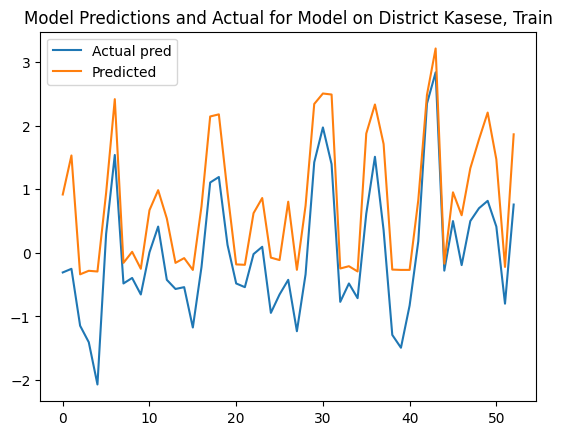

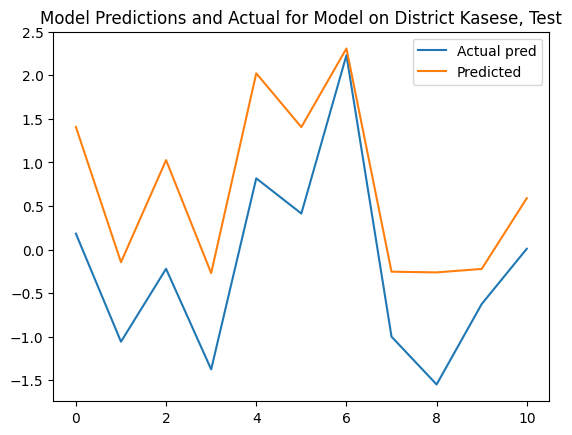

In [72]:
train_and_plot(kasese_train_dataloader, kasese_test_dataloader, kasese_dict, "Kasese")

*************Model For District Kabale
Epoch 0: train MSE 11.2229, test MSE 2.9619, train RMSE 3.3501, test RMSE 1.7210
Epoch 10: train MSE 7.3465, test MSE 0.9522, train RMSE 2.7105, test RMSE 0.9758
Epoch 20: train MSE 7.3340, test MSE 1.8523, train RMSE 2.7081, test RMSE 1.3610
Epoch 30: train MSE 5.0130, test MSE 1.7437, train RMSE 2.2390, test RMSE 1.3205
Epoch 40: train MSE 5.1607, test MSE 1.8498, train RMSE 2.2717, test RMSE 1.3601
Epoch 50: train MSE 3.3878, test MSE 1.0203, train RMSE 1.8406, test RMSE 1.0101
Epoch 60: train MSE 4.8121, test MSE 1.2913, train RMSE 2.1937, test RMSE 1.1364
Epoch 70: train MSE 3.0417, test MSE 1.0850, train RMSE 1.7441, test RMSE 1.0416
Epoch 80: train MSE 2.8622, test MSE 0.3160, train RMSE 1.6918, test RMSE 0.5621
Epoch 90: train MSE 1.3125, test MSE 0.5844, train RMSE 1.1456, test RMSE 0.7644


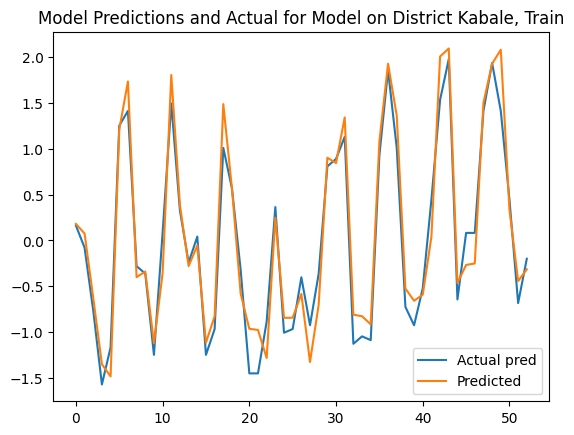

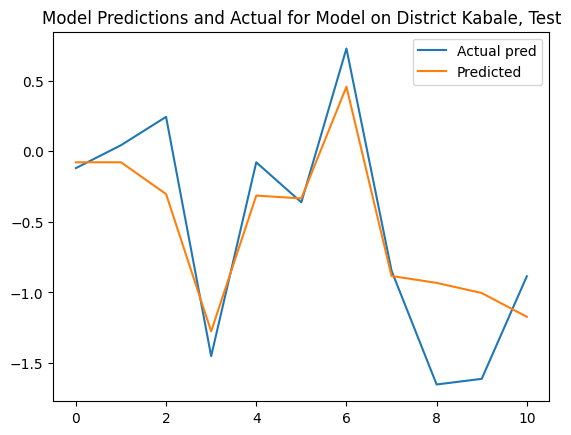

In [73]:
train_and_plot(kabale_train_dataloader, kabale_test_dataloader, kabale_dict, "Kabale")

## Testing with Lookback = 9

In [74]:
lookback = 9
batch = 5

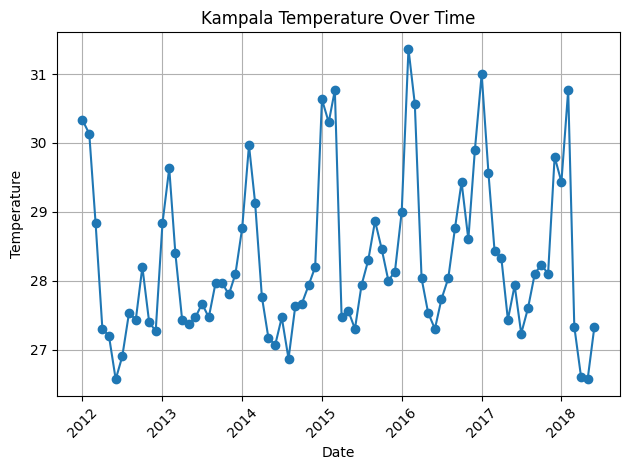

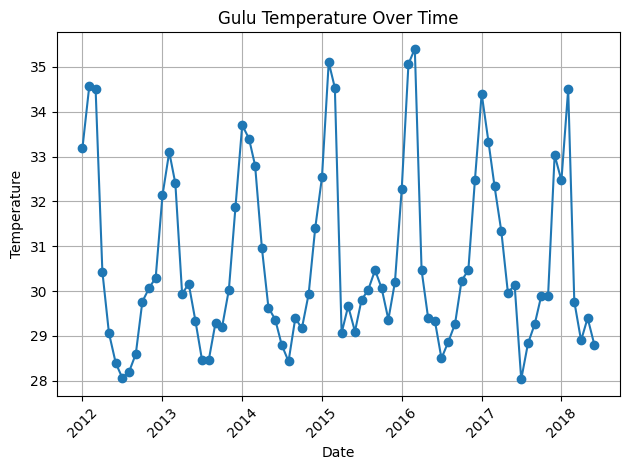

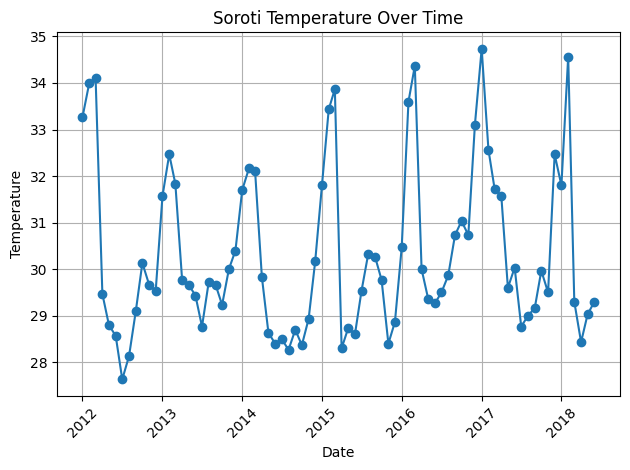

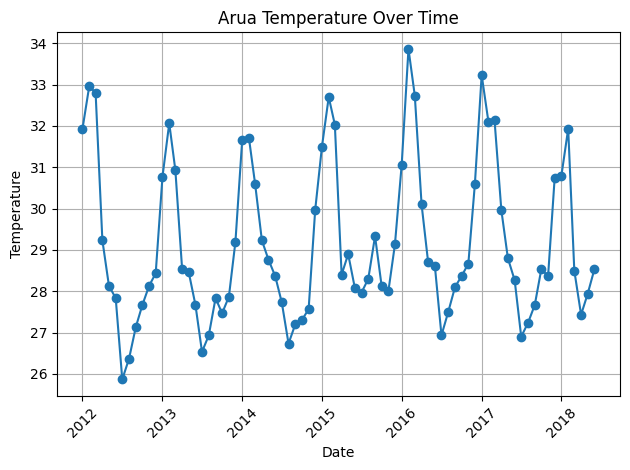

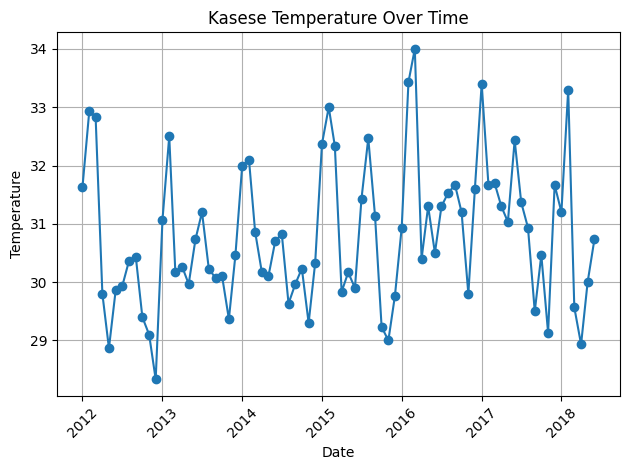

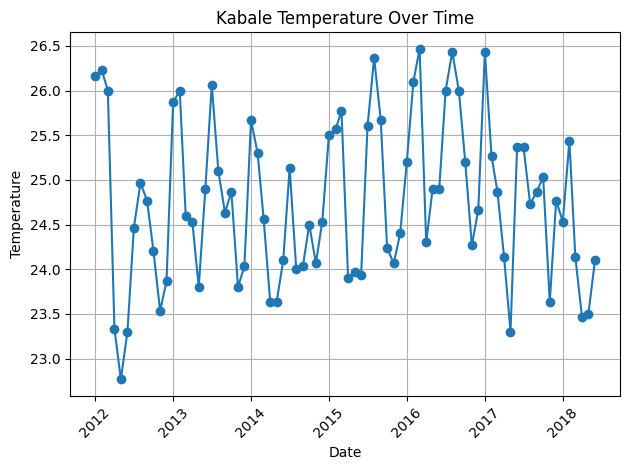

In [75]:
kampala_train_dataloader, kampale_test_dataloader, kampala_dict = create_series_dataloader_on_district('Kampala')
gulu_train_dataloader, gulu_test_dataloader, gulu_dict = create_series_dataloader_on_district('Gulu')
soroti_train_dataloader, soroti_test_dataloader, soroti_dict = create_series_dataloader_on_district('Soroti')
arua_train_dataloader, arua_test_dataloader, arua_dict = create_series_dataloader_on_district('Arua')
kasese_train_dataloader, kasese_test_dataloader, kasese_dict = create_series_dataloader_on_district('Kasese')
kabale_train_dataloader, kabale_test_dataloader, kabale_dict = create_series_dataloader_on_district('Kabale')

*************Model For District Kampala
Epoch 0: train MSE 11.0457, test MSE 3.0978, train RMSE 3.3235, test RMSE 1.7600
Epoch 10: train MSE 11.7884, test MSE 3.1963, train RMSE 3.4334, test RMSE 1.7878
Epoch 20: train MSE 5.4730, test MSE 1.1395, train RMSE 2.3394, test RMSE 1.0675
Epoch 30: train MSE 5.7096, test MSE 1.4874, train RMSE 2.3895, test RMSE 1.2196
Epoch 40: train MSE 3.1719, test MSE 1.0482, train RMSE 1.7810, test RMSE 1.0238
Epoch 50: train MSE 5.6399, test MSE 0.5401, train RMSE 2.3749, test RMSE 0.7349
Epoch 60: train MSE 2.9603, test MSE 0.7824, train RMSE 1.7206, test RMSE 0.8845
Epoch 70: train MSE 5.1798, test MSE 1.2968, train RMSE 2.2759, test RMSE 1.1388
Epoch 80: train MSE 5.3539, test MSE 1.2992, train RMSE 2.3138, test RMSE 1.1398
Epoch 90: train MSE 5.9151, test MSE 0.8771, train RMSE 2.4321, test RMSE 0.9365


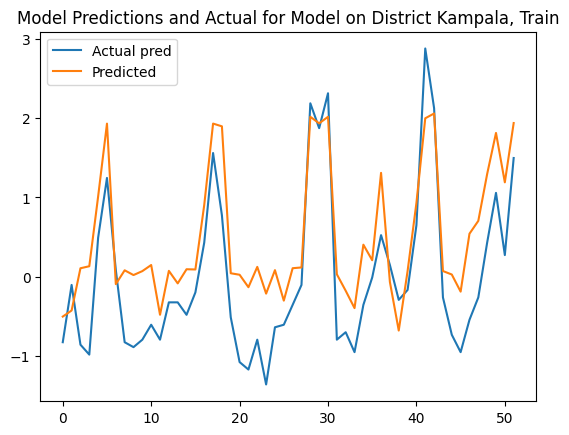

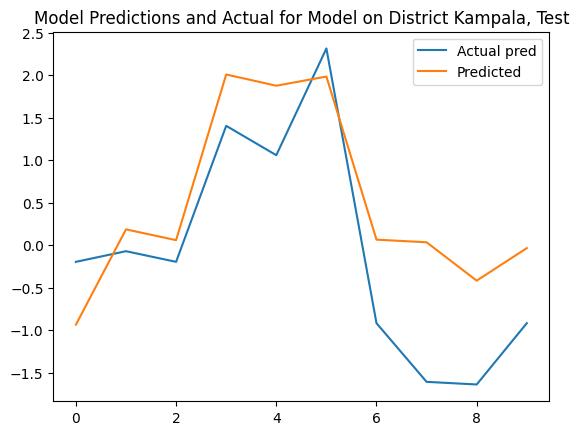

In [76]:
train_and_plot(kampala_train_dataloader, kampale_test_dataloader, kampala_dict, "Kampala")

*************Model For District Gulu
Epoch 0: train MSE 10.6385, test MSE 1.8951, train RMSE 3.2617, test RMSE 1.3766
Epoch 10: train MSE 10.1522, test MSE 2.0559, train RMSE 3.1863, test RMSE 1.4339
Epoch 20: train MSE 6.1610, test MSE 2.6861, train RMSE 2.4821, test RMSE 1.6389
Epoch 30: train MSE 9.2068, test MSE 1.8996, train RMSE 3.0343, test RMSE 1.3783
Epoch 40: train MSE 12.2043, test MSE 1.7365, train RMSE 3.4935, test RMSE 1.3178
Epoch 50: train MSE 15.2801, test MSE 2.1540, train RMSE 3.9090, test RMSE 1.4677
Epoch 60: train MSE 4.5632, test MSE 1.3381, train RMSE 2.1362, test RMSE 1.1567
Epoch 70: train MSE 1.5964, test MSE 0.1390, train RMSE 1.2635, test RMSE 0.3728
Epoch 80: train MSE 3.9161, test MSE 0.6293, train RMSE 1.9789, test RMSE 0.7933
Epoch 90: train MSE 2.6735, test MSE 0.3091, train RMSE 1.6351, test RMSE 0.5559


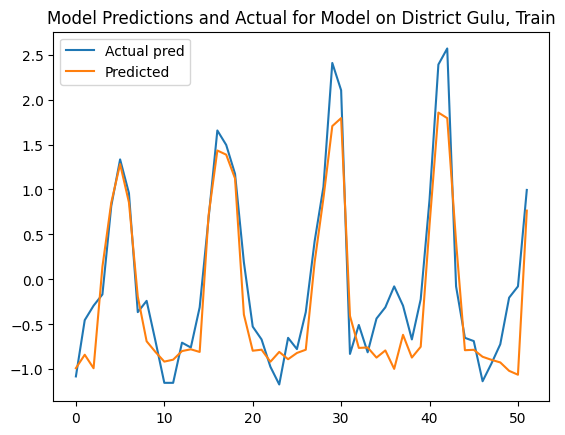

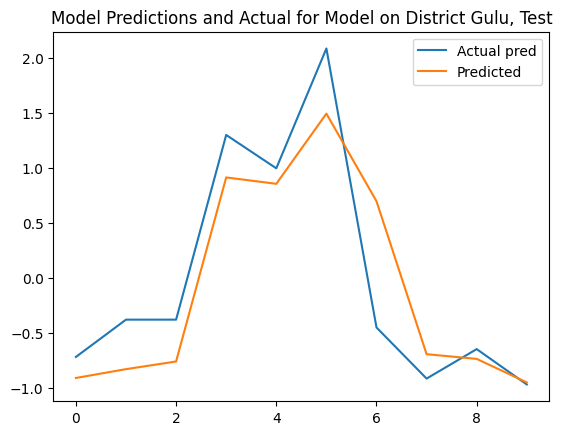

In [77]:
train_and_plot(gulu_train_dataloader, gulu_test_dataloader, gulu_dict, "Gulu")

*************Model For District Soroti
Epoch 0: train MSE 11.4979, test MSE 2.6882, train RMSE 3.3909, test RMSE 1.6396
Epoch 10: train MSE 12.0256, test MSE 2.9494, train RMSE 3.4678, test RMSE 1.7174
Epoch 20: train MSE 20.4336, test MSE 4.7145, train RMSE 4.5204, test RMSE 2.1713
Epoch 30: train MSE 12.7548, test MSE 2.9289, train RMSE 3.5714, test RMSE 1.7114
Epoch 40: train MSE 11.3273, test MSE 3.0393, train RMSE 3.3656, test RMSE 1.7434
Epoch 50: train MSE 8.5810, test MSE 2.4805, train RMSE 2.9293, test RMSE 1.5750
Epoch 60: train MSE 9.8983, test MSE 2.5230, train RMSE 3.1462, test RMSE 1.5884
Epoch 70: train MSE 7.2988, test MSE 0.8414, train RMSE 2.7016, test RMSE 0.9173
Epoch 80: train MSE 4.3991, test MSE 1.0729, train RMSE 2.0974, test RMSE 1.0358
Epoch 90: train MSE 3.4919, test MSE 0.8291, train RMSE 1.8687, test RMSE 0.9106


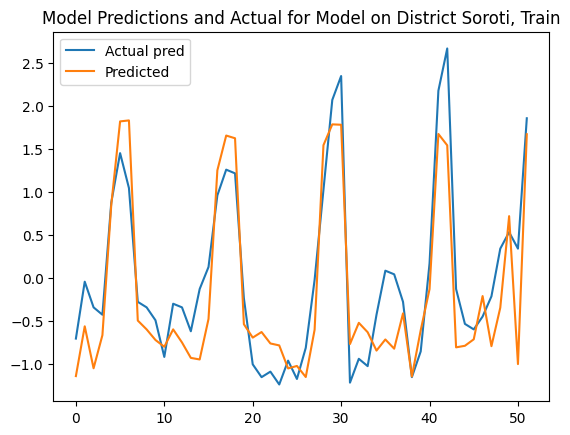

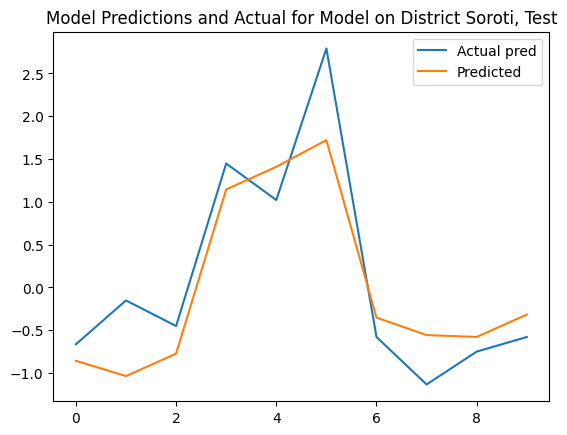

In [78]:
train_and_plot(soroti_train_dataloader, soroti_test_dataloader, soroti_dict, "Soroti")

*************Model For District Arua
Epoch 0: train MSE 10.2774, test MSE 1.2305, train RMSE 3.2058, test RMSE 1.1093
Epoch 10: train MSE 10.0193, test MSE 1.2373, train RMSE 3.1653, test RMSE 1.1123
Epoch 20: train MSE 10.7966, test MSE 1.8194, train RMSE 3.2858, test RMSE 1.3488
Epoch 30: train MSE 3.7312, test MSE 0.8282, train RMSE 1.9316, test RMSE 0.9101
Epoch 40: train MSE 3.1850, test MSE 0.5390, train RMSE 1.7847, test RMSE 0.7342
Epoch 50: train MSE 4.9824, test MSE 0.5973, train RMSE 2.2321, test RMSE 0.7728
Epoch 60: train MSE 8.7968, test MSE 1.0416, train RMSE 2.9659, test RMSE 1.0206
Epoch 70: train MSE 3.8519, test MSE 0.6044, train RMSE 1.9626, test RMSE 0.7774
Epoch 80: train MSE 10.5598, test MSE 2.3967, train RMSE 3.2496, test RMSE 1.5481
Epoch 90: train MSE 10.8156, test MSE 1.8692, train RMSE 3.2887, test RMSE 1.3672


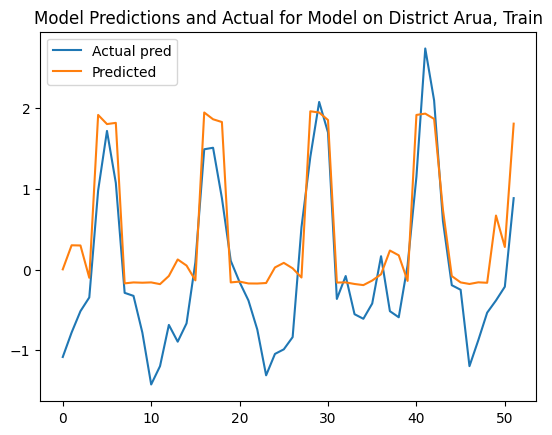

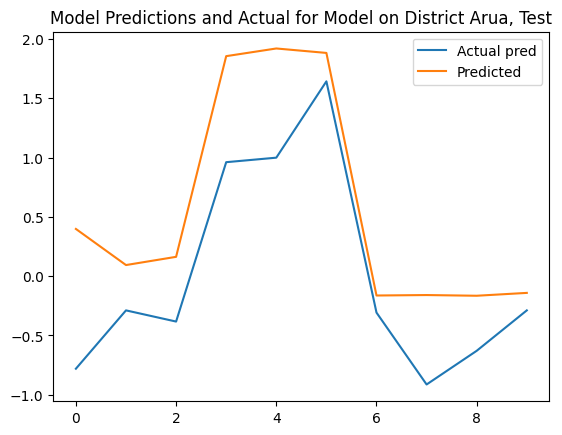

In [79]:
train_and_plot(arua_train_dataloader, arua_test_dataloader, arua_dict, "Arua")

*************Model For District Kasese
Epoch 0: train MSE 10.7670, test MSE 2.5877, train RMSE 3.2813, test RMSE 1.6086
Epoch 10: train MSE 15.9026, test MSE 4.6387, train RMSE 3.9878, test RMSE 2.1538
Epoch 20: train MSE 10.2447, test MSE 2.5931, train RMSE 3.2007, test RMSE 1.6103
Epoch 30: train MSE 6.5724, test MSE 1.9417, train RMSE 2.5637, test RMSE 1.3934
Epoch 40: train MSE 4.4042, test MSE 1.3884, train RMSE 2.0986, test RMSE 1.1783
Epoch 50: train MSE 6.0463, test MSE 1.7576, train RMSE 2.4589, test RMSE 1.3257
Epoch 60: train MSE 4.2515, test MSE 1.7925, train RMSE 2.0619, test RMSE 1.3388
Epoch 70: train MSE 3.0935, test MSE 1.1543, train RMSE 1.7588, test RMSE 1.0744
Epoch 80: train MSE 3.0704, test MSE 1.1858, train RMSE 1.7522, test RMSE 1.0889
Epoch 90: train MSE 2.4976, test MSE 0.8497, train RMSE 1.5804, test RMSE 0.9218


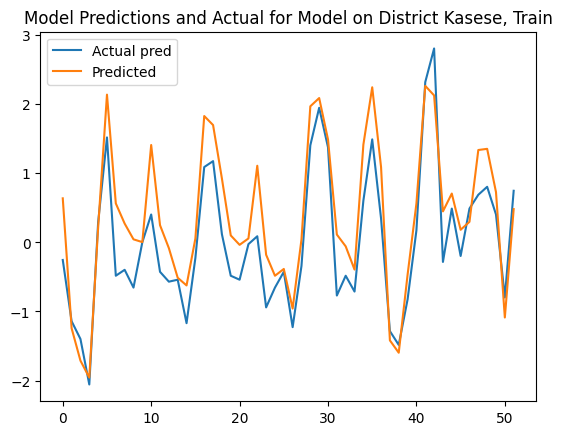

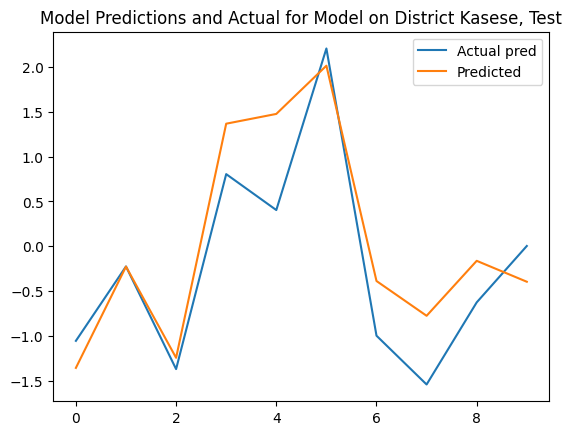

In [80]:
train_and_plot(kasese_train_dataloader, kasese_test_dataloader, kasese_dict, "Kasese")

*************Model For District Kabale
Epoch 0: train MSE 10.8063, test MSE 1.9634, train RMSE 3.2873, test RMSE 1.4012
Epoch 10: train MSE 7.8500, test MSE 0.6741, train RMSE 2.8018, test RMSE 0.8210
Epoch 20: train MSE 7.4431, test MSE 4.7902, train RMSE 2.7282, test RMSE 2.1887
Epoch 30: train MSE 14.2609, test MSE 1.5895, train RMSE 3.7764, test RMSE 1.2607
Epoch 40: train MSE 4.0994, test MSE 0.5833, train RMSE 2.0247, test RMSE 0.7637
Epoch 50: train MSE 7.1310, test MSE 2.7365, train RMSE 2.6704, test RMSE 1.6542
Epoch 60: train MSE 5.7453, test MSE 1.1534, train RMSE 2.3969, test RMSE 1.0740
Epoch 70: train MSE 5.5811, test MSE 1.0228, train RMSE 2.3624, test RMSE 1.0113
Epoch 80: train MSE 5.1735, test MSE 2.1149, train RMSE 2.2745, test RMSE 1.4543
Epoch 90: train MSE 3.7142, test MSE 1.3713, train RMSE 1.9272, test RMSE 1.1710


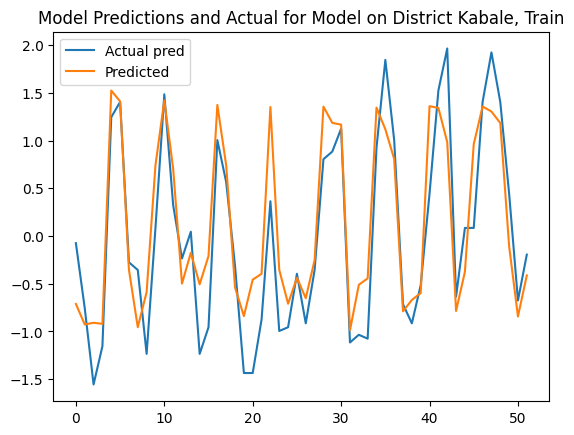

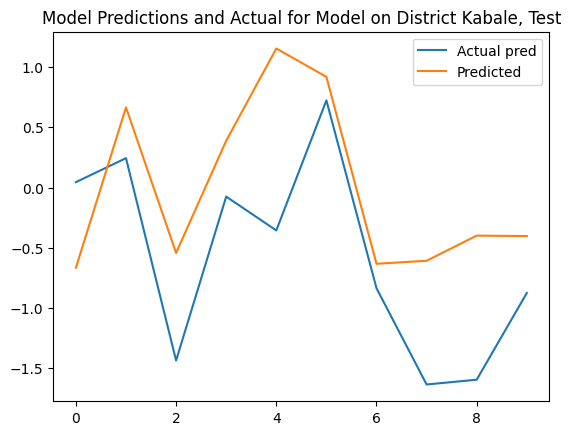

In [81]:
train_and_plot(kabale_train_dataloader, kabale_test_dataloader, kabale_dict, "Kabale")

## Testing with Lookback = 10

In [82]:
lookback = 10
batch = 5

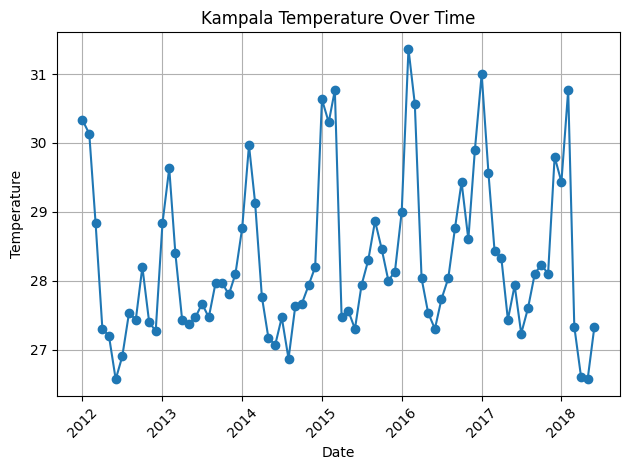

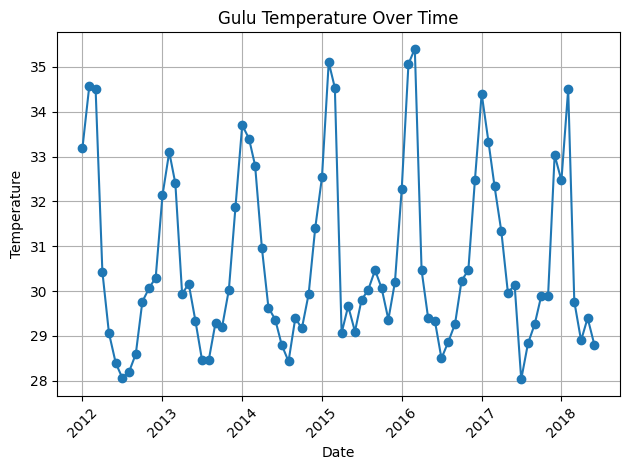

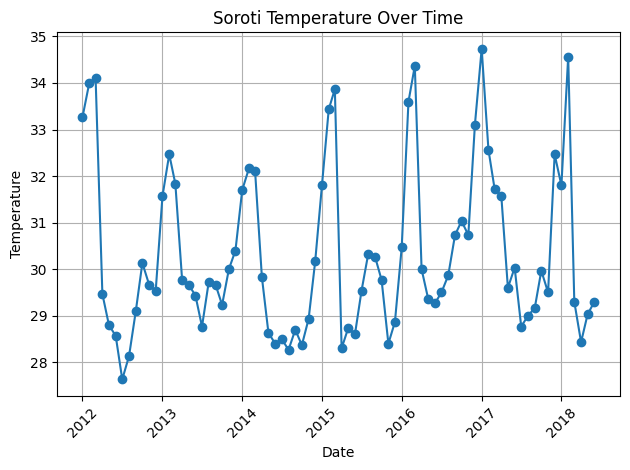

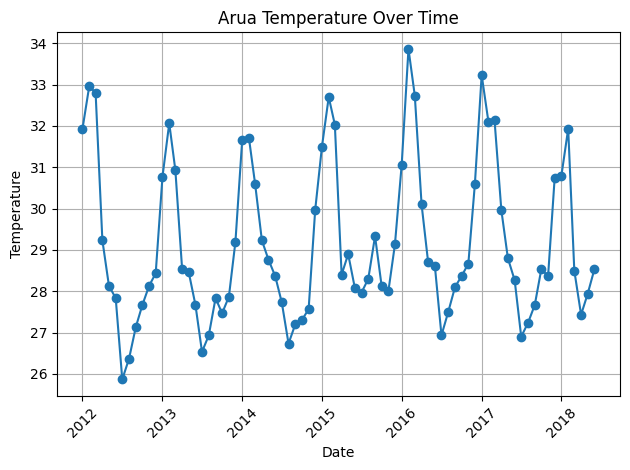

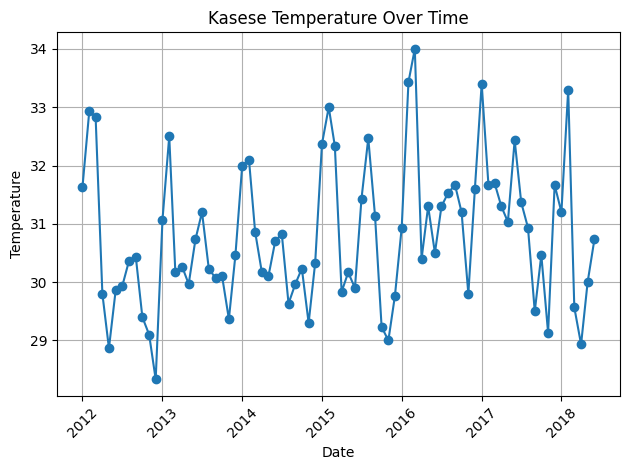

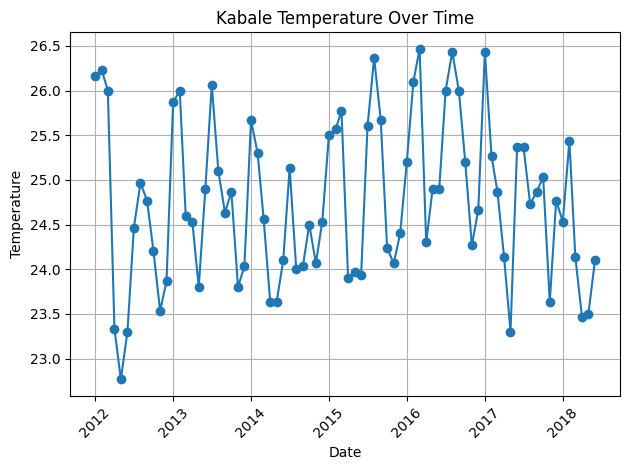

In [83]:
kampala_train_dataloader, kampale_test_dataloader, kampala_dict = create_series_dataloader_on_district('Kampala')
gulu_train_dataloader, gulu_test_dataloader, gulu_dict = create_series_dataloader_on_district('Gulu')
soroti_train_dataloader, soroti_test_dataloader, soroti_dict = create_series_dataloader_on_district('Soroti')
arua_train_dataloader, arua_test_dataloader, arua_dict = create_series_dataloader_on_district('Arua')
kasese_train_dataloader, kasese_test_dataloader, kasese_dict = create_series_dataloader_on_district('Kasese')
kabale_train_dataloader, kabale_test_dataloader, kabale_dict = create_series_dataloader_on_district('Kabale')

*************Model For District Kampala
Epoch 0: train MSE 12.1276, test MSE 3.2558, train RMSE 3.4825, test RMSE 1.8044
Epoch 10: train MSE 11.1218, test MSE 4.8615, train RMSE 3.3349, test RMSE 2.2049
Epoch 20: train MSE 10.7855, test MSE 4.2021, train RMSE 3.2841, test RMSE 2.0499
Epoch 30: train MSE 10.9331, test MSE 1.8559, train RMSE 3.3065, test RMSE 1.3623
Epoch 40: train MSE 8.5661, test MSE 3.2090, train RMSE 2.9268, test RMSE 1.7914
Epoch 50: train MSE 12.9042, test MSE 1.2630, train RMSE 3.5922, test RMSE 1.1238
Epoch 60: train MSE 79.6624, test MSE 13.6452, train RMSE 8.9254, test RMSE 3.6939
Epoch 70: train MSE 50.1240, test MSE 10.9203, train RMSE 7.0798, test RMSE 3.3046
Epoch 80: train MSE 29.7569, test MSE 3.9225, train RMSE 5.4550, test RMSE 1.9805
Epoch 90: train MSE 72.3521, test MSE 15.6459, train RMSE 8.5060, test RMSE 3.9555


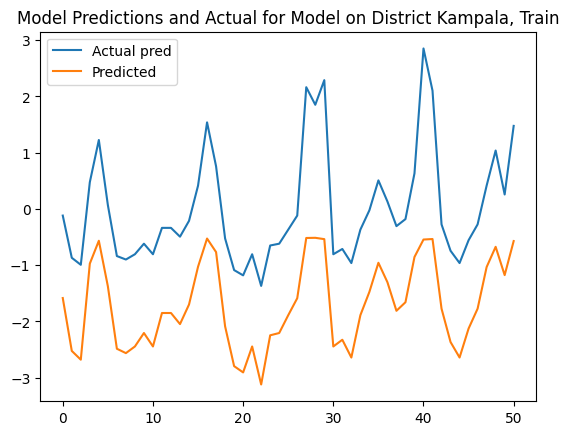

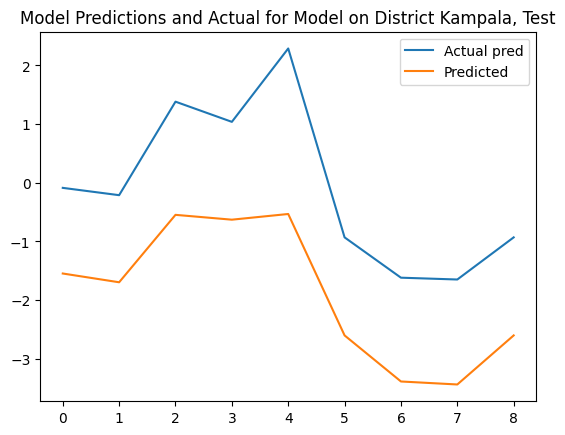

In [84]:
train_and_plot(kampala_train_dataloader, kampale_test_dataloader, kampala_dict, "Kampala")

*************Model For District Gulu
Epoch 0: train MSE 10.5099, test MSE 1.9762, train RMSE 3.2419, test RMSE 1.4058
Epoch 10: train MSE 10.0679, test MSE 2.0882, train RMSE 3.1730, test RMSE 1.4451
Epoch 20: train MSE 9.4759, test MSE 1.7530, train RMSE 3.0783, test RMSE 1.3240
Epoch 30: train MSE 6.7341, test MSE 2.0578, train RMSE 2.5950, test RMSE 1.4345
Epoch 40: train MSE 3.1207, test MSE 0.7500, train RMSE 1.7666, test RMSE 0.8660
Epoch 50: train MSE 6.2926, test MSE 1.5561, train RMSE 2.5085, test RMSE 1.2474
Epoch 60: train MSE 4.3623, test MSE 0.5787, train RMSE 2.0886, test RMSE 0.7607
Epoch 70: train MSE 6.3885, test MSE 2.0619, train RMSE 2.5276, test RMSE 1.4359
Epoch 80: train MSE 3.7787, test MSE 1.0803, train RMSE 1.9439, test RMSE 1.0394
Epoch 90: train MSE 5.4674, test MSE 0.5404, train RMSE 2.3382, test RMSE 0.7351


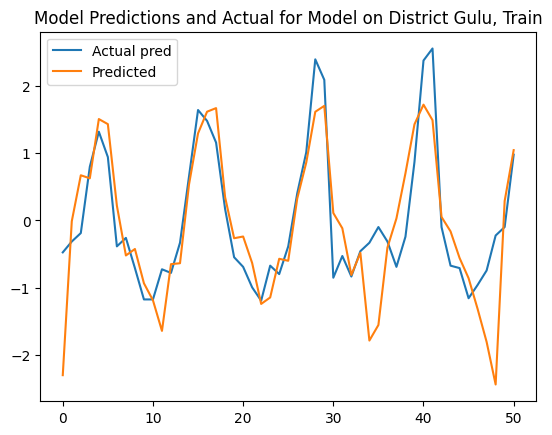

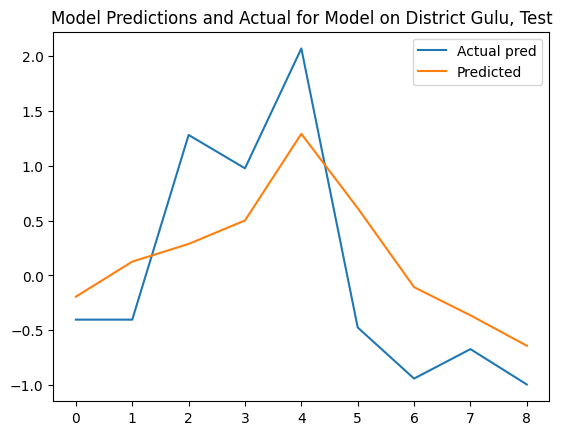

In [85]:
train_and_plot(gulu_train_dataloader, gulu_test_dataloader, gulu_dict, "Gulu")

*************Model For District Soroti
Epoch 0: train MSE 13.1412, test MSE 2.8188, train RMSE 3.6251, test RMSE 1.6789
Epoch 10: train MSE 9.9121, test MSE 2.0086, train RMSE 3.1484, test RMSE 1.4173
Epoch 20: train MSE 12.0164, test MSE 3.1915, train RMSE 3.4665, test RMSE 1.7865
Epoch 30: train MSE 19.6482, test MSE 3.2738, train RMSE 4.4326, test RMSE 1.8094
Epoch 40: train MSE 7.8048, test MSE 0.6825, train RMSE 2.7937, test RMSE 0.8262
Epoch 50: train MSE 4.1888, test MSE 0.9374, train RMSE 2.0466, test RMSE 0.9682
Epoch 60: train MSE 4.5785, test MSE 0.9943, train RMSE 2.1397, test RMSE 0.9971
Epoch 70: train MSE 7.0552, test MSE 1.0554, train RMSE 2.6562, test RMSE 1.0273
Epoch 80: train MSE 5.7002, test MSE 1.6580, train RMSE 2.3875, test RMSE 1.2876
Epoch 90: train MSE 4.8062, test MSE 0.5319, train RMSE 2.1923, test RMSE 0.7293


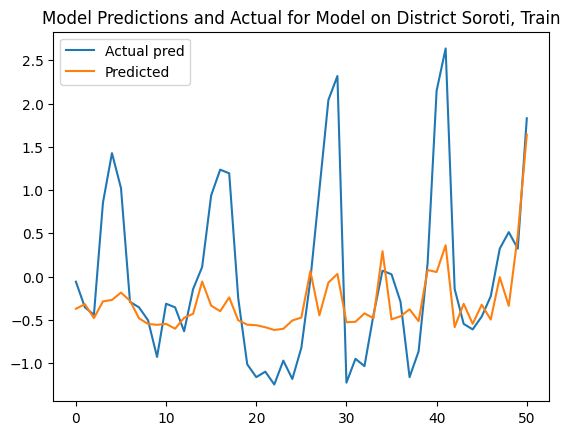

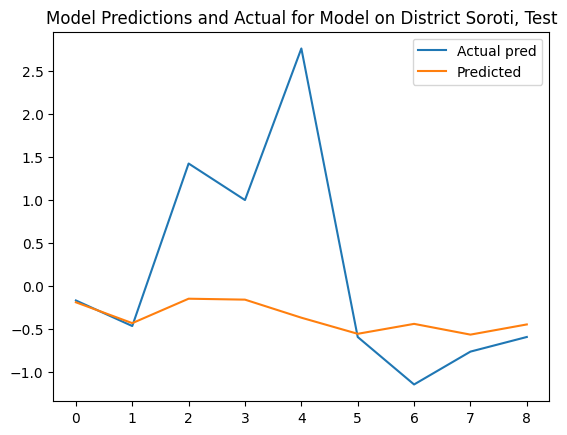

In [86]:
train_and_plot(soroti_train_dataloader, soroti_test_dataloader, soroti_dict, "Soroti")

*************Model For District Arua
Epoch 0: train MSE 10.1951, test MSE 1.2783, train RMSE 3.1930, test RMSE 1.1306
Epoch 10: train MSE 10.0792, test MSE 1.6040, train RMSE 3.1748, test RMSE 1.2665
Epoch 20: train MSE 9.5687, test MSE 1.2893, train RMSE 3.0933, test RMSE 1.1355
Epoch 30: train MSE 7.8456, test MSE 1.6051, train RMSE 2.8010, test RMSE 1.2669
Epoch 40: train MSE 4.5482, test MSE 0.6019, train RMSE 2.1327, test RMSE 0.7758
Epoch 50: train MSE 5.3836, test MSE 1.0546, train RMSE 2.3203, test RMSE 1.0269
Epoch 60: train MSE 3.2358, test MSE 0.8673, train RMSE 1.7988, test RMSE 0.9313
Epoch 70: train MSE 4.1399, test MSE 0.4266, train RMSE 2.0347, test RMSE 0.6532
Epoch 80: train MSE 3.0306, test MSE 0.5904, train RMSE 1.7409, test RMSE 0.7684
Epoch 90: train MSE 2.9436, test MSE 1.0085, train RMSE 1.7157, test RMSE 1.0042


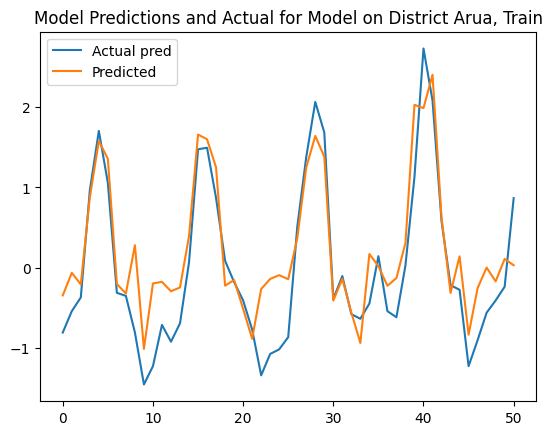

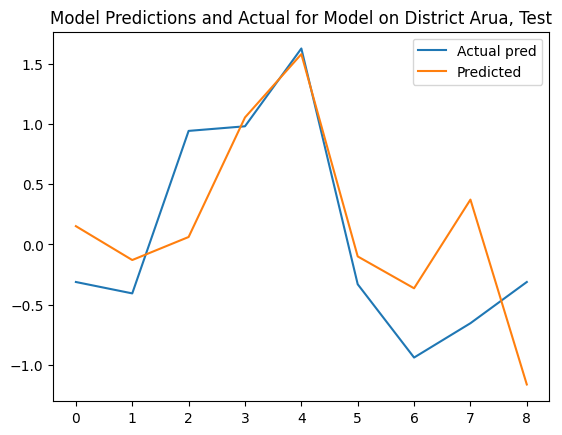

In [87]:
train_and_plot(arua_train_dataloader, arua_test_dataloader, arua_dict, "Arua")

*************Model For District Kasese
Epoch 0: train MSE 10.6500, test MSE 2.4515, train RMSE 3.2634, test RMSE 1.5657
Epoch 10: train MSE 10.3536, test MSE 2.3892, train RMSE 3.2177, test RMSE 1.5457
Epoch 20: train MSE 9.8884, test MSE 2.3291, train RMSE 3.1446, test RMSE 1.5262
Epoch 30: train MSE 19.4487, test MSE 3.4738, train RMSE 4.4101, test RMSE 1.8638
Epoch 40: train MSE 9.1044, test MSE 2.1326, train RMSE 3.0173, test RMSE 1.4603
Epoch 50: train MSE 12.1910, test MSE 2.8658, train RMSE 3.4916, test RMSE 1.6929
Epoch 60: train MSE 16.0154, test MSE 1.9987, train RMSE 4.0019, test RMSE 1.4138
Epoch 70: train MSE 5.6228, test MSE 1.2149, train RMSE 2.3712, test RMSE 1.1022
Epoch 80: train MSE 3.7477, test MSE 0.7265, train RMSE 1.9359, test RMSE 0.8524
Epoch 90: train MSE 4.9172, test MSE 1.0063, train RMSE 2.2175, test RMSE 1.0032


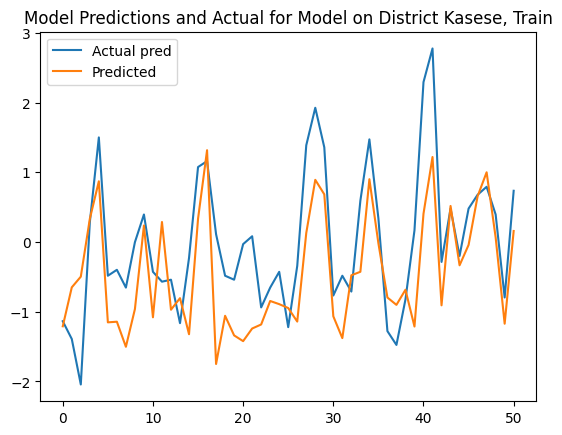

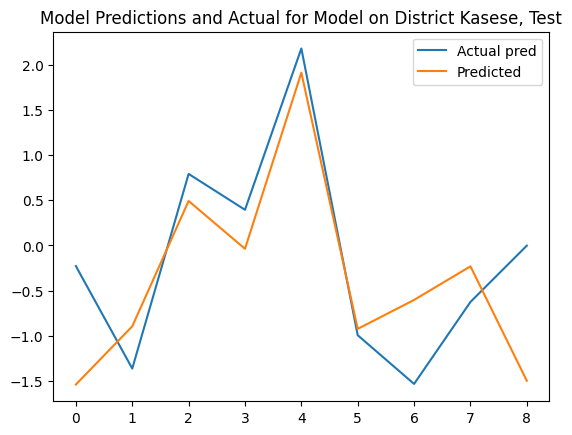

In [88]:
train_and_plot(kasese_train_dataloader, kasese_test_dataloader, kasese_dict, "Kasese")

*************Model For District Kabale
Epoch 0: train MSE 10.0240, test MSE 2.3610, train RMSE 3.1661, test RMSE 1.5366
Epoch 10: train MSE 5.7291, test MSE 0.6382, train RMSE 2.3936, test RMSE 0.7989
Epoch 20: train MSE 7.0674, test MSE 1.1202, train RMSE 2.6585, test RMSE 1.0584
Epoch 30: train MSE 19.9122, test MSE 3.2840, train RMSE 4.4623, test RMSE 1.8122
Epoch 40: train MSE 2.6778, test MSE 0.2695, train RMSE 1.6364, test RMSE 0.5191
Epoch 50: train MSE 6.9936, test MSE 1.0102, train RMSE 2.6445, test RMSE 1.0051
Epoch 60: train MSE 9.3146, test MSE 2.0371, train RMSE 3.0520, test RMSE 1.4273
Epoch 70: train MSE 13.8510, test MSE 3.2141, train RMSE 3.7217, test RMSE 1.7928
Epoch 80: train MSE 16.1515, test MSE 1.9442, train RMSE 4.0189, test RMSE 1.3944
Epoch 90: train MSE 21.6316, test MSE 4.6109, train RMSE 4.6510, test RMSE 2.1473


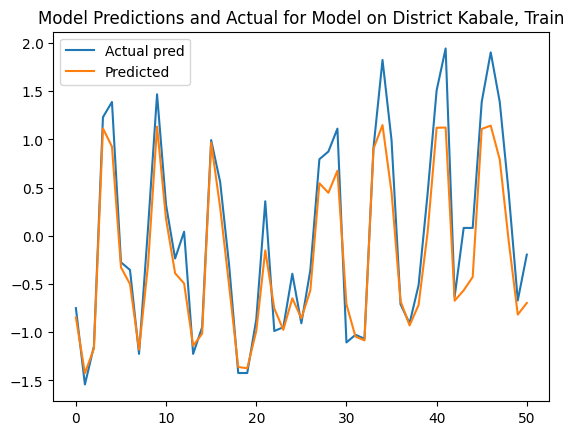

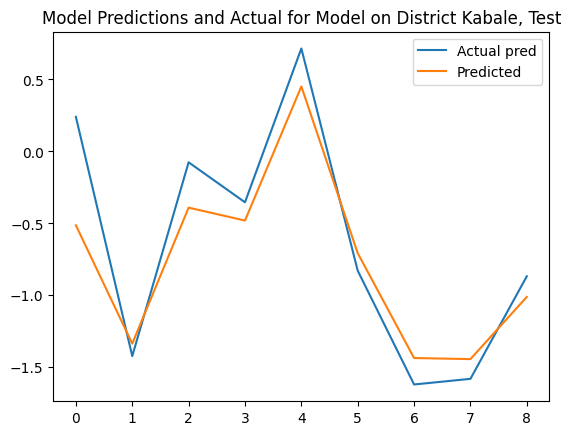

In [89]:
train_and_plot(kabale_train_dataloader, kabale_test_dataloader, kabale_dict, "Kabale")

# Observations

The Observations show that the models perform relatively well on lookback values of 3 - 7, and afterwards the model's performance starts declining. This illustrates the need of data points for an better LSTM model performance other than the usage of bigger lookback window